

# 🧪 Modeling with Duke NIfTI 3D files

After downloading TCIA data and converting it to niftii files, Or downloading minimal croped niftii version from zendoo, We can start modeling on Duke data.
```
Author: Itamar Barnea
Date: 2025-04-01
Version: 1.0
Description: Module for using ML/DL on Duke niftii data
```

In [ ]:
# Breast_MRI_590 - aligmrnt issues
* ISPY2-566011 strange maybe not good pre post..

In [194]:
from IPython.core.display import display, HTML

display(HTML("""
<style>
.container { 
    width: 100% !important;
    max-width: 100% !important;
}
</style>
"""))

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import struct
import os

In [161]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_quantile_ranges_with_uniques(arr, quantiles=10):
    """
    Visualize quantile ranges (min–max) and number of unique values in each bin.
    """
    arr = pd.Series(arr).dropna()
    q_edges = arr.quantile(np.linspace(0, 1, quantiles + 1)).drop_duplicates().values

    # Ensure full coverage
    q_edges[0] -= 1e-6
    q_edges[-1] += 1e-6

    # Bin the data
    bins = pd.cut(arr, bins=q_edges, include_lowest=True)
    grouped = arr.groupby(bins)

    # Collect data for plotting
    ranges = []
    counts = []
    labels = []

    for interval, group in grouped:
        ranges.append((interval.left, interval.right))
        counts.append(group.nunique())
        
        labels.append(f"{int(interval.left):d}–{int(interval.right):d}")

    # Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    for i, ((left, right), count) in enumerate(zip(ranges, counts)):
        ax.barh(i, right - left, left=left, height=0.6, color='skyblue', edgecolor='black')
        ax.text(right + (right - left) * 0.01, i, f"{count}", va='center', fontsize=9)

    ax.set_yticks(range(len(labels)))
    ax.set_yticklabels(labels)
    ax.set_xlabel("Value Range")
    ax.set_title("Unique Value Count per Quantile Range")
    plt.tight_layout()
    plt.show()


In [162]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt



def plot_unique_counts_by_quantile(arr, quantiles=10):
    """
    Plot number of unique values in each quantile bin of a 1D NumPy array.

    Parameters:
        arr (np.ndarray): 1D numeric array
        quantiles (int): Number of quantile bins (default: 10)
    """
    arr = pd.Series(arr).dropna()

    # Compute quantile edges and drop duplicates
    q_edges = arr.quantile(np.linspace(0, 1, quantiles + 1), interpolation='linear')
    q_edges = q_edges.drop_duplicates().values

    # Ensure inclusion of full range
    q_edges[0] -= 1e-6
    q_edges[-1] += 1e-6

    # Bin the data
    bins = pd.cut(arr, bins=q_edges, include_lowest=True)
    grouped = arr.groupby(bins)

    # Count unique values and label bins
    unique_counts = grouped.nunique()
    bin_labels = [f"{interval.left:.1f}–{interval.right:.1f}" for interval in unique_counts.index]

    # Plot
    plt.figure(figsize=(10, 5))
    plt.bar(bin_labels, unique_counts.values, color='skyblue', edgecolor='black')
    plt.xticks(rotation=45, ha='right')
    plt.ylabel("Unique Values")
    plt.title("Unique Value Count per Quantile Bin")
    plt.tight_layout()
    plt.show()

In [165]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

def plot_quantile_ranges_with_uniques_split_last(arr, quantiles=10, last_split=5):
    """
    Visualize quantile ranges with unique counts, splitting the last quantile into subquantiles.
    """
    arr = pd.Series(arr).dropna()

    # Compute main quantile edges
    base_q = np.linspace(0, 1, quantiles + 1)
    q_edges = arr.quantile(base_q).drop_duplicates().values

    # Split last quantile into subquantiles
    last_start = q_edges[-2]
    last_end = q_edges[-1]
    sub_qs = np.linspace(last_start, last_end, last_split + 1)[1:]  # exclude first to avoid overlap
    full_edges = np.concatenate((q_edges[:-1], sub_qs))

    # Ensure full coverage
    full_edges[0] -= 1e-6
    full_edges[-1] += 1e-6
    full_edges = np.unique(full_edges)

    # Bin and group
    bins = pd.cut(arr, bins=full_edges, include_lowest=True)
    grouped = arr.groupby(bins)

    # Collect data
    ranges = []
    counts = []
    labels = []

    for interval, group in grouped:
        ranges.append((interval.left, interval.right))
        counts.append(group.nunique())
        labels.append(f"{int(interval.left)}–{int(interval.right)}")

    # Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    for i, ((left, right), count) in enumerate(zip(ranges, counts)):
        ax.barh(i, right - left, left=left, height=0.6, color='skyblue', edgecolor='black')
        ax.text(right + (right - left) * 0.01, i, f"{count}", va='center', fontsize=9)

    ax.set_yticks(range(len(labels)))
    ax.set_yticklabels(labels)
    ax.set_xlabel("Value Range")
    ax.set_title("Unique Value Count per Quantile Range")
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))  # integer ticks only
    plt.tight_layout()
    plt.show()

In [166]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

def plot_quantile_ranges_with_uniques_split_last(arr, quantiles=10, last_split=5):
    """
    Visualize quantile ranges with unique counts, splitting the last quantile into subquantiles.
    Adds a dotted interpolation line connecting the top-left corners of the bars.
    """
    arr = pd.Series(arr).dropna()

    # Compute main quantile edges
    base_q = np.linspace(0, 1, quantiles + 1)
    q_edges = arr.quantile(base_q).drop_duplicates().values

    # Split last quantile into subquantiles
    last_start = q_edges[-2]
    last_end = q_edges[-1]
    sub_qs = np.linspace(last_start, last_end, last_split + 1)[1:]  # exclude first to avoid overlap
    full_edges = np.concatenate((q_edges[:-1], sub_qs))

    # Ensure full coverage
    full_edges[0] -= 1e-6
    full_edges[-1] += 1e-6
    full_edges = np.unique(full_edges)

    # Bin and group
    bins = pd.cut(arr, bins=full_edges, include_lowest=True)
    grouped = arr.groupby(bins)

    # Collect data
    ranges = []
    counts = []
    labels = []
    top_left_x = []
    top_left_y = []

    for i, (interval, group) in enumerate(grouped):
        left, right = interval.left, interval.right
        count = group.nunique()

        ranges.append((left, right))
        counts.append(count)
        labels.append(f"{int(left)}–{int(right)}")

        # Store top-left corner for interpolation line
        top_left_x.append(left)
        top_left_y.append(i + 0.3)  # top edge of the bar (height = 0.6)

    # Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    for i, ((left, right), count) in enumerate(zip(ranges, counts)):
        ax.barh(i, right - left, left=left, height=0.6, color='skyblue', edgecolor='black')
        ax.text(right + (right - left) * 0.01, i, f"{count}", va='center', fontsize=9)

    # Add dotted interpolation line
    ax.plot(top_left_x, top_left_y, linestyle='dotted', color='black', linewidth=1.5, marker='o')

    ax.set_yticks(range(len(labels)))
    ax.set_yticklabels(labels)
    ax.set_xlabel("Value Range")
    ax.set_title("Unique Value Count per Quantile Range")
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))  # integer ticks only
    plt.tight_layout()
    plt.show()

In [170]:
def plot_unique_count_width_bars(arr, quantiles=10, last_split=5):
    arr = pd.Series(arr).dropna()

    # Compute quantile edges
    base_q = np.linspace(0, 1, quantiles + 1)
    q_edges = arr.quantile(base_q).drop_duplicates().values

    # Split last quantile
    last_start = q_edges[-2]
    last_end = q_edges[-1]
    sub_qs = np.linspace(last_start, last_end, last_split + 1)[1:]
    full_edges = np.concatenate((q_edges[:-1], sub_qs))

    full_edges[0] -= 1e-6
    full_edges[-1] += 1e-6
    full_edges = np.unique(full_edges)

    # Bin and group
    bins = pd.cut(arr, bins=full_edges, include_lowest=True)
    grouped = arr.groupby(bins)

    # Collect data
    counts = []
    labels = []

    for interval, group in grouped:
        counts.append(group.nunique())
        labels.append(f"{int(interval.left)}–{int(interval.right)}")

    # Plot: width = unique count
    fig, ax = plt.subplots(figsize=(10, 6))
    for i, (count, label) in enumerate(zip(counts, labels)):
        ax.barh(i, count, height=0.6, color='skyblue', edgecolor='black')
        ax.text(count + 0.5, i, f"{count}", va='center', fontsize=9)

    ax.set_yticks(range(len(labels)))
    ax.set_yticklabels(labels)
    ax.set_xlabel("Number of Unique Values")
    ax.set_title("Unique Value Count per Quantile Bin")
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.tight_layout()
    plt.show()

In [188]:
import numpy as np
import pandas as pd

def quantiles_by_unique_values(arr, q=[0.25, 0.5, 0.75]):
    """
    Compute quantiles based on the distribution of unique values.

    Parameters:
        arr (array-like): Input data
        q (list): List of quantiles to compute (default: quartiles)

    Returns:
        dict: {quantile: value} mapping
    """
    arr = pd.Series(arr).dropna()
    unique_vals = np.sort(arr.unique())
    n = len(unique_vals)

    quantile_values = {}
    for quant in q:
        idx = int(np.floor(quant * (n - 1)))
        quantile_values[quant] = unique_vals[idx]

    return quantile_values


In [155]:
def to_rgb1(a,b,c):
    x=ds.minmax(np.stack([a,b,c], axis=len(a.shape)))
    return (x*255).astype(np.uint8)

In [156]:
def to_rgb2(a,b,c):
    x=np.stack([ds.minmax(a),ds.minmax(b),ds.minmax(c)], axis=len(a.shape))
    return (x*255).astype(np.uint8)

# Path setup

In [2]:
my_computer=True
my_colab=False
use_git_samples=False

# Root Directory where the nifti data will be places
base_path = "G:\\My Drive\\breast_mri"

In [3]:
# Check if running in Google Colab

if 'google.colab' in str(get_ipython()):
    print("Running in Google Colab")
    # Clone the repository
    !git clone https://github.com/naomifridman/BreastDCEDL.git

    # Change to the repository directory
    os.chdir('/content/BreastDCEDL')
        
    my_colab = True    
    base_path='/content/BreastDCEDL'

In [4]:
# setup directories of niftii data of I-SPY1, I-SPY2 and duke
    
nifti_path= {'spy2':os.path.join(base_path,"SPY2","vis1","dce"),
                        'spy1':os.path.join(base_path,"SPY1","vis1","dce"),
                        'duke':os.path.join(base_path,"DUKE","min_dce")}

mask_path={'spy2':os.path.join(base_path,"SPY2","vis1","mask"),
                    'spy1':os.path.join(base_path,"SPY1","vis1","mask"),
                    'duke':os.path.join(base_path,"DUKE","mask")}
        

In [5]:
import os, sys
sys.path.append(os.path.abspath(os.path.join('../', 'utils')))

import data_utils as ds

ds.setup_paths(base_path, nifti_path, mask_path)

NIfTI roots : {'spy2': 'G:\\My Drive\\breast_mri\\SPY2\\vis1\\dce', 'spy1': 'G:\\My Drive\\breast_mri\\SPY1\\vis1\\dce', 'duke': 'G:\\My Drive\\breast_mri\\DUKE\\min_dce'}
Mask  roots : {'spy2': 'G:\\My Drive\\breast_mri\\SPY2\\vis1\\mask', 'spy1': 'G:\\My Drive\\breast_mri\\SPY1\\vis1\\mask', 'duke': 'G:\\My Drive\\breast_mri\\DUKE\\mask'}


In [6]:
df = pd.read_csv('BrestDCEDL_duke_cropped.csv')

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 918 entries, 0 to 917
Data columns (total 68 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   pid                       918 non-null    object 
 1   Slice_Thickness           918 non-null    int64  
 2   Rows                      918 non-null    int64  
 3   Columns                   918 non-null    int64  
 4   FOVcm                     918 non-null    int64  
 5   Date_of_Birth_(Days)      918 non-null    int64  
 6   Menopause_(at_diagnosis)  918 non-null    int64  
 7   Race_and_Ethnicity        918 non-null    int64  
 8   ER                        918 non-null    int64  
 9   PR                        918 non-null    int64  
 10  HER2                      918 non-null    int64  
 11  Mol_Subtype               918 non-null    int64  
 12  stage_tum_s               914 non-null    float64
 13  Tumor_Grade               905 non-null    float64
 14  Nottingham

# Visualize niftii and tumor bounding box

### 

In [364]:
df.sample(3)

,pid,Slice_Thickness,Rows,Columns,FOVcm,Date_of_Birth_(Days),Menopause_(at_diagnosis),Race_and_Ethnicity,ER,PR,...,org_scol,org_ecol,org_n_z,org_n_xy,crop_mask_start,crop_mask_end,crop_sraw,crop_eraw,crop_scol,crop_ecol
229,Breast_MRI_230,5,2,2,21,-17693,0,1,1,1,...,348.0,405.0,182.0,512,93.0,125.0,206.0,461.0,248.0,503.0
168,Breast_MRI_169,18,1,1,11,-18143,0,1,1,1,...,358.0,378.0,176.0,448,70.0,86.0,78.0,333.0,191.0,446.0
417,Breast_MRI_421,5,2,2,19,-22386,1,1,1,1,...,357.0,482.0,174.0,512,59.0,93.0,197.0,452.0,255.0,510.0


In [9]:
df[df.pid=='ISPY1_1175']

,pid,Slice_Thickness,Rows,Columns,FOVcm,Date_of_Birth_(Days),Menopause_(at_diagnosis),Race_and_Ethnicity,ER,PR,...,org_scol,org_ecol,org_n_z,org_n_xy,crop_mask_start,crop_mask_end,crop_sraw,crop_eraw,crop_scol,crop_ecol


# duke

In [365]:

r=df.iloc[229]
pid=r['pid']
print(pid)
a0=ds.get_nifti_acquisition(pid, idx=0)
a1=ds.get_nifti_acquisition(pid, idx=1)
a2=ds.get_nifti_acquisition(pid, idx=r['post_late']) # last acqisition

Breast_MRI_230


In [366]:
ds.nifti_path

{'spy2': 'G:\\My Drive\\breast_mri\\SPY2\\vis1\\dce',
 'spy1': 'G:\\My Drive\\breast_mri\\SPY1\\vis1\\dce',
 'duke': 'G:\\My Drive\\breast_mri\\DUKE\\min_dce'}

In [368]:
a=ds.get_all_nifti_acquisitions(pid,'G:\\My Drive\\breast_mri\\DUKE\\min_dce\\')

a0=a[0]
a1=a[1]
a2=a[-1]
aa=np.array(a)
len(a),a[0].shape

(3, (33, 256, 256))

In [369]:
startm=int(r['mask_start'])
endm=int(r['mask_end'])
        
sraw=int(r['sraw'])
eraw=int(r['eraw'])

scol=int(r['scol'])
ecol=int(r['ecol'])
startm,endm,sraw,eraw,scol,ecol,a0.shape

(2, 30, 88, 169, 100, 157, (33, 256, 256))

In [370]:
# create binary mask from bounding box
m = np.zeros(a0.shape)
m[startm:endm,sraw:eraw,scol:ecol]=1
m.shape

(33, 256, 256)

In [371]:
x=to_rgb1(a[0],a[1],a[2])
x.shape,pid

((33, 256, 256, 3), 'Breast_MRI_230')

In [372]:
for i in range(10):
    
    print(1*(i+1)/10.,np.quantile(a[0],1*(i+1)/10.),len(np.unique(a0[a0<=np.quantile(a[0],1*(i+1)/10.)])))
np.median(a0)

0.1 0.0 1
0.2 3.0 4
0.3 14.0 15
0.4 33.0 34
0.5 70.0 71
0.6 114.0 115
0.7 159.0 160
0.8 218.0 219
0.9 389.0 390
1.0 2568.0 1588


70.0

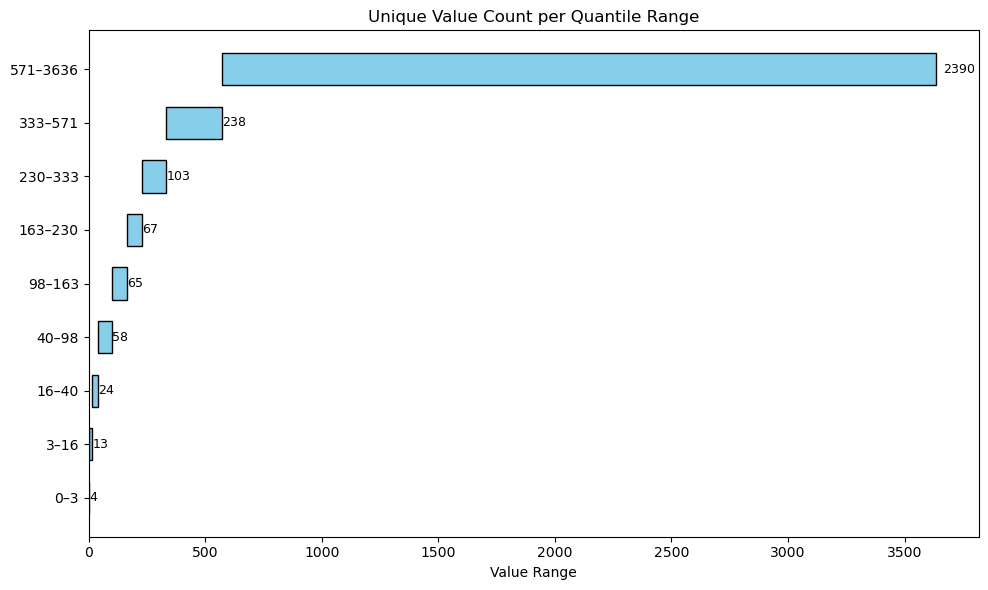

In [373]:

plot_quantile_ranges_with_uniques(aa.flatten())


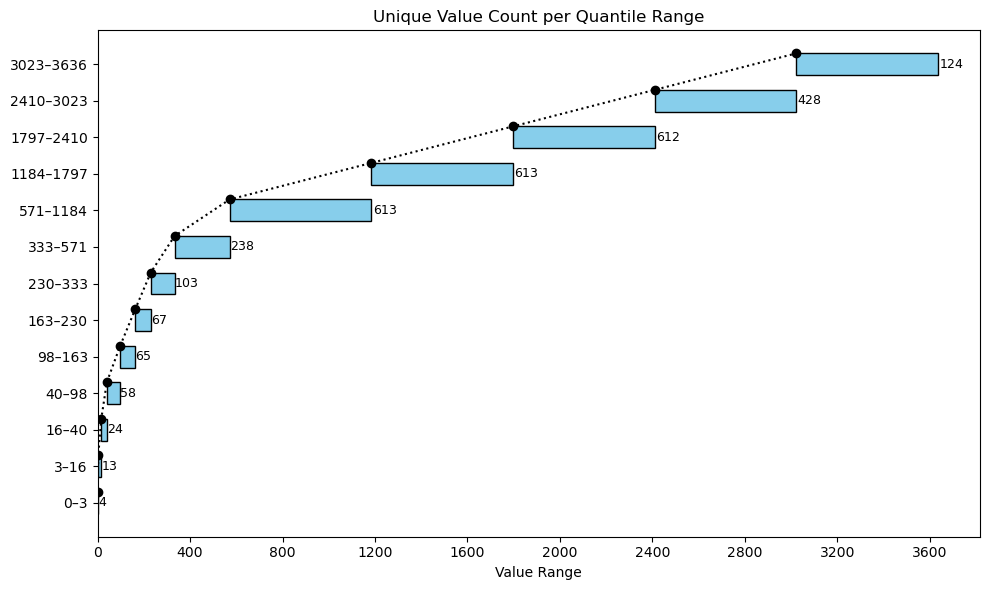

In [374]:

plot_quantile_ranges_with_uniques_split_last(aa.flatten())


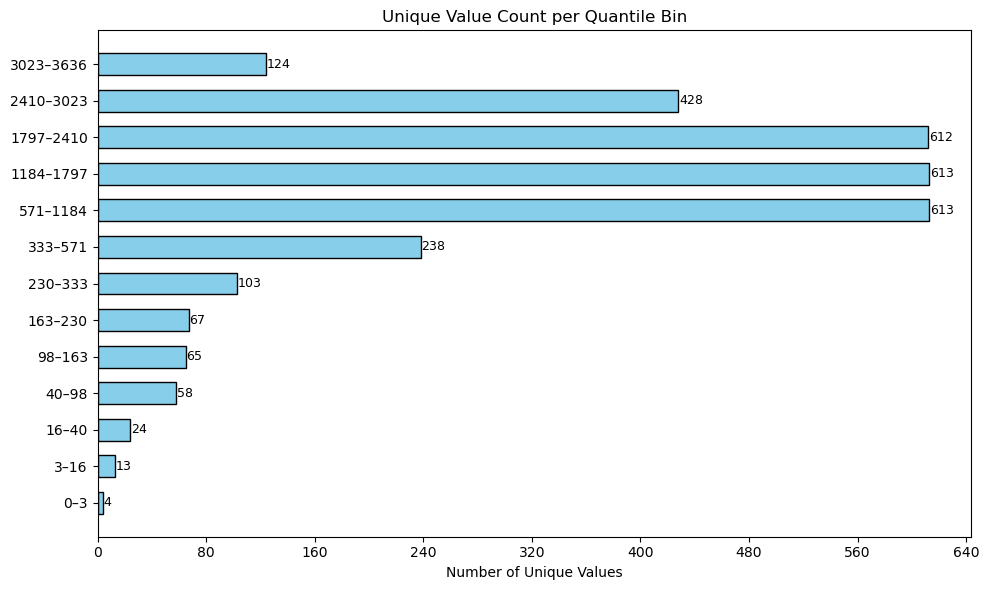

In [375]:

plot_unique_count_width_bars(aa.flatten())


In [376]:
aa=np.array(a)
for i in range(10):
    
    print(1*(i+1)/10.,np.quantile(aa,1*(i+1)/10.),len(np.unique(aa[aa<=np.quantile(aa,1*(i+1)/10.)])))
np.median(aa)

0.1 0.0 1
0.2 3.0 4
0.3 16.0 17
0.4 40.0 41
0.5 98.0 99
0.6 163.0 164
0.7 230.0 231
0.8 333.0 334
0.9 571.0 572
1.0 3636.0 2962


98.0

In [ ]:
x = n4_bias_correction_3d_slicewise(aa)

In [397]:
xx=x.astype(int)

In [398]:
b0 = a0-np.median(aa)
b0 = b0.clip(0,b0.max())
b1 = a1-np.median(aa)
b1 = b1.clip(0,b1.max())
b2 = a2-np.median(aa)
b2 = b2.clip(0,b2.max())

In [399]:
def print_info(im):
    for m in im:
        print(m.shape,m.min(),m.max(),m.mean(),m.std(),' n ini ',len(set(m.flatten())), ' >0', len(m[m>0]))

In [400]:
bb=aa-np.median(aa)
bb=bb.clip(0,bb.max())

In [404]:
idx=[startm+1, (startm+endm)//2,endm-1]
k=(startm+endm)//2

print_info([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])
print_info([a0[k],b0[k],aa,bb,xx,to_uint8(aa),to_uint8(bb),to_uint8(xx)])

(256, 256, 3) 0 254 14.333663940429688 20.405449929860065  n ini  207  >0 141321
(256, 256, 3) 0 254 14.931900024414062 21.840868695560708  n ini  214  >0 144211
(256, 256, 3) 0 254 19.041422526041668 25.927586648683434  n ini  234  >0 141144
(256, 256, 3) 0 254 10.444625854492188 19.10981458669847  n ini  204  >0 94599
(256, 256, 3) 0 254 10.870885213216146 20.54769329371236  n ini  212  >0 89746
(256, 256, 3) 0 254 14.296574910481771 24.40058711586342  n ini  233  >0 98329
(256, 256) 0.0 1349.0 139.76132202148438 210.97292637259667  n ini  1195  >0 54807
(256, 256) 0.0 1251.0 85.34419250488281 187.9668831997674  n ini  1097  >0 25842
(3, 33, 256, 256) 0.0 3636.0 201.78226879389598 278.3216073864362  n ini  2962  >0 5415314
(3, 33, 256, 256) 0.0 3538.0 142.53306779957782 254.10941548681257  n ini  2864  >0 3235394
(3, 33, 256, 256) 0 2939 196.87240800953876 243.1143008914767  n ini  2349  >0 5352688
(3, 33, 256, 256) 0 254 13.745598841195156 19.453275822978327  n ini  246  >0 4611633


In [405]:
print_info([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])

(256, 256, 3) 0 254 14.333663940429688 20.405449929860065  n ini  207  >0 141321
(256, 256, 3) 0 254 14.931900024414062 21.840868695560708  n ini  214  >0 144211
(256, 256, 3) 0 254 19.041422526041668 25.927586648683434  n ini  234  >0 141144
(256, 256, 3) 0 254 10.444625854492188 19.10981458669847  n ini  204  >0 94599
(256, 256, 3) 0 254 10.870885213216146 20.54769329371236  n ini  212  >0 89746
(256, 256, 3) 0 254 14.296574910481771 24.40058711586342  n ini  233  >0 98329


In [406]:
print_info([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])

(256, 256, 3) 0 254 14.333663940429688 20.405449929860065  n ini  207  >0 141321
(256, 256, 3) 0 254 14.931900024414062 21.840868695560708  n ini  214  >0 144211
(256, 256, 3) 0 254 19.041422526041668 25.927586648683434  n ini  234  >0 141144
(256, 256, 3) 0 254 10.444625854492188 19.10981458669847  n ini  204  >0 94599
(256, 256, 3) 0 254 10.870885213216146 20.54769329371236  n ini  212  >0 89746
(256, 256, 3) 0 254 14.296574910481771 24.40058711586342  n ini  233  >0 98329


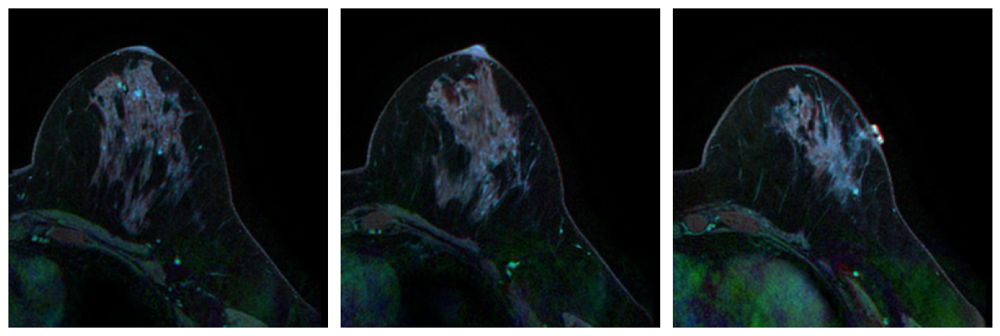

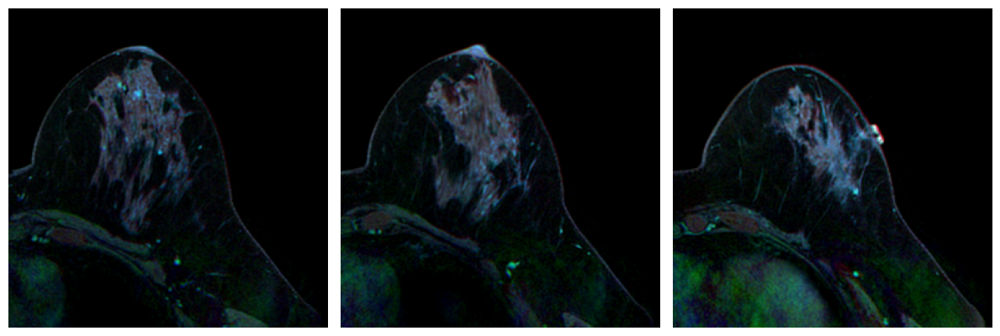

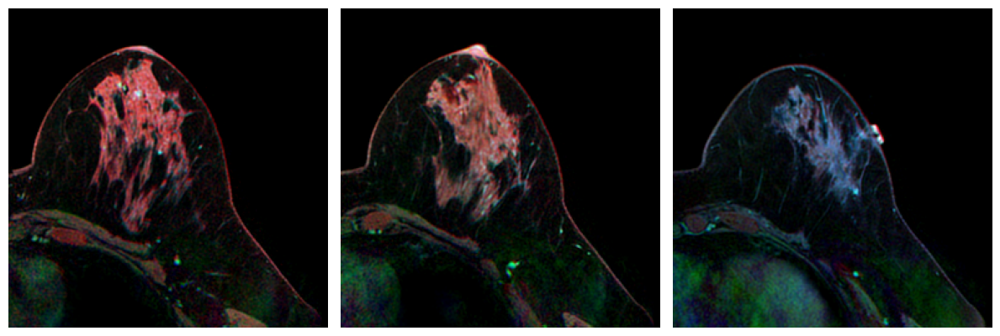

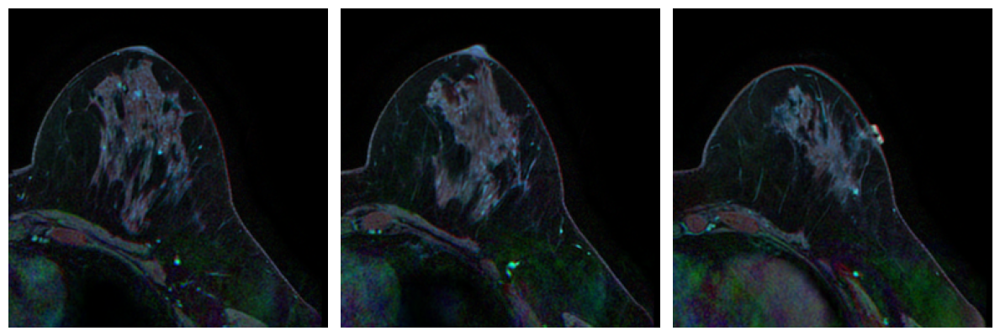

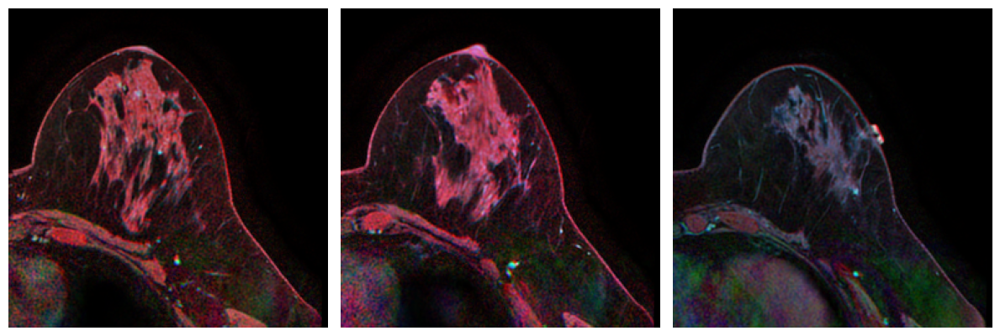

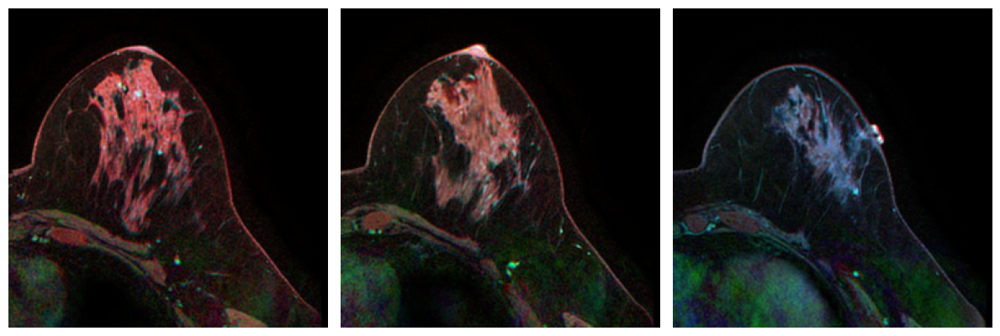

In [408]:
idx=[startm+1, (startm+endm)//2,endm-1]
k=(startm+endm)//2

ds.show_n_images([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])#, axis_off=False)
ds.show_n_images([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])#, axis_off=False)


ds.show_n_images([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])
ds.show_n_images([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])

In [214]:
quantiles_by_unique_values(aa.flatten(), q=[0.05, 0.5, 0.9]),np.median(aa)

({0.05: 202.0, 0.5: 2021.0, 0.9: 3642.0}, 66.0)

In [228]:
b0 = a0-202
b0 = b0.clip(0,b0.max())
b1 = a1-202
b1 = b1.clip(0,b1.max())
b2 = a2-202
b2 = b2.clip(0,b2.max())

In [229]:
bb=aa-202
bb=bb.clip(0,bb.max())

In [230]:
print_info([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])
print_info([a0[k],b0[k],aa,bb])

(256, 256, 3) 0 254 13.721481323242188 23.583528543923375  n ini  238  >0 108412
(256, 256, 3) 0 254 12.863306681315104 20.09574901450253  n ini  197  >0 124265
(256, 256, 3) 0 254 20.815653483072918 27.98985783904552  n ini  232  >0 137118
(256, 256, 3) 0 254 9.199813842773438 21.09878307445319  n ini  235  >0 68934
(256, 256, 3) 0 254 7.9238942464192705 17.776584289540526  n ini  195  >0 72394
(256, 256, 3) 0 254 14.091598510742188 25.123881240398443  n ini  229  >0 88045
(256, 256) 0.0 2221.0 187.21136474609375 262.2335958137905  n ini  1480  >0 52134
(256, 256) 0.0 2019.0 91.43659973144531 203.29097525541687  n ini  1278  >0 22516
(3, 46, 256, 256) 0.0 4943.0 267.2790772811226 397.2735267370111  n ini  4044  >0 7043572
(3, 46, 256, 256) 0.0 4741.0 168.03035006315812 338.7185892827843  n ini  3842  >0 3690644


In [231]:
print_info([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])

(256, 256, 3) 0 254 14.661092122395834 24.73353803849481  n ini  245  >0 109266
(256, 256, 3) 0 254 16.864908854166668 25.73960710969797  n ini  227  >0 127930
(256, 256, 3) 0 254 24.615692138671875 32.24389389283915  n ini  247  >0 139389
(256, 256, 3) 0 254 9.792648315429688 22.05183383571905  n ini  242  >0 69076
(256, 256, 3) 0 254 10.216466267903646 22.46196265913484  n ini  225  >0 73198
(256, 256, 3) 0 254 16.633514404296875 28.825021820800075  n ini  243  >0 88327


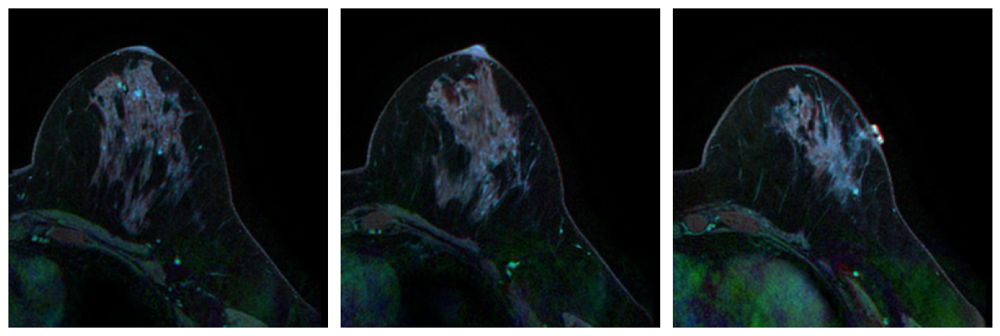

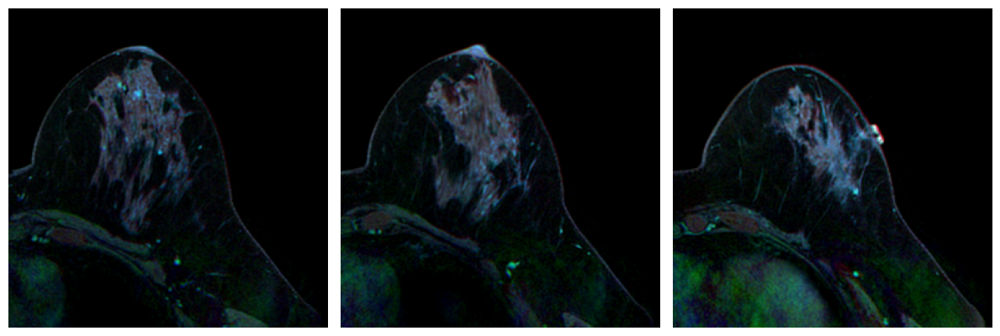

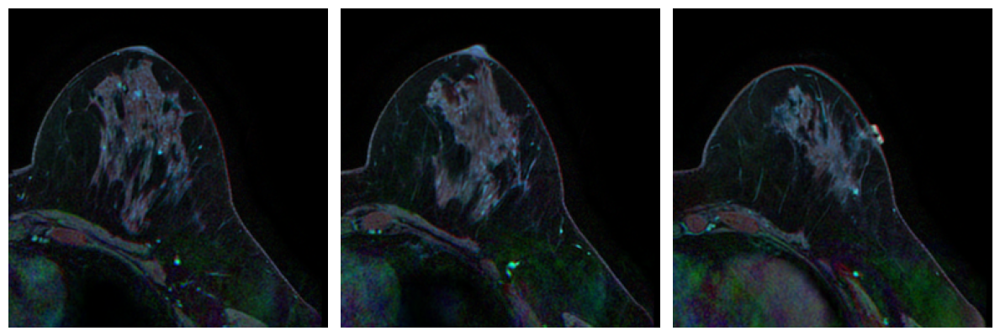

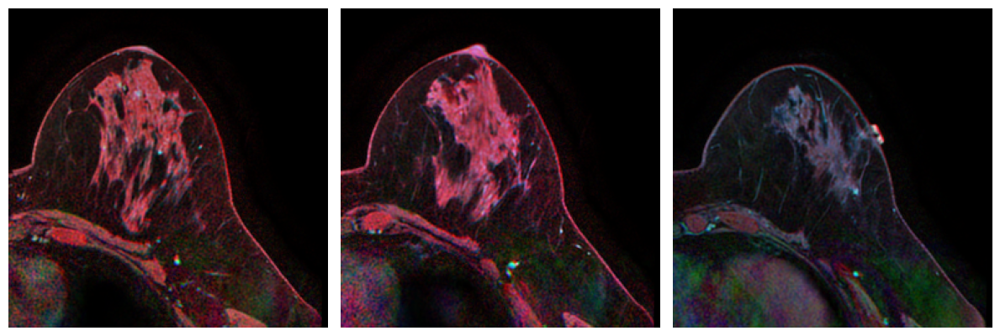

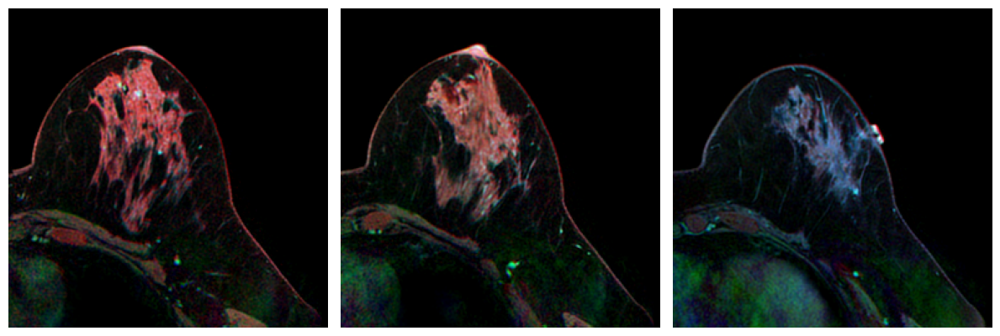

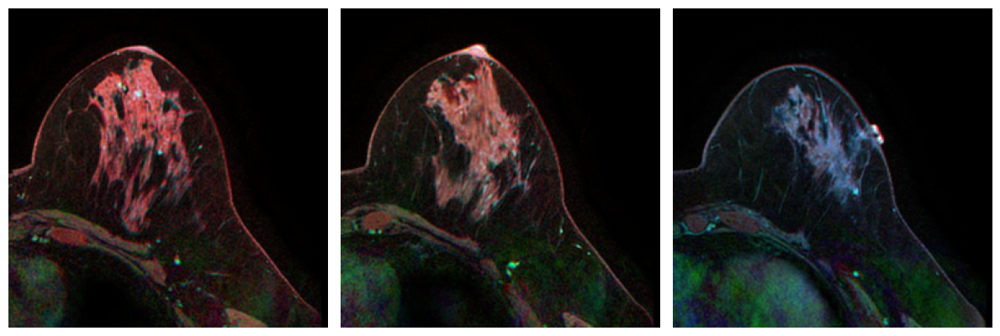

In [409]:
idx=[startm+1, (startm+endm)//2,endm-1]
k=(startm+endm)//2

ds.show_n_images([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
ds.show_n_images([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])
ds.show_n_images([to_rgb1(xx[0][k],xx[1][k],xx[2][k]) for k in idx])
ds.show_n_images([to_rgb2(xx[0][k],xx[1][k],xx[2][k]) for k in idx])
ds.show_n_images([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])
ds.show_n_images([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])

# spy2

In [410]:
dd=pd.read_csv('../BreastDCEDL_metadata_crop.csv')
dd[dd.dataset=='spy2'].sample(3)

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
1835,ISPY2-658541,0.0,256.0,80.0,7.0,0.0,2.0,6.0,2.0,0.664100,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,spy2,1.0
1424,ISPY2-168044,0.0,256.0,64.0,7.0,0.0,2.0,5.0,2.5,0.625000,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,spy2,1.0
2034,ISPY2-934459,0.0,256.0,160.0,7.0,0.0,2.0,5.0,1.0,1.367188,...,1.0,0.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy2,0.0


In [411]:

r=dd.iloc[1835]
pid=r['pid']
print(pid)
a0=ds.get_nifti_acquisition(pid, idx=0)
a1=ds.get_nifti_acquisition(pid, idx=1)
a2=ds.get_nifti_acquisition(pid, idx=r['post_late']) # last acqisition

ISPY2-658541


In [412]:
ds.nifti_path

{'spy2': 'G:\\My Drive\\breast_mri\\SPY2\\vis1\\dce',
 'spy1': 'G:\\My Drive\\breast_mri\\SPY1\\vis1\\dce',
 'duke': 'G:\\My Drive\\breast_mri\\DUKE\\min_dce'}

In [413]:
a=ds.get_all_nifti_acquisitions(pid)#,'G:\\My Drive\\breast_mri\\DUKE\\dce\\')

a0=a[0]
a1=a[int(r['post_early'])]
a2=a[int(r['post_late'])]
aa=np.array(a)
len(a),a[0].shape

(7, (80, 256, 256))

In [414]:
def n4_bias_correction_3d_slicewise(np_volume, shrink_factor=2):
    """
    Apply N4 bias correction to a 3D NumPy volume slice-by-slice (along axis 0).
    """
    corrected_slices = []

    for i in range(np_volume.shape[0]):
        slice_2d = np_volume[i, :, :].astype(np.float32)
        image = sitk.GetImageFromArray(slice_2d)

        # Create mask using Otsu
        mask = sitk.OtsuThreshold(image, 0, 1, 200)

        # Use 3D shrink vector even for 2D slices
        shrink_vec = sitk.VectorUInt32([1, shrink_factor, shrink_factor])
        image_shrunk = sitk.Shrink(image, shrink_vec)
        mask_shrunk = sitk.Shrink(mask, shrink_vec)

        # Apply N4
        corrector = sitk.N4BiasFieldCorrectionImageFilter()
        corrector.Execute(image_shrunk, mask_shrunk)

        # Get full-res bias field and correct
        log_bias = corrector.GetLogBiasFieldAsImage(image)
        bias_field = sitk.Exp(log_bias)
        corrected = sitk.Divide(image, bias_field)

        # Convert back to NumPy
        corrected_np = sitk.GetArrayFromImage(corrected)
        corrected_slices.append(corrected_np)

    return np.stack(corrected_slices)



In [474]:
x = n4_bias_correction_3d_slicewise(aa)

In [475]:
x.shape,x.dtype

((7, 80, 256, 256), dtype('float32'))

In [476]:
startm=int(r['mask_start'])
endm=int(r['mask_end'])
        
sraw=int(r['sraw'])
eraw=int(r['eraw'])

scol=int(r['scol'])
ecol=int(r['ecol'])
startm,endm,sraw,eraw,scol,ecol,a0.shape

(20, 45, 126, 191, 92, 144, (80, 256, 256))

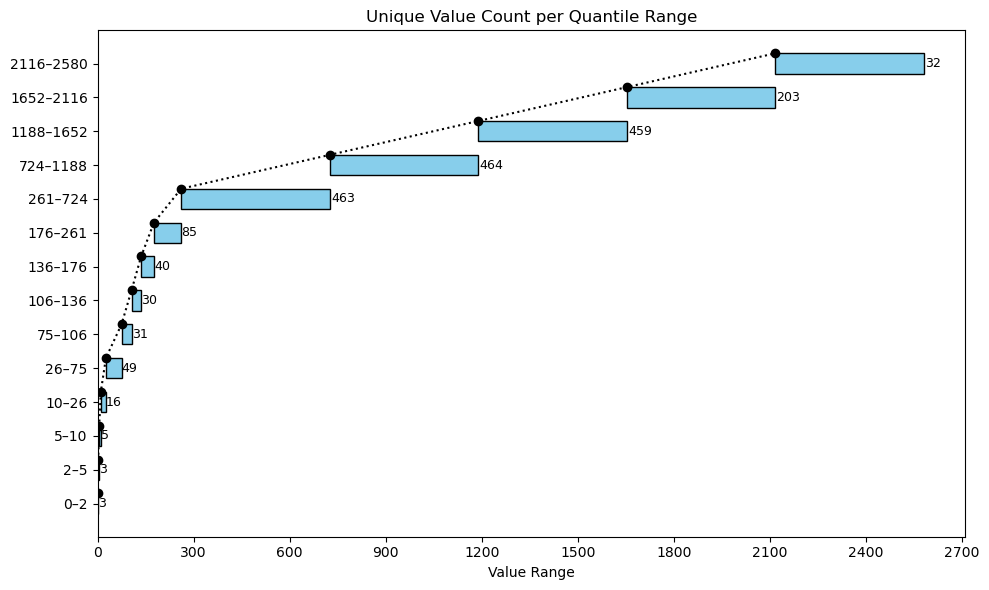

In [477]:
plot_quantile_ranges_with_uniques_split_last(aa.flatten())


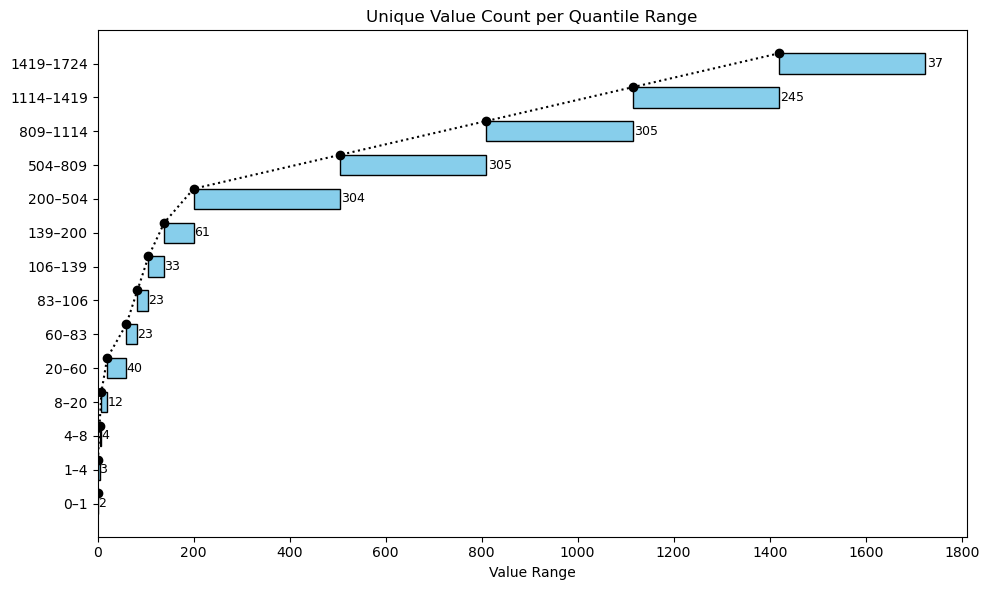

In [478]:
plot_quantile_ranges_with_uniques_split_last(x.flatten().astype(int))


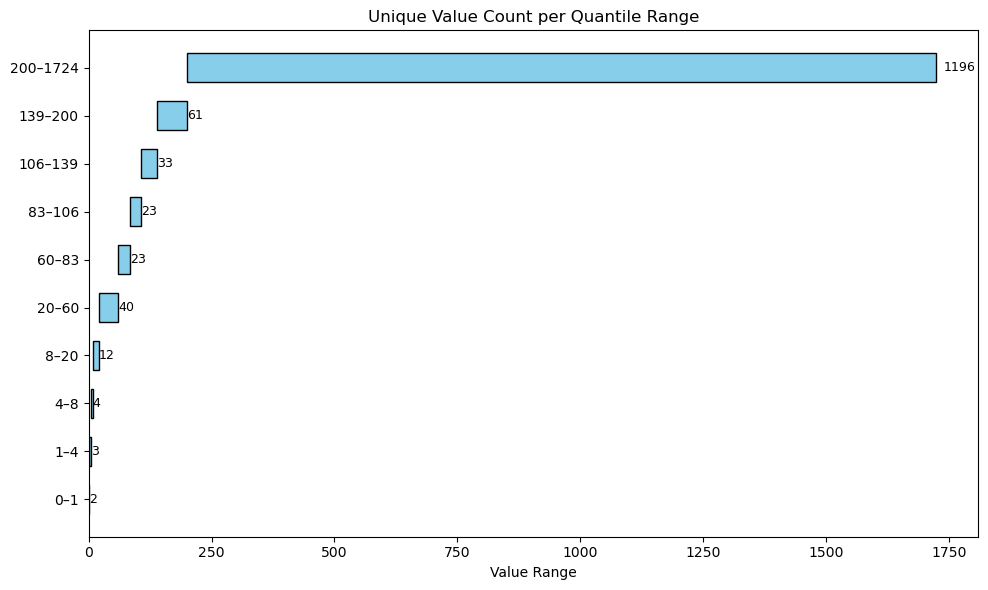

In [479]:


plot_quantile_ranges_with_uniques(x.flatten().astype(int))


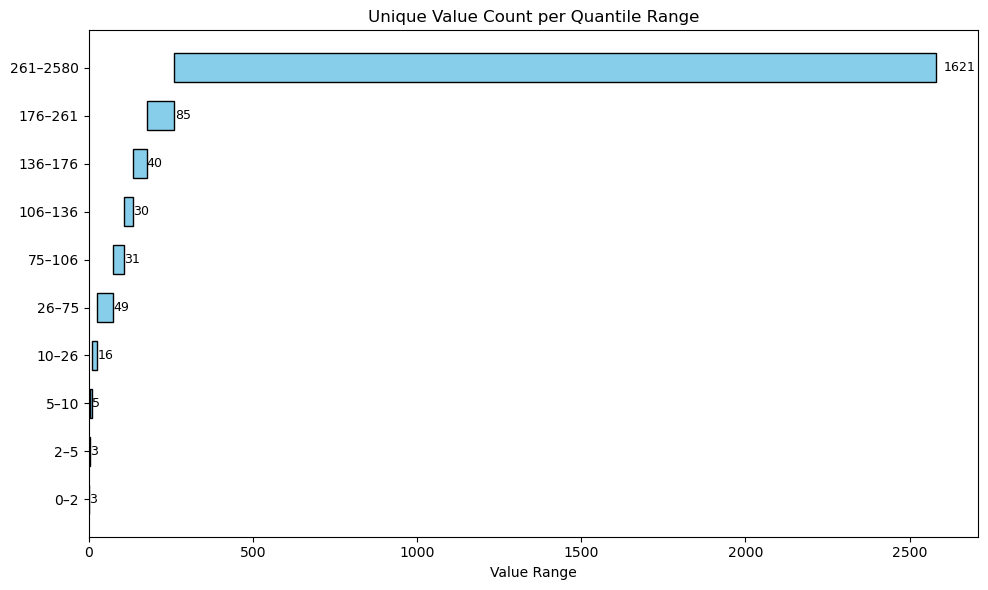

In [480]:


plot_quantile_ranges_with_uniques(aa.flatten())


In [481]:
aa=np.array(a)
for i in range(10):
    
    print(1*(i+1)/10.,np.quantile(aa,1*(i+1)/10.),len(np.unique(aa[aa<=np.quantile(aa,1*(i+1)/10.)])))
np.median(aa)

0.1 2.0 3
0.2 5.0 6
0.3 10.0 11
0.4 26.0 27
0.5 75.0 76
0.6 106.0 107
0.7 136.0 137
0.8 176.0 177
0.9 261.0 262
1.0 2580.0 1883


75.0

In [482]:
xx=x.astype(int)
for i in range(10):
    
    print(1*(i+1)/10.,np.quantile(xx,1*(i+1)/10.),len(np.unique(xx[xx<=np.quantile(xx,1*(i+1)/10.)])))
np.median(xx)

0.1 1.0 2
0.2 4.0 5
0.3 8.0 9
0.4 20.0 21
0.5 60.0 61
0.6 83.0 84
0.7 106.0 107
0.8 139.0 140
0.9 200.0 201
1.0 1724.0 1397


60.0

In [483]:
b0 = a0-np.median(aa)
b0 = b0.clip(0,b0.max())
b1 = a1-np.median(aa)
b1 = b1.clip(0,b1.max())
b2 = a2-np.median(aa)
b2 = b2.clip(0,b2.max())
yy=xx-np.median(xx)
yy=yy.clip(0,yy.max())

In [484]:
bb=aa-np.median(aa)
bb=bb.clip(0,bb.max())

In [485]:
idx=[startm+1, (startm+endm)//2,endm-1]
k=(startm+endm)//2
print_info([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])
print_info([a0[k],b0[k],aa,bb])

(256, 256, 3) 0 254 20.519805908203125 23.291321585363015  n ini  196  >0 166124
(256, 256, 3) 0 254 16.24109395345052 19.3091640326771  n ini  200  >0 159301
(256, 256, 3) 0 254 14.44390869140625 18.187725601464376  n ini  191  >0 154758
(256, 256, 3) 0 254 12.097885131835938 20.964958285546444  n ini  194  >0 105544
(256, 256, 3) 0 254 10.139760335286459 17.72764069801595  n ini  196  >0 107681
(256, 256, 3) 0 254 8.698664347330729 16.486408279712744  n ini  189  >0 101898
(256, 256) 0.0 743.0 86.53944396972656 90.90173114914552  n ini  643  >0 62210
(256, 256) 0.0 668.0 38.21720886230469 72.55489770530939  n ini  568  >0 30098
(7, 80, 256, 256) 0.0 2580.0 108.07983417510987 136.2575920974214  n ini  1883  >0 34327187
(7, 80, 256, 256) 0.0 2505.0 62.653620093209405 117.39418737737707  n ini  1808  >0 18334549


In [486]:
print_info([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])

(256, 256, 3) 0 254 27.77685038248698 30.25332469959936  n ini  253  >0 174611
(256, 256, 3) 0 254 23.238291422526043 26.378591866907776  n ini  244  >0 168571
(256, 256, 3) 0 254 25.352747599283855 29.760947803436448  n ini  250  >0 165820
(256, 256, 3) 0 254 16.095596313476562 27.427899002539046  n ini  250  >0 106792
(256, 256, 3) 0 254 13.882436116536459 23.669054363503236  n ini  242  >0 109718
(256, 256, 3) 0 254 14.497665405273438 25.73834507240012  n ini  251  >0 104428


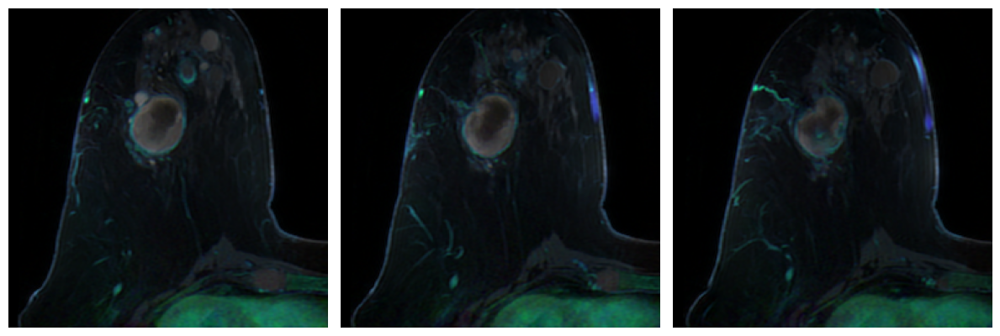

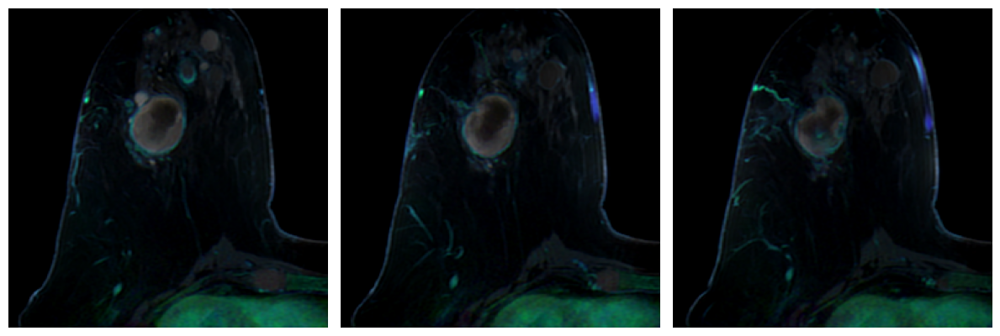

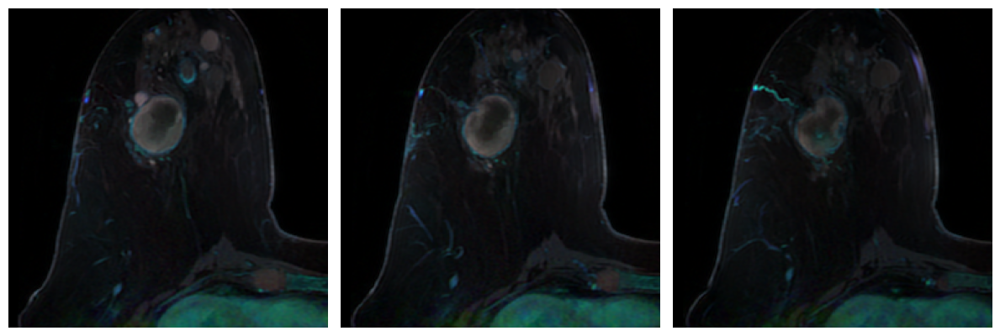

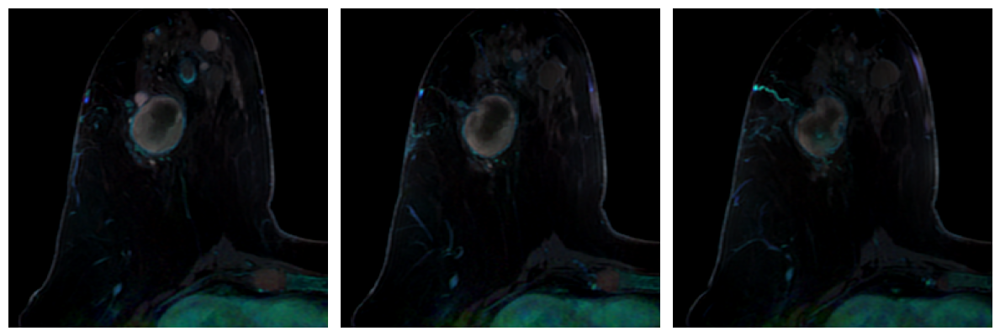

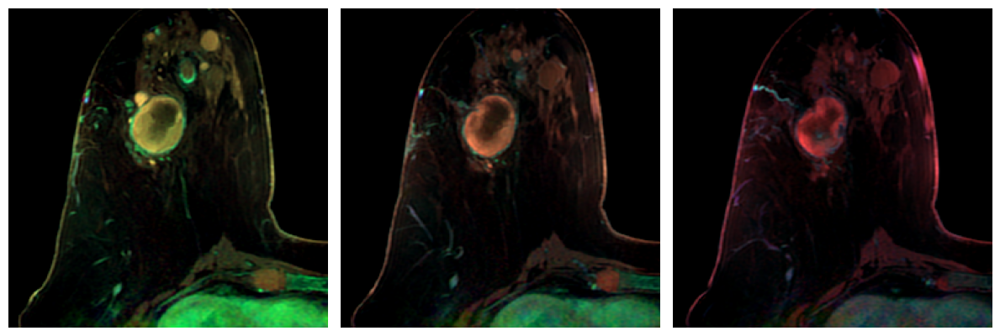

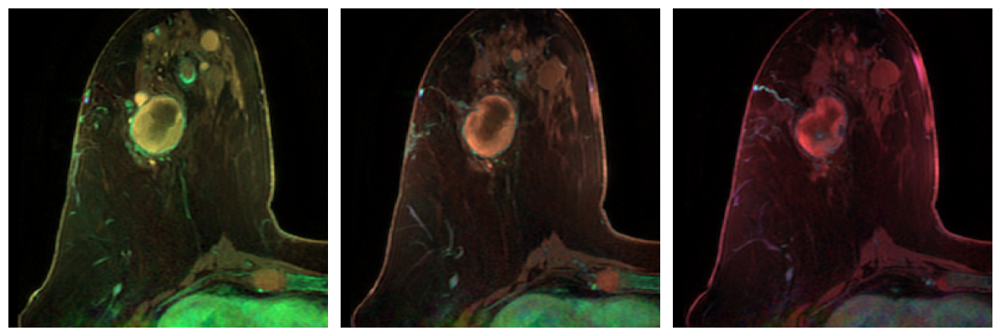

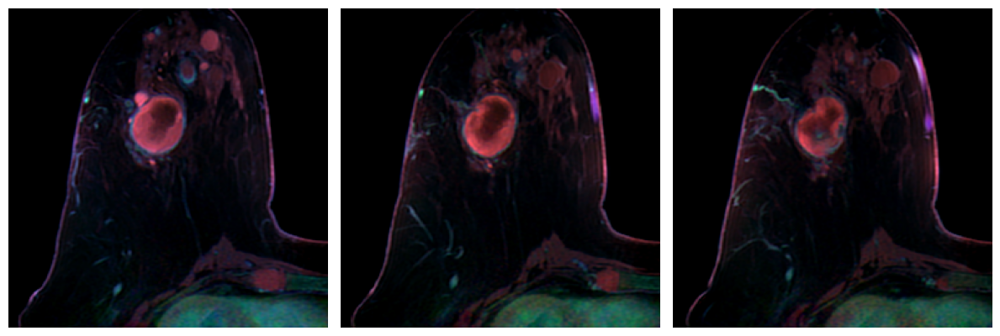

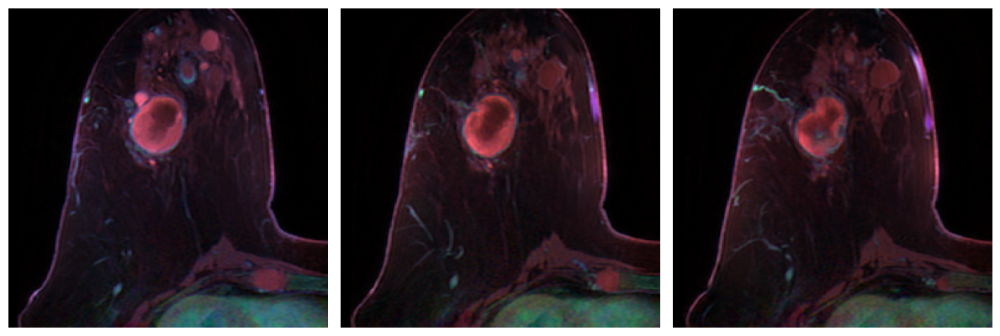

In [487]:
k=(startm+endm)//2
idx=[k-2, k,k+2]

ds.show_n_images([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
ds.show_n_images([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])
ds.show_n_images([to_rgb1(xx[0][k],xx[1][k],xx[2][k]) for k in idx])
ds.show_n_images([to_rgb1(yy[0][k],yy[1][k],yy[2][k]) for k in idx])

ds.show_n_images([to_rgb2(yy[0][k],yy[1][k],yy[2][k]) for k in idx])
ds.show_n_images([to_rgb2(xx[0][k],xx[1][k],xx[2][k]) for k in idx])
ds.show_n_images([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])
ds.show_n_images([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])

In [460]:
quantiles_by_unique_values(aa.flatten(), q=[0.05, 0.5, 0.9])
q0=75

In [461]:
np.median(aa),np.quantile(aa,0.9),q0

(75.0, 261.0, 75)

In [462]:
b0 = a0-q0
b0 = b0.clip(0,b0.max())
b1 = a1-q0
b1 = b1.clip(0,b1.max())
b2 = a2-q0
b2 = b2.clip(0,b2.max())

In [463]:
bb=aa-q0
bb=bb.clip(0,bb.max())

In [469]:
def to_uint8(imm):
    im = ds.minmax(imm.copy())
    im  = (im*255).astype(np.uint8)
    return im

In [470]:

print_info([a0[k],b0[k],aa,bb, to_uint8(aa), to_uint8(bb),to_uint8(xx),to_uint8(yy)])

(256, 256) 0.0 743.0 86.53944396972656 90.90173114914552  n ini  643  >0 62210
(256, 256) 0.0 668.0 38.21720886230469 72.55489770530939  n ini  568  >0 30098
(7, 80, 256, 256) 0.0 2580.0 108.07983417510987 136.2575920974214  n ini  1883  >0 34327187
(7, 80, 256, 256) 0.0 2505.0 62.653620093209405 117.39418737737707  n ini  1808  >0 18334549
(7, 80, 256, 256) 0 254 10.225952311924525 13.4331564637449  n ini  230  >0 25489714
(7, 80, 256, 256) 0 254 6.130149732317244 11.818092296561018  n ini  229  >0 17348322
(7, 80, 256, 256) 0 254 11.583585521153042 14.104601033493624  n ini  234  >0 26482324
(7, 80, 256, 256) 0 254 6.679736001150949 12.011813178148264  n ini  232  >0 17430130


In [471]:
print_info([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])
print_info([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])

(256, 256, 3) 0 254 24.636260986328125 27.459451414879084  n ini  243  >0 167759
(256, 256, 3) 0 254 23.238291422526043 26.378591866907776  n ini  244  >0 168571
(256, 256, 3) 0 254 22.012680053710938 25.28081939429896  n ini  246  >0 166347
(256, 256, 3) 0 254 14.976460774739584 25.025745111751693  n ini  242  >0 112257
(256, 256, 3) 0 254 13.882436116536459 23.669054363503236  n ini  242  >0 109718
(256, 256, 3) 0 254 13.202763875325521 22.42519527287741  n ini  240  >0 107230


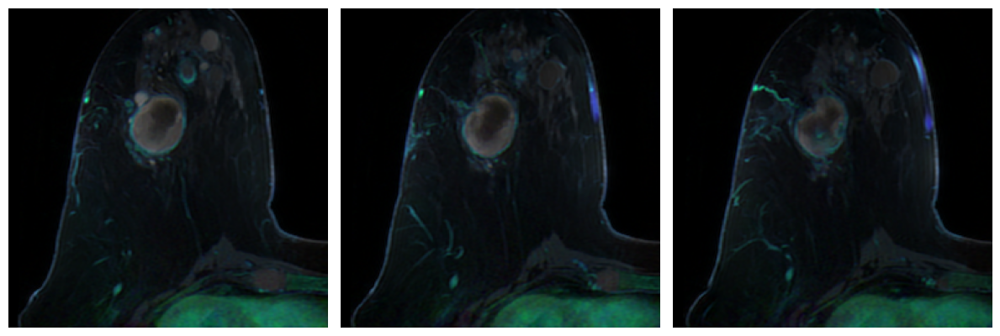

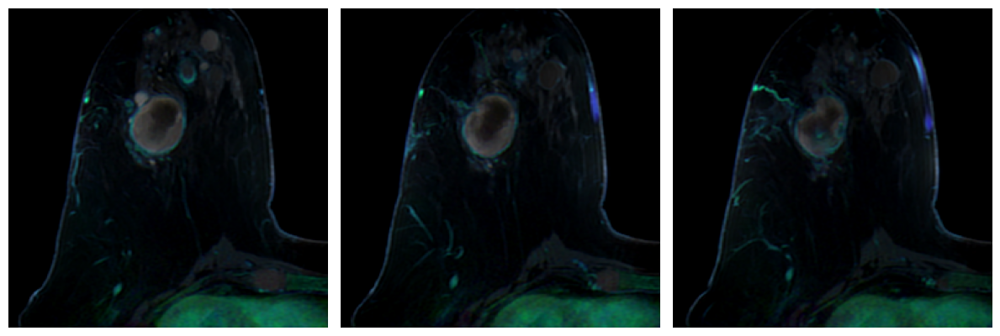

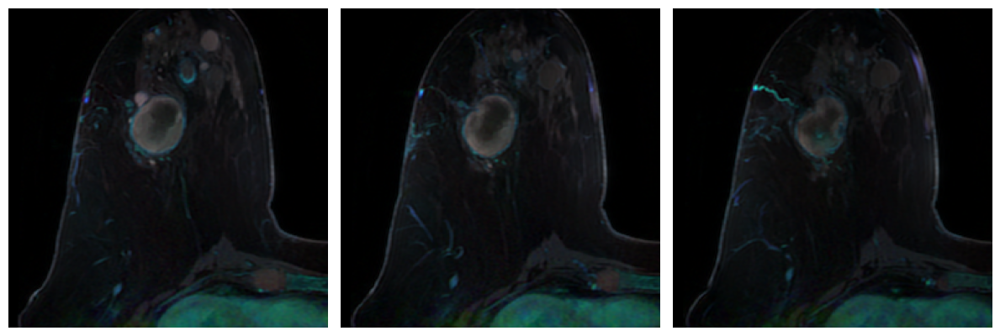

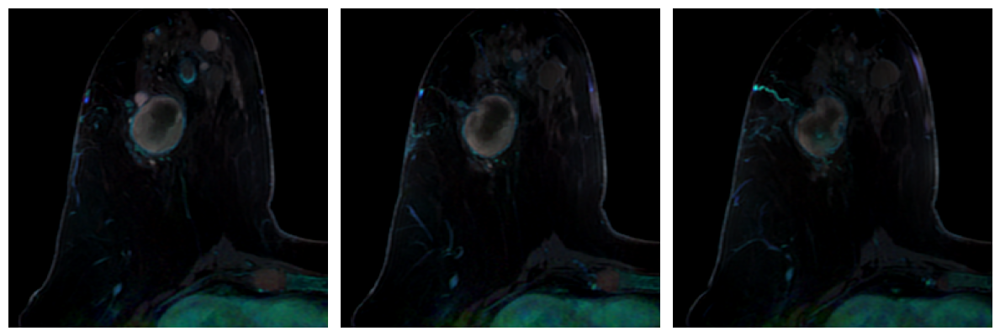

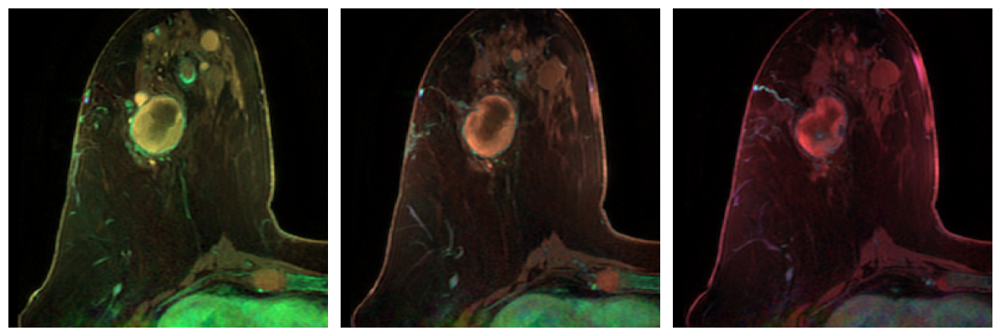

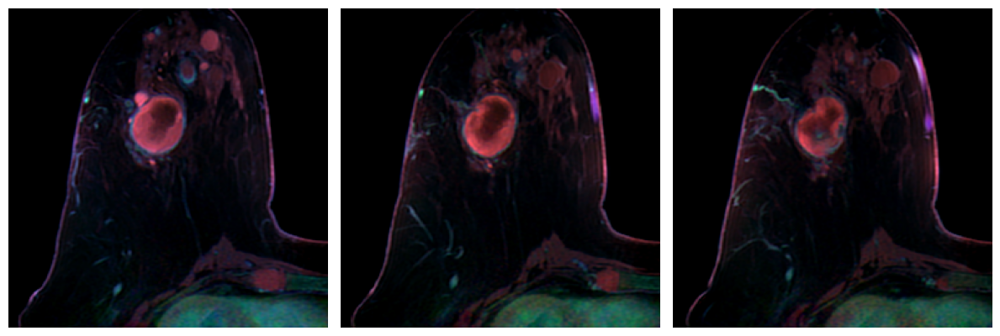

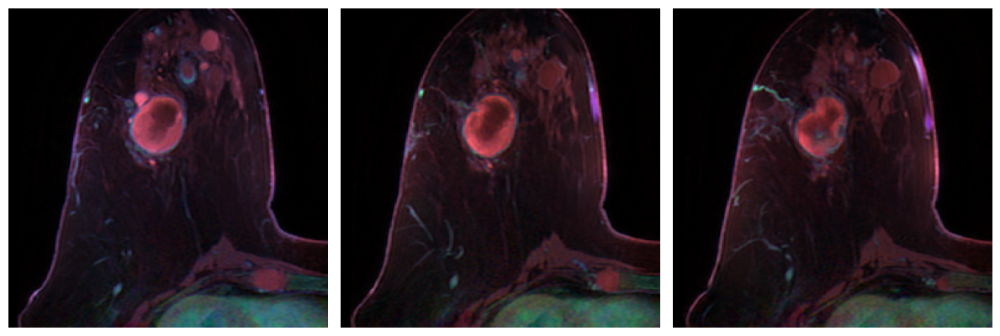

In [472]:
k=(startm+endm)//2
idx=[k-2, k,k+2]
ds.show_n_images([to_rgb1(a0[k],a1[k],a2[k]) for k in idx])
ds.show_n_images([to_rgb1(b0[k],b1[k],b2[k]) for k in idx])
ds.show_n_images([to_rgb1(xx[0][k],xx[1][k],xx[2][k]) for k in idx])
ds.show_n_images([to_rgb1(yy[0][k],yy[1][k],yy[2][k]) for k in idx])
ds.show_n_images([to_rgb2(xx[0][k],xx[1][k],xx[2][k]) for k in idx])
ds.show_n_images([to_rgb2(b0[k],b1[k],b2[k]) for k in idx])

ds.show_n_images([to_rgb2(a0[k],a1[k],a2[k]) for k in idx])

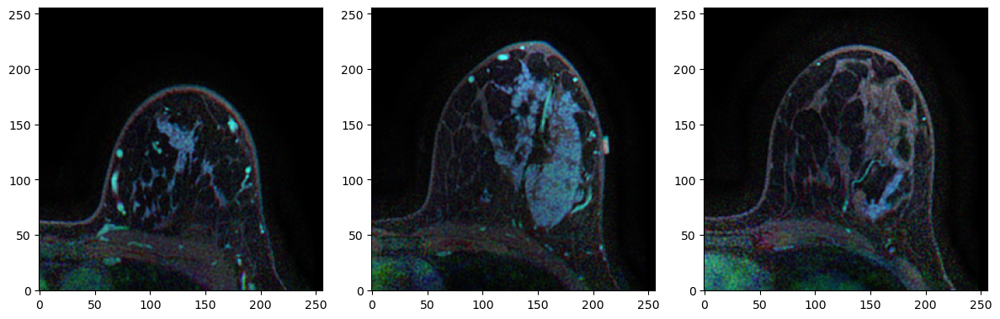

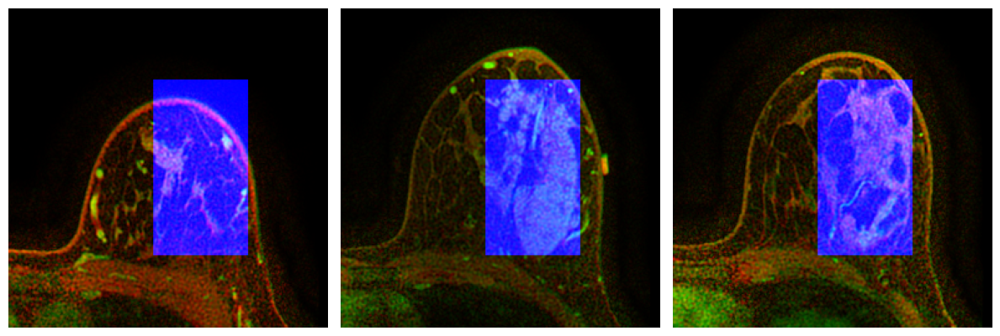

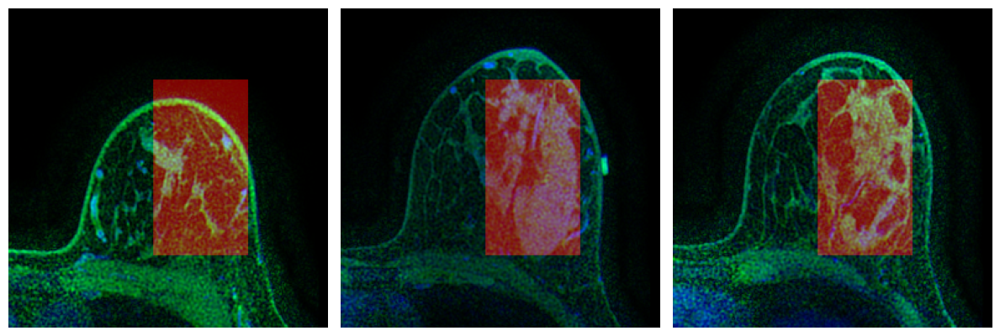

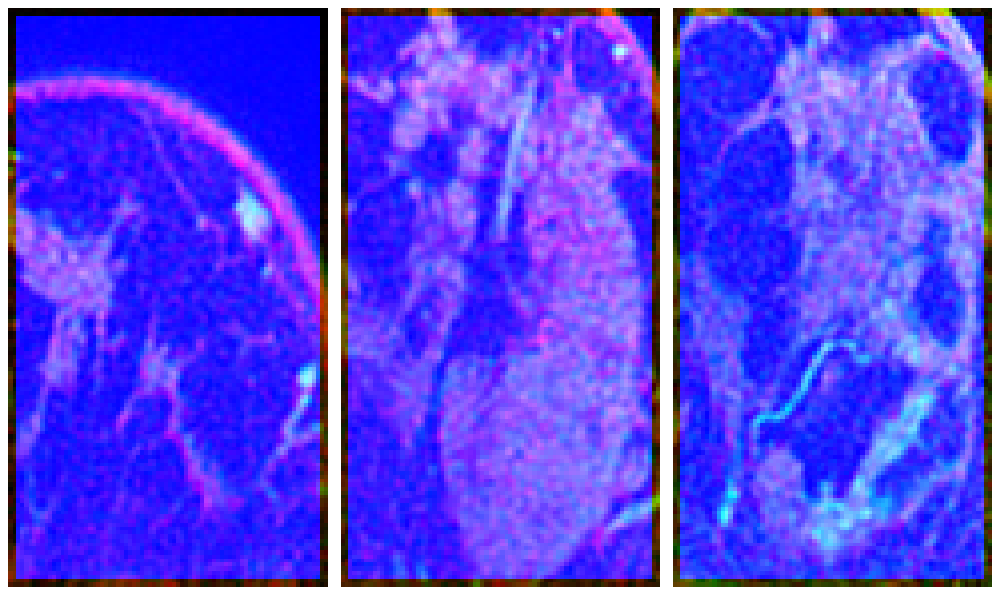

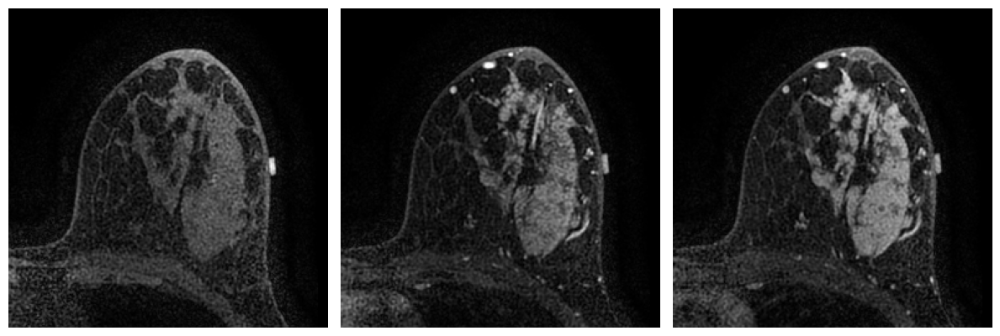

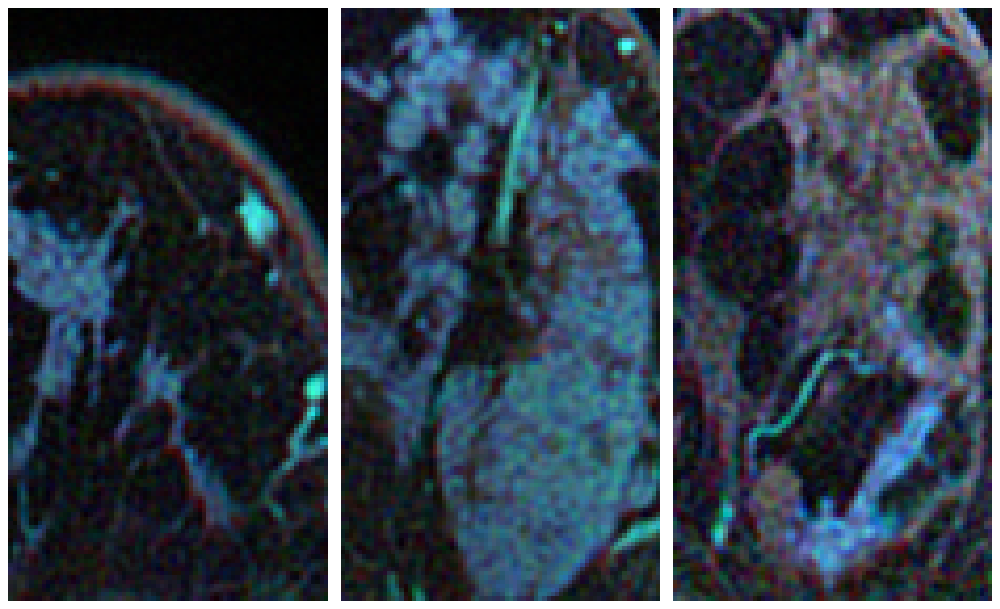

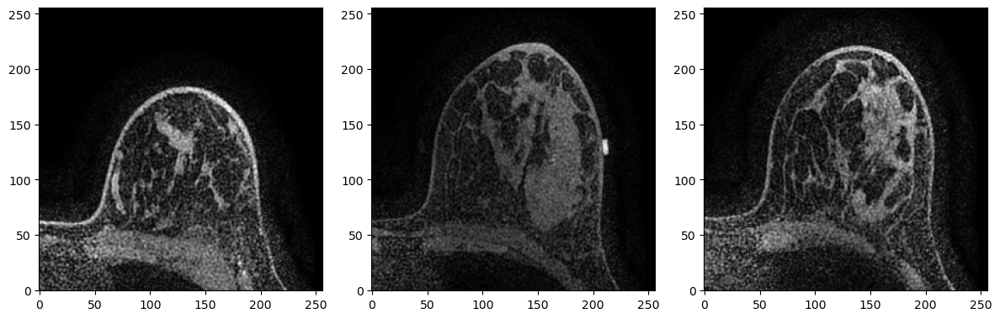

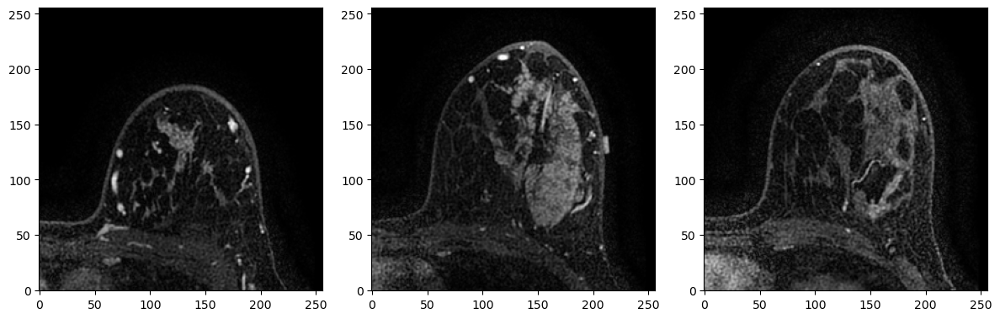

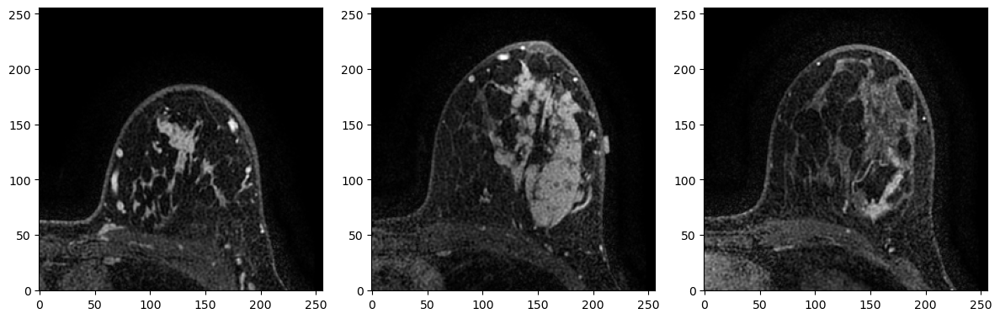

In [62]:
idx=[startm+1, (startm+endm)//2,endm-1]
k=(startm+endm)//2
a0=a0.clip(0,3500)
a1=a1.clip(0,3500)
a2=a2.clip(0,3500)
ds.show_n_images([to_rgb1(a0[k],a1[k],a2[k]) for k in idx], axis_off=False)
plt.imsave('duke200_acq0.png',a0[k] )
plt.imsave('duke200_acq1.png',a1[k] )
plt.imsave('duke200_acq2.png',a2[k] )
ds.show_n_images([np.stack([ds.minmax(a0[k]) ,
                            ds.minmax(a1[k]) ,
                            m[k]],axis=2 ) for k in idx])
k=idx
plt.imsave('duke200_rgb.png',np.stack([ds.minmax(a0[k]) ,
                            ds.minmax(a1[k]) ,
                            ds.minmax(a2[k]) ],axis=2 ) )
plt.imsave('duke200_tumor.png',np.stack([m[k],ds.minmax(a0[k]) ,
                            ds.minmax(a1[k])] ,axis=2 ) )
plt.imsave('duke200_tumor2.png',np.stack([ds.minmax(a0[k]) ,
                            ds.minmax(a1[k]),m[k]] ,axis=2 ) )

ds.show_n_images([np.stack([m[k]/2.,ds.minmax(a0[k]) ,
                            ds.minmax(a1[k])] ,axis=2 ) for k in idx])
ds.show_n_images([np.stack([ds.minmax(a0[k,sraw-2:eraw+2,scol-2:ecol+2]) ,
                            ds.minmax(a1[k,sraw-2:eraw+2,scol-2:ecol+2]) ,
                            m[k,sraw-2:eraw+2,scol-2:ecol+2]],axis=2 ) for k in idx])

ds.show_n_images([ds.minmax(a0[idx[1]]), 
                                ds.minmax(a1[idx[1]]), 
                                             ds.minmax(a2[idx[1]])]) 

ds.show_n_images([to_rgb1(a0[k,sraw:eraw,scol:ecol],
                            a1[k,sraw:eraw,scol:ecol],
                            a2[k,sraw:eraw,scol:ecol])  for k in idx])
ds.show_n_images([a0[k] for k in idx], axis_off=False)
ds.show_n_images([a1[k] for k in idx], axis_off=False)
ds.show_n_images([a2[k] for k in idx], axis_off=False)

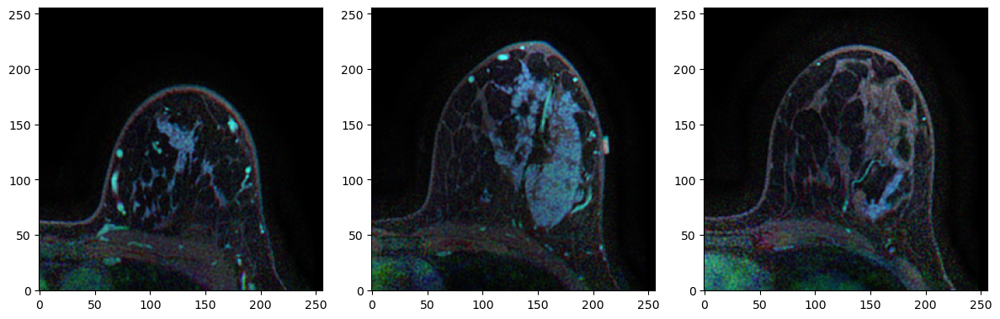

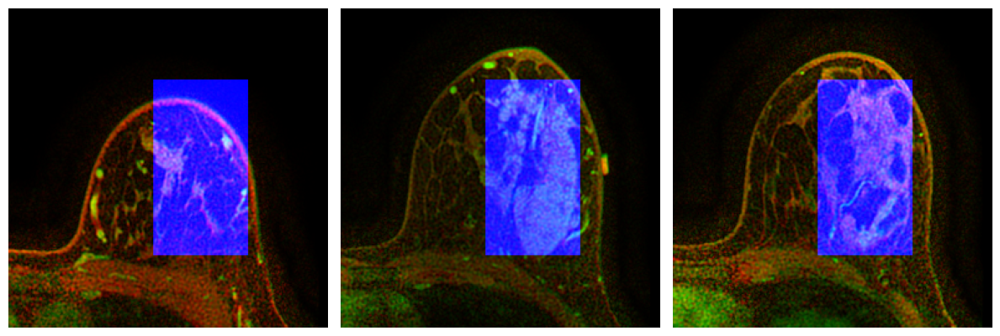

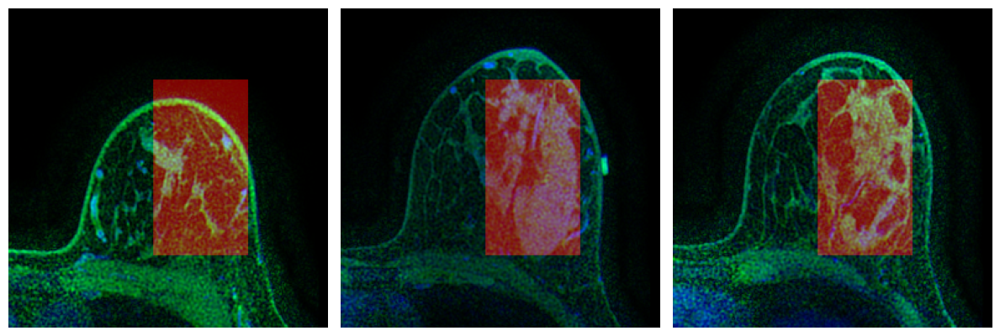

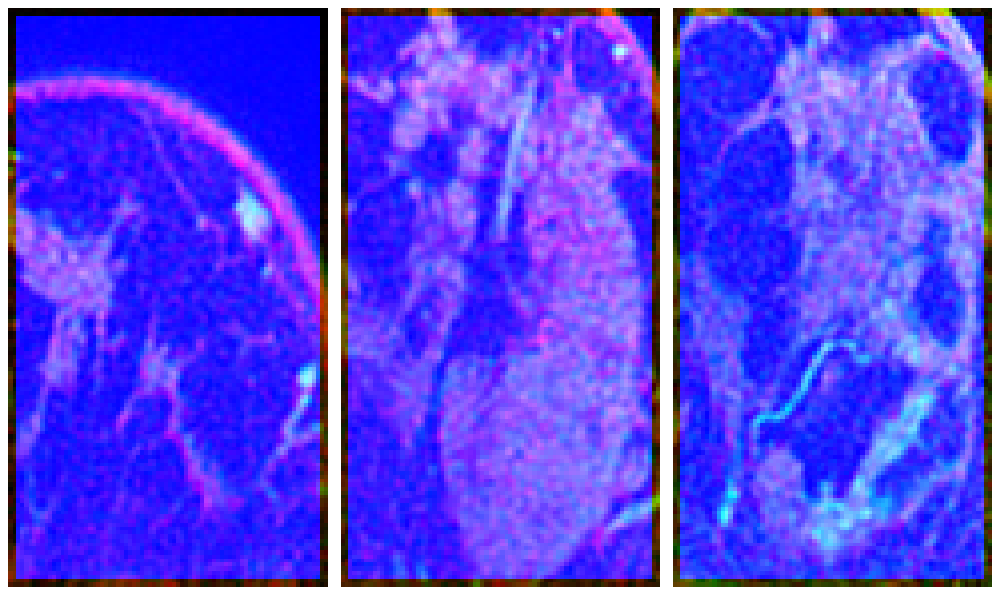

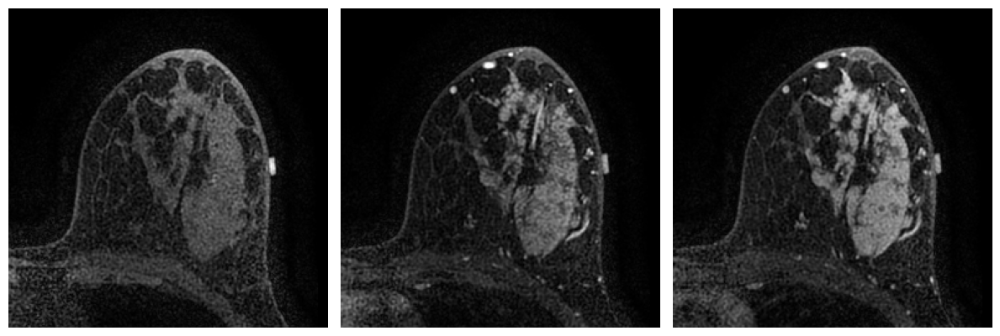

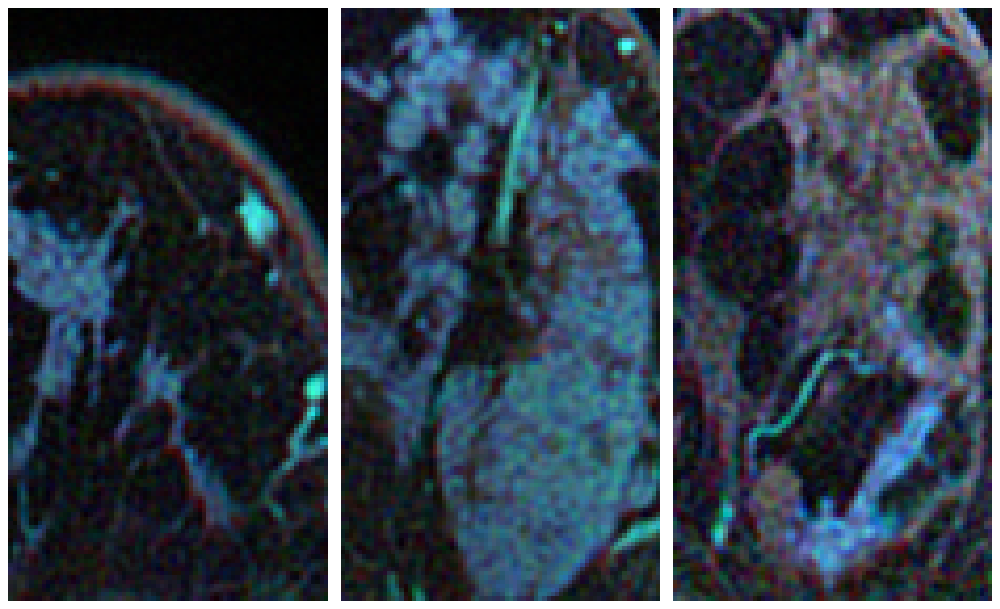

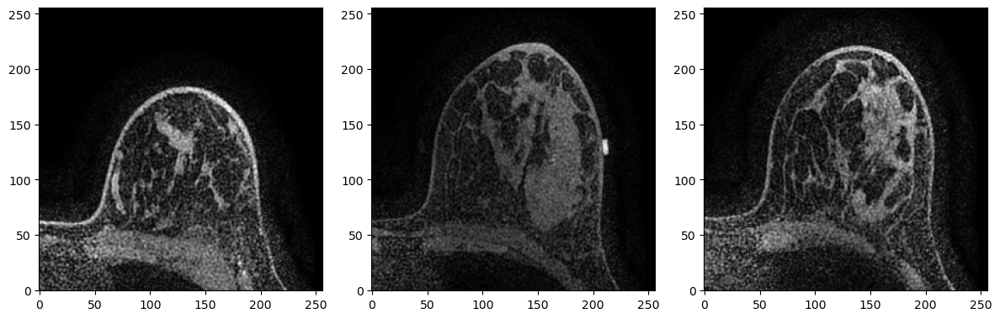

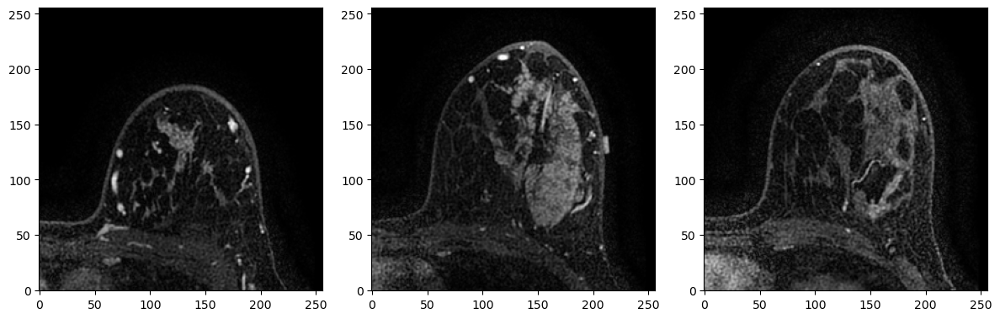

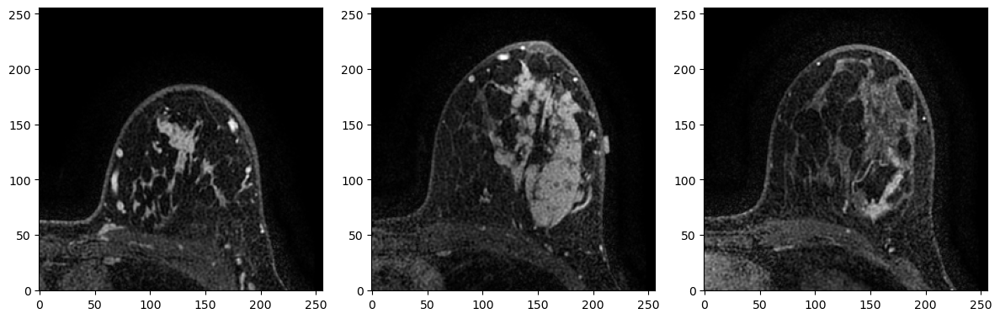

In [62]:
idx=[startm+1, (startm+endm)//2,endm-1]
k=(startm+endm)//2
a0=a0.clip(0,3500)
a1=a1.clip(0,3500)
a2=a2.clip(0,3500)
ds.show_n_images([to_rgb1(a0[k],a1[k],a2[k]) for k in idx], axis_off=False)
plt.imsave('duke200_acq0.png',a0[k] )
plt.imsave('duke200_acq1.png',a1[k] )
plt.imsave('duke200_acq2.png',a2[k] )
ds.show_n_images([np.stack([ds.minmax(a0[k]) ,
                            ds.minmax(a1[k]) ,
                            m[k]],axis=2 ) for k in idx])
k=idx
plt.imsave('duke200_rgb.png',np.stack([ds.minmax(a0[k]) ,
                            ds.minmax(a1[k]) ,
                            ds.minmax(a2[k]) ],axis=2 ) )
plt.imsave('duke200_tumor.png',np.stack([m[k],ds.minmax(a0[k]) ,
                            ds.minmax(a1[k])] ,axis=2 ) )
plt.imsave('duke200_tumor2.png',np.stack([ds.minmax(a0[k]) ,
                            ds.minmax(a1[k]),m[k]] ,axis=2 ) )

ds.show_n_images([np.stack([m[k]/2.,ds.minmax(a0[k]) ,
                            ds.minmax(a1[k])] ,axis=2 ) for k in idx])
ds.show_n_images([np.stack([ds.minmax(a0[k,sraw-2:eraw+2,scol-2:ecol+2]) ,
                            ds.minmax(a1[k,sraw-2:eraw+2,scol-2:ecol+2]) ,
                            m[k,sraw-2:eraw+2,scol-2:ecol+2]],axis=2 ) for k in idx])

ds.show_n_images([ds.minmax(a0[idx[1]]), 
                                ds.minmax(a1[idx[1]]), 
                                             ds.minmax(a2[idx[1]])]) 

ds.show_n_images([to_rgb1(a0[k,sraw:eraw,scol:ecol],
                            a1[k,sraw:eraw,scol:ecol],
                            a2[k,sraw:eraw,scol:ecol])  for k in idx])
ds.show_n_images([a0[k] for k in idx], axis_off=False)
ds.show_n_images([a1[k] for k in idx], axis_off=False)
ds.show_n_images([a2[k] for k in idx], axis_off=False)

In [ ]:
#dd=pd.read_csv('../ISPY2/BreastDCEDL_spy2_tcia_metadata.csv')

In [ ]:

r=df.iloc[1]
pid=r['pid']
print(pid)
a0=ds.get_nifti_acquisition(pid, idx=0)
a1=ds.get_nifti_acquisition(pid, idx=1)
a2=ds.get_nifti_acquisition(pid, idx=r['n_times']-1) # last acqisition

In [ ]:
startm=int(r['mask_start'])
endm=int(r['mask_end'])
        
sraw=int(r['sraw'])
eraw=int(r['eraw'])

scol=int(r['scol'])
ecol=int(r['ecol'])
startm,endm,sraw,eraw,scol,ecol,a0.shape

In [ ]:
# create binary mask from bounding box
m = np.zeros(a0.shape)
m[startm:endm,sraw:eraw,scol:ecol]=1
m.shape

In [ ]:
idx=[startm+1, (startm+endm)//2,endm-1]
ds.show_n_images([ds.to_rgb(a0[k+1],a1[k+1],a2[k+1]) for k in idx], axis_off=False)
ds.show_n_images([np.stack([ds.minmax(a0[k,sraw-20:eraw+20,scol-20:ecol+20]) ,
                            ds.minmax(a1[k,sraw-20:eraw+20,scol-20:ecol+20]) ,
                            m[k,sraw-20:eraw+20,scol-20:ecol+20]],axis=2 ) for k in idx])

ds.show_n_images([ds.to_rgb(a0[k,sraw:eraw,scol:ecol],
                            a1[k,sraw:eraw,scol:ecol],
                            a2[k,sraw:eraw,scol:ecol])  for k in idx])


# Code to crop 

In [ ]:
import numpy as np

def crop_around_voi(array_3d, voi, slice_padding=2, output_size=256):
    """
    Crop a 3D array around a VOI with padding, then extract a centered region of output_size.
    
    Parameters:
    -----------
    array_3d : numpy.ndarray
        3D array with shape (slices, rows, columns)
    voi : list or tuple
        VOI coordinates [sslc:eslc, srow:erow, scol:ecol]
    slice_padding : int
        Number of slices to pad before and after the VOI slice range
    output_size : int
        Size of the final square crop (output_size x output_size)
    
    Returns:
    --------
    numpy.ndarray
        Cropped 3D array with shape (padded_slices, output_size, output_size)
    """
    # Unpack VOI coordinates
    sslc, eslc = voi[0]
    srow, erow = voi[1]
    scol, ecol = voi[2]
    
    # Get array dimensions
    n_slices, n_rows, n_cols = array_3d.shape
    
    # Calculate padded slice range with bounds checking
    padded_sslc = max(0, sslc - slice_padding)
    padded_eslc = min(n_slices - 1, eslc + slice_padding)
    
    # Calculate VOI dimensions
    voi_height = erow - srow
    voi_width = ecol - scol
    
    # Calculate VOI center
    voi_center_row = (srow + erow) // 2
    voi_center_col = (scol + ecol) // 2
    
    # Calculate crop bounds to create output_size x output_size image
    # that keeps the VOI centered as much as possible
    half_size = output_size // 2
    
    # Calculate initial crop bounds
    crop_srow = voi_center_row - half_size
    crop_erow = voi_center_row + half_size
    crop_scol = voi_center_col - half_size
    crop_ecol = voi_center_col + half_size
    
    # Adjust if crop goes outside image boundaries
    if crop_srow < 0:
        crop_erow -= crop_srow  # Shift down
        crop_srow = 0
    if crop_erow >= n_rows:
        shift = crop_erow - n_rows + 1
        crop_erow = n_rows - 1
        crop_srow = max(0, crop_srow - shift)  # Shift up
    
    if crop_scol < 0:
        crop_ecol -= crop_scol  # Shift right
        crop_scol = 0
    if crop_ecol >= n_cols:
        shift = crop_ecol - n_cols + 1
        crop_ecol = n_cols - 1
        crop_scol = max(0, crop_scol - shift)  # Shift left
    
    # Ensure we have exactly output_size dimensions
    # This handles edge cases where shifting doesn't give exact size
    if crop_erow - crop_srow + 1 != output_size:
        crop_erow = crop_srow + output_size - 1
        if crop_erow >= n_rows:
            crop_erow = n_rows - 1
            crop_srow = n_rows - output_size
    
    if crop_ecol - crop_scol + 1 != output_size:
        crop_ecol = crop_scol + output_size - 1
        if crop_ecol >= n_cols:
            crop_ecol = n_cols - 1
            crop_scol = n_cols - output_size
    
    # Perform the crop
    cropped_array = array_3d[padded_sslc:padded_eslc+1, 
                             crop_srow:crop_erow+1, 
                             crop_scol:crop_ecol+1]
    
    return cropped_array, (padded_sslc, padded_eslc, crop_srow, crop_erow, crop_scol, crop_ecol)

In [ ]:
import numpy as np

def crop_around_voi_cords(array_3d_shape, voi, slice_padding=2, output_size=256):
    
    # Unpack VOI coordinates
    sslc, eslc = voi[0]
    srow, erow = voi[1]
    scol, ecol = voi[2]
    
    # Get array dimensions
    n_slices, n_rows, n_cols = array_3d_shape
    
    # Calculate padded slice range with bounds checking
    padded_sslc = max(0, sslc - slice_padding)
    padded_eslc = min(n_slices - 1, eslc + slice_padding)
    
    # Calculate VOI dimensions
    voi_height = erow - srow
    voi_width = ecol - scol
    
    # Calculate VOI center
    voi_center_row = (srow + erow) // 2
    voi_center_col = (scol + ecol) // 2
    
    # Calculate crop bounds to create output_size x output_size image
    # that keeps the VOI centered as much as possible
    half_size = output_size // 2
    
    # Calculate initial crop bounds
    crop_srow = voi_center_row - half_size
    crop_erow = voi_center_row + half_size
    crop_scol = voi_center_col - half_size
    crop_ecol = voi_center_col + half_size
    
    # Adjust if crop goes outside image boundaries
    if crop_srow < 0:
        crop_erow -= crop_srow  # Shift down
        crop_srow = 0
    if crop_erow >= n_rows:
        shift = crop_erow - n_rows + 1
        crop_erow = n_rows - 1
        crop_srow = max(0, crop_srow - shift)  # Shift up
    
    if crop_scol < 0:
        crop_ecol -= crop_scol  # Shift right
        crop_scol = 0
    if crop_ecol >= n_cols:
        shift = crop_ecol - n_cols + 1
        crop_ecol = n_cols - 1
        crop_scol = max(0, crop_scol - shift)  # Shift left
    
    # Ensure we have exactly output_size dimensions
    # This handles edge cases where shifting doesn't give exact size
    if crop_erow - crop_srow + 1 != output_size:
        crop_erow = crop_srow + output_size - 1
        if crop_erow >= n_rows:
            crop_erow = n_rows - 1
            crop_srow = n_rows - output_size
    
    if crop_ecol - crop_scol + 1 != output_size:
        crop_ecol = crop_scol + output_size - 1
        if crop_ecol >= n_cols:
            crop_ecol = n_cols - 1
            crop_scol = n_cols - output_size
    
    
    
    return  (padded_sslc, padded_eslc, crop_srow, crop_erow, crop_scol, crop_ecol)

In [ ]:
def crop_with_same_coordinates(array_3d, crop_coords):
    """
    Crop a 3D array using previously determined crop coordinates.
    
    Parameters:
    -----------
    array_3d : numpy.ndarray
        3D array to be cropped with shape (slices, rows, columns)
    crop_coords : tuple
        Coordinates from previous crop (padded_sslc, padded_eslc, crop_srow, crop_erow, crop_scol, crop_ecol)
    
    Returns:
    --------
    numpy.ndarray
        Cropped 3D array with same dimensions as the previously cropped array
    """
    # Unpack crop coordinates
    padded_sslc, padded_eslc, crop_srow, crop_erow, crop_scol, crop_ecol = crop_coords
    
    # Check if coordinates are within bounds of the new array
    n_slices, n_rows, n_cols = array_3d.shape
    
    # Validate slice coordinates
    if padded_eslc >= n_slices:
        raise ValueError(f"Slice end coordinate {padded_eslc} exceeds array dimension {n_slices}")
    
    # Validate row coordinates
    if crop_erow >= n_rows:
        raise ValueError(f"Row end coordinate {crop_erow} exceeds array dimension {n_rows}")
    
    # Validate column coordinates
    if crop_ecol >= n_cols:
        raise ValueError(f"Column end coordinate {crop_ecol} exceeds array dimension {n_cols}")
    
    # Perform the crop using the same coordinates
    cropped_array = array_3d[padded_sslc:padded_eslc+1, 
                             crop_srow:crop_erow+1, 
                             crop_scol:crop_ecol+1]
    
    return cropped_array

# View example of cropped MRI scan

In [ ]:
df=pd.read_csv('BrestDCEDL_duke_cropped.csv')

In [ ]:
for i, row in df.iterrows():
        pid=row['pid']
        c=ds.get_nifti_acquisition(pid, idx=0)
        df.at[i, 'maxdcm0']=c[0].max()
        df.at[i, 'maxdcm1']=c[1].max()
        df.at[i, 'maxdcm2']=c[2].max()
        df.at[i, 'meandcm0']=c[0].mean()
        df.at[i, 'meandcm1']=c[1].mean()
        df.at[i, 'meandcm2']=c[2].mean()
        df.at[i, 'nunq0']=len(set(c[0].flatten()))
        df.at[i, 'nunq1']=len(set(c[1].flatten()))
        df.at[i, 'nunq2']=len(set(c[2].flatten()))

In [ ]:
df.to_csv('df_min_duke_info.csv', index = False)

In [ ]:
df.columns

In [ ]:
df.describe()

In [ ]:
df.maxdcm0.plot(kind='hist',bins=50,figsize=(4,3), alpha=0.5)
df.maxdcm1.plot(kind='hist',bins=50,figsize=(4,3), alpha=0.5)
df.maxdcm2.plot(kind='hist',bins=50,figsize=(4,3), alpha=0.5)

In [ ]:
df.columns

In [ ]:
'xy_spacing', 'voxel_z', 'slice_scape','maxdcm0', 'maxdcm1', 'meandcm0', 'meandcm1',
       'nunq0', 'maxdcm2', 'meandcm2'

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import numpy as np

# Select features and target
features = ['xy_spacing', 'voxel_z', 'slice_scape', 'maxdcm0', 'maxdcm1', 
            'meandcm0', 'meandcm1', 'nunq0', 'maxdcm2', 'meandcm2']
X = df[features].values
y = df['HER2'].values  # This contains 0/1 integers

# Map integer labels to human-readable strings
label_map = {0: 'Negative', 1: 'Positive'}
y_mapped = np.array([label_map[i] for i in y])

# Perform PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Create plot
plt.figure(figsize=(6,4))

# Color points by HER2 status
colors = {'Positive': 'red', 'Negative': 'blue'}
for status in np.unique(y_mapped):
    mask = (y_mapped == status)
    plt.scatter(X_pca[mask, 0], X_pca[mask, 1], 
                c=colors[status], 
                label=f'HER2 {status}', 
                alpha=0.7)

# Add labels and title
plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)')
plt.title('PCR Analysis: Principal Components Colored by HER2 Status')
plt.legend()
plt.grid(True)
plt.show()



In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,MinMaxScaler
import numpy as np

# Load your data - replace this with your actual data loading
# df = pd.read_csv('your_data.csv')

# Select features and target
features = ['xy_spacing', 'voxel_z', 'slice_scape', 'maxdcm0', 'maxdcm1', 
            'meandcm0', 'meandcm1', 'nunq0', 'maxdcm2', 'meandcm2']
X = df[features].values
y = df['HER2'].values  # Should contain 0/1 integers

# 1. NORMALIZATION: Standardize features
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

# 2. DIMENSIONALITY REDUCTION: PCA to 2 components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Map integer labels to strings
label_map = {0: 'Negative', 1: 'Positive'}
y_mapped = np.array([label_map[i] for i in y])

# Create plot
plt.figure(figsize=(6,4))

# Color points by HER2 status
colors = {'Positive': 'red', 'Negative': 'blue'}
for status in np.unique(y_mapped):
    mask = (y_mapped == status)
    plt.scatter(X_pca[mask, 0], X_pca[mask, 1], 
                c=colors[status], 
                label=f'HER2 {status}', 
                alpha=0.7,
                s=10)  # s controls point size

# Add labels and title
plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)')
plt.title('Principal Component Analysis of Imaging Features')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


In [ ]:
X_pca = pca.fit_transform(X_scaled)


In [ ]:
# Example thresholds (adjust as needed for your plot)
pc1_threshold = -1.5
pc2_threshold = 3.5

# Find indices of points in the top left corner
corner_mask = (X_pca[:, 0] < pc1_threshold) & (X_pca[:, 1] > pc2_threshold)
corner_indices = np.where(corner_mask)[0]

# Get the rows from the original DataFrame
corner_rows = df.iloc[corner_indices]
corner_rows[features].describe()


In [ ]:
df[df.index.isin(corner_indices)][features]

In [ ]:
a=get

In [ ]:
df[df.index.isin(corner_indices)][['pid']+features].sample(5)

In [ ]:
df[~df.index.isin(corner_indices)][['pid']+features].sample(5)

In [ ]:
df[~df.index.isin(corner_indices)][features].describe()

In [ ]:
df[df.maxdcm0>8000]

In [ ]:

a0=ds.get_nifti_acquisitions('Breast_MRI_093')
ds.print_info([a0[0][10]])

In [ ]:
a0=ds.get_nifti_acquisitions('Breast_MRI_571')

ds.print_info([a0[0][10]])

In [ ]:
import re
import nibabel as nib
data_path="G:\\My Drive\\breast_mri\\DUKE\\min_dce\\"

In [ ]:
def read_niftii(fname):
    # Load the NIfTI file
    nii_img = nib.load(fname)

    # Get the data (as a NumPy array)
    mnii_data = nii_img.get_fdata()

    return mnii_data

In [ ]:
def extract_last_number(filename):
    # Match the LAST number in the filename, regardless of preceding character
    # Uses: \d+ = one or more digits, \. = literal dot, .* = any characters after
    match = re.search(r'(\d+)\.nii\.gz$', filename)
    return int(match.group(1)) if match else -1

def get_all_nifti_acquisitions(pid):
    
    
    ff = [x for x in os.listdir(data_path) if pid in x]
    sorted_filenames = sorted(ff, key=extract_last_number)
    
    img = []
    for f in sorted_filenames:
        x = read_niftii(os.path.join(data_path, f))
        img.append(x)
        
    return img

In [ ]:
a0=get_all_nifti_acquisitions('Breast_MRI_247')

len(a0),a0[0].shape

In [ ]:
x=os.listdir("G:\\My Drive\\breast_mri\\DUKE\\min_dce\\")
[c for c in x if 'Breast_MRI_793' in c]             

In [ ]:
import numpy as np
image_data=a0[0][10]
# Suppose image_data is your 2D numpy array with values 0-7000
# image_data = ...

# 1. Calculate quantile edges for 256 bins (0-255)
quantiles = np.percentile(image_data, np.linspace(0, 100, 256))

# 2. Map each pixel to its quantile bin (0-255)
quantile_indices = np.searchsorted(quantiles, image_data, side='right') - 1

# 3. Clip indices to ensure they stay within 0-255
quantile_indices = np.clip(quantile_indices, 0, 255)

# Now, quantile_indices is your quantile-mapped image (values 0-255)
ds.show_n_images([a0[0][10],quantile_indices])

In [ ]:
ds.print_info([a0[0][10]]),len(np.unique(a0[0][10].flatten()))

In [ ]:
import numpy as np

# Suppose image_data is your 2D numpy array
flat = a0[0][10].flatten()

# Get the ranks (percentiles) of each pixel
ranks = flat.argsort().argsort()
quantile_mapped = np.floor(255 * ranks / (len(flat) - 1)).astype(np.uint8)

# Reshape back to original image shape
image_quantile = quantile_mapped.reshape(image_data.shape)

# Optional: To check new stats
print(image_quantile.min(), image_quantile.max(), image_quantile.mean(), image_quantile.std())
ds.show_n_images([a0[0][10],quantile_indices,image_quantile])

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
image_data=np.stack([a0[0][10],a0[0][10],a0[0][10]],axis=2)
# Suppose image_data is (height, width, channels)
h, w, c = image_data.shape
flat = image_data.reshape(-1, c)  # Reshape to (pixels, channels)

pca = PCA(n_components=1)
pc1 = pca.fit_transform(flat)  # First principal component

# Normalize to 0-255 for display
pc1_minmax = (pc1 - pc1.min()) / (pc1.max() - pc1.min()) * 255
pc1_img = pc1_minmax.reshape(h, w).astype(np.uint8)
ds.show_n_images([a0[0][10],quantile_indices,pc1_img])

In [ ]:
ds.print_info([a0[0][10],pc1_img ]),a0[0].shape,np.stack([a0[0],a0[1],a0[2]],axis=3).shape

In [ ]:
def reduce_pce(im):
    image_data = np.stack([im, im, im], axis=3)

    # Unpack the shape
    z, x, y, c = image_data.shape

    # Flatten spatial dimensions, keep channels as features
    flat = image_data.reshape(-1, c)  # shape: (z*x*y, 3)

    # Apply PCA
    pca = PCA(n_components=1)
    pc1 = pca.fit_transform(flat)

    # Normalize to 0-255 for display
    pc1_minmax = (pc1 - pc1.min()) / (pc1.max() - pc1.min()) * 255
    pc1_img = pc1_minmax.reshape(z, x, y).astype(np.uint8)
    return pc1_img

In [ ]:
from skimage import exposure
def get_hist(im):
    # image_data: (z, x, y, c)
    # Apply to a single channel or to your PCA result
    img = im.copy() # or use your PCA result
    img_eq = exposure.equalize_hist(img)  # Output is float in [0, 1]
    img_eq_255 = (img_eq * 255).astype(np.uint8)
    return img_eq_255

def get_log(im):
    img = im #image_data[..., 0]  # or your PCA result
    img_log = np.log1p(img.copy())  # log(1 + x) to avoid log(0)
    img_log_norm = (img_log - img_log.min()) / (img_log.max() - img_log.min()) * 255
    img_log_uint8 = img_log_norm.astype(np.uint8)
    return img_log_uint8

def get_quntil(im):
    flat = im.copy().flatten()
    ranks = flat.argsort().argsort()
    quantile_img = np.floor(255 * ranks / (len(flat) - 1)).astype(np.uint8).reshape(im.shape)
    return quantile_img


In [ ]:
import numpy as np

def percentile_clipping(data, lower_pct=1, upper_pct=99.99):
    print('from:', data.min(),data.max())
    lower = np.percentile(data.copy().flatten(), lower_pct)
    upper = np.percentile(data, upper_pct)
    clipped = np.clip(data.copy(), lower, upper)
    print('to:',lower,upper)
    return clipped

def mad_clipping(data, n_mad=20):
    print('from:', data.min(),data.max())
    median = np.median(data.copy().flatten())
    mad = np.median(np.abs(data - median))
    lower = median - n_mad * mad
    upper = median + n_mad * mad
    print('to:',lower,upper)
    clipped = np.clip(data.copy(), lower, upper)
    print(lower,upper)
    return clipped
 

In [ ]:
a0=get_all_nifti_acquisitions('Breast_MRI_895')

len(a0),a0[0].shape

In [ ]:
a00=a0[0]
ds.print_info([a0[0]])

In [ ]:
import numpy as np

def map_to_ordered_uniques(arr):
    """
    Map a NumPy array to the indices of its unique values, preserving order of appearance.

    Parameters:
        arr (np.ndarray): Input array (1D or multi-dimensional)

    Returns:
        mapped (np.ndarray): Array of same shape with indices of unique values
        uniques (list): Ordered list of unique values
    """
    arr_flat = arr.flatten()
    uniques = []
    index_map = {}

    for val in arr_flat:
        if val not in index_map:
            index_map[val] = len(uniques)
            uniques.append(val)

    mapped_flat = np.array([index_map[val] for val in arr_flat])
    mapped = mapped_flat.reshape(arr.shape)

    return mapped, uniques

In [ ]:
import numpy as np

def map_to_ordered_uniques(arr):
    """
    Map a NumPy array to the indices of its unique values, preserving order of appearance.

    Parameters:
        arr (np.ndarray): Input array (any shape)

    Returns:
        mapped (np.ndarray): Array of same shape with indices of unique values
        uniques (list): Ordered list of unique values
    """
    arr = np.asarray(arr)
    flat = arr.ravel()

    uniques = []
    index_map = {}

    for val in flat:
        if val not in index_map:
            index_map[val] = len(uniques)
            uniques.append(val)

    mapped_flat = np.array([index_map[val] for val in flat])
    mapped = mapped_flat.reshape(arr.shape)

    return mapped

In [ ]:
x=map_to_ordered_uniques(a00)
x.shape,len(x)

In [ ]:
x=np.unique(a00[a00>np.quantile(a00.flatten(),0.95)])
len(x),np.quantile(a00.flatten(),0.1),len(np.unique(a00.flatten()))

In [ ]:
a00=np.where(a00<0,0,a00)

In [ ]:
unique_counts_by_quantile(pd.Series(a00.flatten()))

In [ ]:
unique_counts_by_quantile(pd.Series(a0[1].flatten()))

In [ ]:
ds.show_n_images([a0[0][7], mad_clipping(a0[0])[7],percentile_clipping(a0[0])[7]])
ds.print_info([a0[0][7], mad_clipping(a0[0])[7],percentile_clipping(a0[0])[7]])
ds.print_info([a0[0][7], mad_clipping(a0[0][7]),percentile_clipping(a0[0][7])])

In [ ]:
a0[0]=mad_clipping(a0[0])#[7]),percentile_clipping(a0[0][7])
a0[1]=mad_clipping(a0[1])#[7]),percentile_clipping(a0[0][7])
a0[2]=mad_clipping(a0[2])#[7]),percentile_clipping(a0[0][7])

In [ ]:
a0[0]=map_to_ordered_uniques(a0[0])#[7]),percentile_clipping(a0[0][7])
a0[1]=map_to_ordered_uniques(a0[1])#[7]),percentile_clipping(a0[0][7])
a0[2]=map_to_ordered_uniques(a0[2])#[7]),percentile_clipping(a0[0][7])

In [ ]:
a0[0]=percentile_clipping(a0[0])#[7]),percentile_clipping(a0[0][7])
a0[1]=percentile_clipping(a0[1])#[7]),percentile_clipping(a0[0][7])
a0[2]=percentile_clipping(a0[2])#[7]),percentile_clipping(a0[0][7])

In [ ]:
im0=np.stack([ds.minmax(a0[0]),ds.minmax(a0[1]),ds.minmax(a0[2])], axis=3)
im1=ds.minmax(np.stack([a0[0],a0[1],a0[2]], axis=3))
ds.show_n_images([im1[k] for k in idx])
ds.show_n_images([im0[k] for k in idx])

In [ ]:
idx=[5,12,15]
im3=np.stack([reduce_pce(a0[0]),reduce_pce(a0[1]),reduce_pce(a0[2])], axis=3)
'''ds.show_n_images([im3[k] for k in idx])
ds.show_n_images([im0[k] for k in idx])'''
k=idx[1]
ds.show_n_images([im0[k],im3[k],im1[k]])# for k in [10,20,30]])
ds.show_n_images([get_hist(im0)[k], get_log(im3)[k], get_quntil(im1)[k]])

a0[0]=percentile_clipping(a0[0])#[7]),percentile_clipping(a0[0][7])
a0[1]=percentile_clipping(a0[1])#[7]),percentile_clipping(a0[0][7])
a0[2]=percentile_clipping(a0[2])#[7]),percentile_clipping(a0[0][7])
im0=np.stack([ds.minmax(a0[0]),ds.minmax(a0[1]),ds.minmax(a0[2])], axis=3)
im1=ds.minmax(np.stack([a0[0],a0[1],a0[2]], axis=3))
im3=np.stack([reduce_pce(a0[0]),reduce_pce(a0[1]),reduce_pce(a0[2])], axis=3)

ds.show_n_images([get_hist(im0)[k], get_log(im3)[k], get_quntil(im1)[k]])

In [ ]:
a0=get_all_nifti_acquisitions('Breast_MRI_120')
im0=np.stack([ds.minmax(a0[0]),ds.minmax(a0[1]),ds.minmax(a0[2])], axis=3)
im1=ds.minmax(np.stack([a0[0],a0[1],a0[2]], axis=3))
im1.shape

In [ ]:
idx=[2,5,7]
im3=np.stack([reduce_pce(a0[0]),reduce_pce(a0[1]),reduce_pce(a0[2])], axis=3)
ds.show_n_images([im3[k] for k in idx])
ds.show_n_images([im0[k] for k in idx])
k=idx[1]
ds.show_n_images([im0[k],im3[k],im1[k]])# for k in [10,20,30]])
ds.print_info([im0,im1,ds.minmax(im3)])
ds.print_info([(im0*255).astype(np.uint8),im1,ds.minmax(im3)])
[len(np.unique(im0)),len(np.unique(im3)),len(np.unique(im1)), 
 len(np.unique(reduce_pce(a0[0]))),len(np.unique(reduce_pce(a0[1]))),len(np.unique(reduce_pce(a0[2]))),
len(np.unique((im0*255).astype(np.uint8))),
 len(np.unique((im3*255).astype(np.uint8))),
 len(np.unique((im1*255).astype(np.uint8))) ]

In [ ]:
a0=get_all_nifti_acquisitions('Breast_MRI_694')
im0=np.stack([ds.minmax(a0[0]),ds.minmax(a0[1]),ds.minmax(a0[2])], axis=3)
im1=ds.minmax(np.stack([a0[0],a0[1],a0[2]], axis=3))
im1.shape

In [ ]:
im40=np.sqrt(a0[0]/1000)#*a0[0]
im41=np.sqrt(a0[1]/1000)#*a0[1]
im42=np.sqrt(a0[2]/1000)#*a0[2]
im0=np.stack([ds.minmax(a0[0]),ds.minmax(a0[1]),ds.minmax(a0[2])], axis=3)
im440=np.stack([ds.minmax(im40),ds.minmax(im41),ds.minmax(im42)], axis=3)
im1=ds.minmax(np.stack([a0[0],a0[1],a0[2]], axis=3))
im1.shape

In [ ]:
idx=[2,5,7]
im3=np.stack([reduce_pce(a0[0]),reduce_pce(a0[1]),reduce_pce(a0[2])], axis=3)
ds.show_n_images([im3[k] for k in idx])
ds.show_n_images([im0[k] for k in idx])
ds.show_n_images([im440[k] for k in idx])
k=idx[1]
ds.show_n_images([im0[k],im3[k],im1[k]])# for k in [10,20,30]])
ds.print_info([im0,im1,im3,ds.minmax(im3)])

In [ ]:
plt.hist(im0[:,:,0].flatten(), bins=50);

In [ ]:
plt.hist(im1[:,:,0].flatten(), bins=50);

In [ ]:
plt.hist(im3[:,:,0].flatten(), bins=50);

In [ ]:
im4 = a0[0]*a0[0]
im3.shape

In [ ]:
im3=np.stack([reduce_pce(a0[0]),reduce_pce(a0[1]),reduce_pce(a0[2])], axis=3)
ds.show_n_images([im3[k] for k in [10,20,22]])
ds.show_n_images([ds.minmax(im4[k]) for k in [10,20,22]])
ds.show_n_images([im0[k] for k in [10,20,22]])
ds.show_n_images([im0[20],im3[20],im1[20]])# for k in [10,20,30]])

<Figure size 640x480 with 0 Axes>

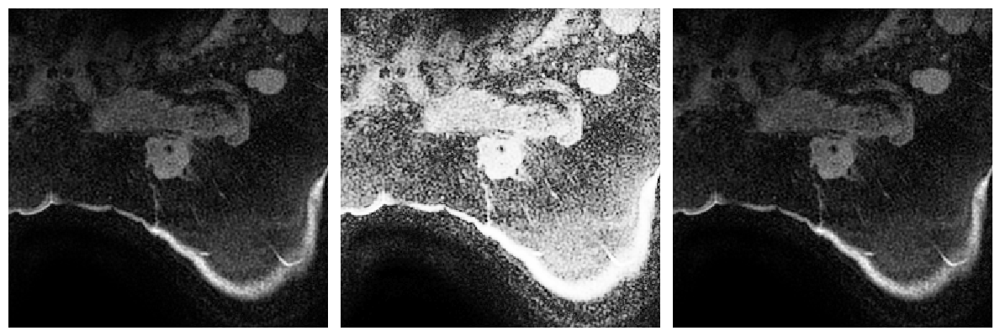

In [134]:
import numpy as np
from sklearn.decomposition import PCA

# Assuming a0 is a list of 3 arrays, each of shape (37, 256, 256)
# Stack along the last axis to create a 4D array: (37, 256, 256, 3)
image_data = np.stack([a0[0], a0[0], a0[0]], axis=3)

# Unpack the shape
z, x, y, c = image_data.shape

# Flatten spatial dimensions, keep channels as features
flat = image_data.reshape(-1, c)  # shape: (z*x*y, 3)

# Apply PCA
pca = PCA(n_components=1)
pc1 = pca.fit_transform(flat)

# Normalize to 0-255 for display
pc1_minmax = (pc1 - pc1.min()) / (pc1.max() - pc1.min()) * 255
pc1_img = pc1_minmax.reshape(z, x, y).astype(np.uint8)
ds.show_n_images([a0[0][10],quantile_indices,pc1_img[10]])

In [135]:
ds.print_info([a0[0][10],quantile_indices,pc1_img[10]])

(256, 256) 0.0 936.0 129.82595825195312 129.9348731941119 n!=0: 62541 136.04313970035656 float64
(256, 256) 11 255 127.65933227539062 73.01412014748631 n!=0: 65536 127.65933227539062 int64
(256, 256) 0 180 24.609054565429688 25.08005084938263 n!=0: 59773 26.98173088183628 uint8


(array([9157., 6138., 6494., 5931., 6352., 6452., 6147., 6515., 6152.,
        6198.]),
 array([ 11. ,  35.4,  59.8,  84.2, 108.6, 133. , 157.4, 181.8, 206.2,
        230.6, 255. ]),
 <BarContainer object of 10 artists>)

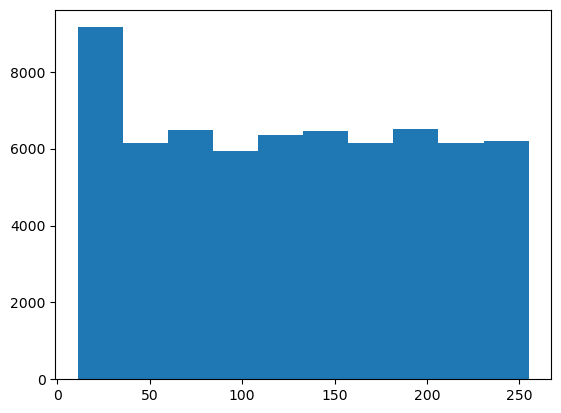

In [89]:
plt.hist(quantile_indices.flatten())

<Figure size 640x480 with 0 Axes>

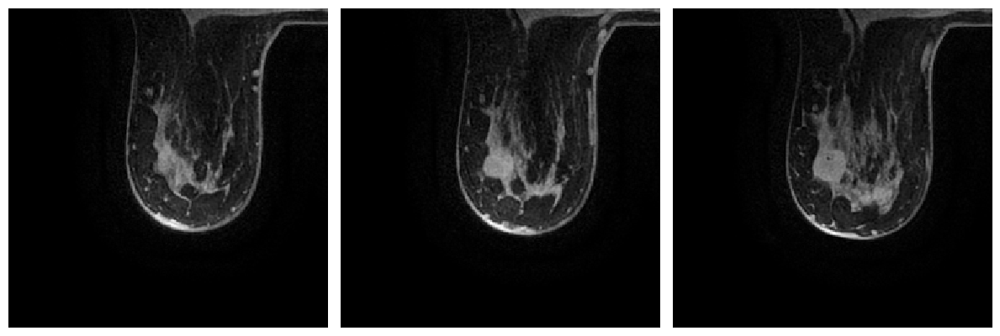

<Figure size 640x480 with 0 Axes>

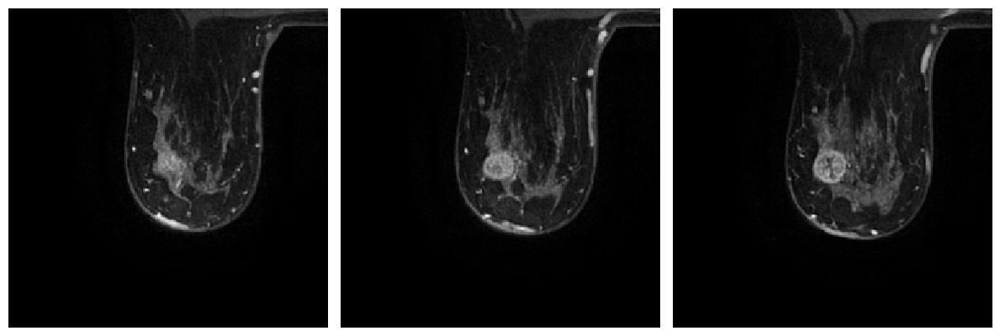

In [77]:
ds.show_n_images([a0[0][k] for k in [4,7,12]])
ds.show_n_images([a0[1][k] for k in [4,7,12]])

In [ ]:
    #if min_duke:

    # Iterate through DataFrame rows
    for i, row in df.iterrows():
        
        pid =  row['pid']
            
        print(i,row['pid'],row['mask_start'],row['mask_end'])
        
        
        startm=int(row['mask_start'])
        endm=int(row['mask_end'])
        
        sraw=int(row['sraw'])
        eraw=int(row['eraw'])

        scol=int(row['scol'])
        ecol=int(row['ecol'])

        a0=ds.get_nifti_acquisition(pid, idx=0)
        
        if a0 is not None:
            if row['n_z'] is not None:
                z=int(row['n_z'])
                assert(a0.shape[0]==z)
            else:
                df_crop.at[i,'org_n_z']=a0.shape[0]
                print('===XXXXXXXXXX===  correct n_z of ',pid,' to ',a0.shape[0])
        else:
            continue
            
        w=int(row['n_xy'])
        
        
        assert(a0.shape[1]==w)
        assert(a0.shape[2]==w)
        
        
        print(i, '---',pid,a0.shape)
        voi = [(startm,endm),(sraw,eraw),(scol,ecol)] 
        crop_coords = crop_around_voi_cords(a0.shape, voi, slice_padding=1, output_size=256)
        print('====crop', crop_coords)
        print(a0.shape)
        print(startm,endm)
       
        
        #(41, 140, 161, 416, 255, 510)
        df_crop.at[i, 'crop_mask_start']=crop_coords[0]
        df_crop.at[i, 'crop_mask_end']=crop_coords[1]
        df_crop.at[i, 'crop_sraw']=crop_coords[2]
        df_crop.at[i, 'crop_eraw']=crop_coords[3]
        df_crop.at[i, 'crop_scol']=crop_coords[4]
        df_crop.at[i, 'crop_ecol']=crop_coords[5]
        r=row
        #a0=ds.get_nifti_acquisition(pid, idx=0)
        i1 = int(row['post_early'])
        i2 = int(row['post_late'])
        i0 = int(row['pre'])
        a1=ds.get_nifti_acquisition(pid, idx=i1)
        a2=ds.get_nifti_acquisition(pid, idx=i2)

        if row['n_xy']<256:
            c=[]
            crop_coords=np.array(crop_coords)
            crop_coords[2]=0
            crop_coords[3]=256
            crop_coords[4]=0
            crop_coords[5]=256
            c0=[]
            c1=[]
            c2=[]
            for h in range(a0.shape[0]):
                img=a0[h]
                       
                c0.append(cv2.resize(a0[h], (256, 256), interpolation=cv2.INTER_AREA) )
                c1.append(cv2.resize(a1[h], (256, 256), interpolation=cv2.INTER_AREA) )
                c2.append(cv2.resize(a2[h], (256, 256), interpolation=cv2.INTER_AREA) )
                        
            ca0=np.array(c0)
            ca1=np.array(c1)
            ca2=np.array(c2)
           
        else:
            ca0 = crop_with_same_coordinates(a0, crop_coords)
            ca1 = crop_with_same_coordinates(a1, crop_coords)
            ca2 = crop_with_same_coordinates(a2, crop_coords)
        c = [ca1,ca1,ca2]
        
        print('saving:', ca0.shape)
        fn = pid+'_spy2_vis1_dce_aqc_'+str(int(i0))+'.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),ca0)
        print('saving:',os.path.join(fpath, fn))
        
        fn = pid+'_spy2_vis1_dce_aqc_'+str(int(i1))+'.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),ca1)
        print('saving:',os.path.join(fpath, fn))
        
        fn = pid+'_spy2_vis1_dce_aqc_'+str(int(i2))+'.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),ca2)
        print('saving:',os.path.join(fpath, fn))
        
        df_crop.at[i, 'maxdcm0']=c[0].max()
        df_crop.at[i, 'maxdcm1']=c[1].max()
        df_crop.at[i, 'maxdcm0']=c[2].max()
        df_crop.at[i, 'meandcm0']=c[0].mean()
        df_crop.at[i, 'meandcm1']=c[1].mean()
        df_crop.at[i, 'meandcm0']=c[2].mean()
        df_crop.at[i, 'nunq0']=len(set(c[0].flatten()))
        df_crop.at[i, 'nunq1']=len(set(c[0].flatten()))
        df_crop.at[i, 'nunq0']=len(set(c[0].flatten()))
        
        mstart= startm-crop_coords[0]
        mend= endm-crop_coords[0]
        f=max(0,mstart-1)
        l=min(mend+1, c[0].shape[0])
        for jj in range(f,l):
            dce=np.stack([c[0][jj],c[1][jj],c[2][jj]],axis=2)
            os.makedirs(os.path.join(nfpath,pid), exist_ok=True)

            fn=pid+'_spy2_slc_'+str(jj)+'.nii.gz'
            ds.save_niftii(os.path.join(nfpath,pid,fn), dce)
            
        
        print('ser:', i0,i1,i2)  
        # Calculate New variables
        df_crop.at[i,'mask_start'] = startm-crop_coords[0]
        df_crop.at[i,'mask_end'] = endm-crop_coords[0]
        df_crop.at[i,'sraw'] = sraw-crop_coords[2]
        df_crop.at[i,'eraw'] = eraw-crop_coords[2]
        df_crop.at[i,'scol'] = scol-crop_coords[4]
        df_crop.at[i,'ecol'] = ecol-crop_coords[4]
        
        assert(df.at[i,'mask_start']-crop_coords[0]>=0) 
        assert(df.at[i,'mask_end']-crop_coords[0]>=0) 
        assert(df.at[i,'sraw']-crop_coords[2]>=0) 
        assert( df.at[i,'eraw']-crop_coords[2]>=0) 
        assert(df.at[i,'scol']-crop_coords[4]>=0) 
        assert(df.at[i,'ecol']-crop_coords[4]>=0) 
        
        df_crop.at[i,'n_xy'] = 256
        df_crop.at[i,'n_z'] = ca0.shape[0]
                                   
        
                                   

0 ISPY2-756412 3.0 46.0
0 --- ISPY2-756412 (76, 256, 256)
====crop (2, 47, 0, 255, 0, 255)
(76, 256, 256)
3 46
saving: (46, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-756412_spy2_vis1_dce_aqc_0.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-756412_spy2_vis1_dce_aqc_2.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-756412_spy2_vis1_dce_aqc_5.nii.gz
ser: 0 2 5
1 ISPY2-111881 68.0 105.0
1 --- ISPY2-111881 (134, 256, 256)
====crop (67, 106, 0, 255, 0, 255)
(134, 256, 256)
68 105
saving: (40, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-111881_spy2_vis1_dce_aqc_0.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-111881_spy2_vis1_dce_aqc_2.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-111881_spy2_vis1_dce_aqc_5.nii.gz
ser: 0 2 5
2 ISPY2-451816 17.0 64.0
2 --- ISPY2-451816 (80, 256, 256)
====crop (16, 65, 0, 255, 0, 255)
(80, 256, 256)
17 64
saving

saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-246134_spy2_vis1_dce_aqc_2.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-246134_spy2_vis1_dce_aqc_6.nii.gz
ser: 0 2 6
21 ACRIN-6698-373346 30.0 60.0
21 --- ACRIN-6698-373346 (72, 256, 256)
====crop (29, 61, 0, 255, 0, 255)
(72, 256, 256)
30 60
saving: (33, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ACRIN-6698-373346_spy2_vis1_dce_aqc_0.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ACRIN-6698-373346_spy2_vis1_dce_aqc_2.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ACRIN-6698-373346_spy2_vis1_dce_aqc_6.nii.gz
ser: 0 2 6
22 ISPY2-349225 14.0 74.0
22 --- ISPY2-349225 (80, 256, 256)
====crop (13, 75, 0, 255, 0, 255)
(80, 256, 256)
14 74
saving: (63, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-349225_spy2_vis1_dce_aqc_0.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-349225_spy2_vis1_dce_aqc_2.nii

saving: (42, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-366120_spy2_vis1_dce_aqc_0.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-366120_spy2_vis1_dce_aqc_2.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-366120_spy2_vis1_dce_aqc_6.nii.gz
ser: 0 2 6
47 ISPY2-494296 32.0 75.0
47 --- ISPY2-494296 (80, 256, 256)
====crop (31, 76, 0, 255, 0, 255)
(80, 256, 256)
32 75
saving: (46, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-494296_spy2_vis1_dce_aqc_0.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-494296_spy2_vis1_dce_aqc_2.nii.gz
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-494296_spy2_vis1_dce_aqc_6.nii.gz
ser: 0 2 6
48 ISPY2-918979 84.0 110.0
48 --- ISPY2-918979 (160, 256, 256)
====crop (83, 111, 0, 255, 0, 255)
(160, 256, 256)
84 110
saving: (29, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\SPY2\min_dce\ISPY2-918979_spy2_vis1_dce_aqc_0.

In [20]:
pid='ISPY2-243836'
ds.nifti_path['spy2']='G:\\My Drive\\breast_mri\\SPY2\\vis1\\dce'
a=ds.get_nifti_acquisitions(pid)
len(a),a[0].shape

AttributeError: module 'data_utils' has no attribute 'get_nifti_acquisitions'

In [183]:
ds.nifti_path['spy2']=nfpath

{'spy2': 'G:\\My Drive\\breast_mri\\SPY2\\vis1\\dce',
 'spy1': 'G:\\My Drive\\breast_mri\\SPY1\\vis1\\dce',
 'duke': 'G:\\My Drive\\breast_mri\\DUKE\\min_dce'}

In [19]:
ds.nifti_path['spy2']=fpath
b=ds.get_nifti_acquisitions(pid)


NameError: name 'fpath' is not defined

In [1]:
2948/3

982.6666666666666

In [90]:
df[df.n_xy>256]

,pid,Arm,HR,HER2,MP,pCR,age,Race,menopausal_status,e_hispanic_latino,...,xy_spacing,mask_start,mask_end,mask_count,is_mask,sraw,eraw,scol,ecol,test
8,ISPY2-627981,Paclitaxel,0,0,0,1,64.0,White,(prior bilateral ovariectomy OR > 12 months s...,0.0,...,0.989583,82.0,128.0,8795.0,1.0,164.0,209.0,274.0,310.0,1.0
9,ISPY2-108939,Paclitaxel + Neratinib,1,1,0,1,34.0,White,(< 6 months since LMP AND no prior bilateral o...,0.0,...,0.781250,49.0,75.0,2325.0,1.0,145.0,193.0,45.0,79.0,0.0
23,ISPY2-208265,Paclitaxel + ABT 888 + Carboplatin,0,0,0,1,41.0,White,(<6 months since LMP AND no prior bilateral ov...,0.0,...,0.833333,61.0,131.0,26311.0,1.0,135.0,192.0,56.0,135.0,0.0
25,ISPY2-637752,Paclitaxel + AMG 386,0,0,1,1,48.0,White,(< 6 months since LMP AND no prior bilateral o...,0.0,...,0.755208,55.0,119.0,26478.0,1.0,129.0,258.0,39.0,112.0,0.0
27,ISPY2-327133,Paclitaxel,0,0,1,0,38.0,White,(< 6 months since LMP AND no prior bilateral o...,1.0,...,1.093750,12.0,134.0,301891.0,1.0,70.0,226.0,32.0,187.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
957,ISPY2-572444,Paclitaxel + Neratinib,1,0,0,0,54.0,White,(prior bilateral ovariectomy OR > 12 months s...,1.0,...,1.041667,30.0,91.0,24292.0,1.0,95.0,195.0,35.0,104.0,0.0
964,ISPY2-836983,Paclitaxel + Neratinib,1,1,0,1,54.0,White,(prior bilateral ovariectomy OR > 12 months s...,0.0,...,0.781250,29.0,69.0,13834.0,1.0,158.0,227.0,291.0,345.0,0.0
966,ISPY2-559021,Paclitaxel + Ganitumab,1,0,1,1,34.0,White,(<6 months since LMP AND no prior bilateral ov...,1.0,...,0.781300,0.0,133.0,675765.0,1.0,87.0,274.0,41.0,257.0,0.0
974,ISPY2-112606,Paclitaxel + Trastuzumab,1,1,0,0,57.0,White,(prior bilateral ovariectomy OR > 12 months s...,0.0,...,0.859375,60.0,117.0,12969.0,1.0,141.0,197.0,288.0,335.0,2.0


In [94]:
x=os.listdir(fpath)
[c for c in x if 'ISPY2-112606' in c],len(x)

([], 2763)

In [99]:
x=os.listdir(fpath)
[c for c in x if 'ISPY2-112606' in c]#x[:4]

['ISPY2-112606_duke_aqc_0.nii.gz',
 'ISPY2-112606_duke_aqc_2.nii.gz',
 'ISPY2-112606_duke_aqc_5.nii.gz']

In [102]:
df_crop[df_crop.pid=='ISPY2-559021'].T

,966
pid,ISPY2-559021
HR,1
HER2,0
pCR,1
age,34.0
race_white,1.0
race_black,0.0
menopause,0.0
HER2pos,0
HRposHER2neg,1


In [103]:
df_crop[df_crop.columns[18:]].head()

,post_late,slice_thick,xy_spacing,mask_start,mask_end,mask_count,sraw,eraw,scol,ecol,...,crop_scol,crop_ecol,org_mask_start,org_mask_end,org_sraw,org_eraw,org_scol,org_ecol,org_n_z,org_n_xy
0,5.0,2.4,0.5469,2.0,45.0,20228.0,15.0,178.0,46.0,127.0,...,0.0,255.0,3.0,46.0,15.0,178.0,46.0,127.0,76.0,256.0
1,5.0,1.2,0.6641,2.0,39.0,15976.0,93.0,168.0,92.0,152.0,...,0.0,255.0,68.0,105.0,93.0,168.0,92.0,152.0,134.0,256.0
2,5.0,2.0,0.6055,2.0,49.0,23520.0,25.0,176.0,59.0,194.0,...,0.0,255.0,17.0,64.0,25.0,176.0,59.0,194.0,80.0,256.0
3,6.0,2.4,0.5078,2.0,20.0,24628.0,91.0,175.0,111.0,193.0,...,0.0,255.0,9.0,27.0,91.0,175.0,111.0,193.0,66.0,256.0
4,5.0,1.2,0.7813,2.0,71.0,114546.0,60.0,176.0,73.0,167.0,...,0.0,255.0,47.0,116.0,60.0,176.0,73.0,167.0,134.0,256.0


In [104]:
df_crop.mask_start.value_counts()

mask_start
2.0    975
0.0      4
1.0      3
Name: count, dtype: int64

In [105]:

for c in ['mask_start', 'mask_end',
       'sraw', 'eraw', 'scol', 'ecol','n_z','n_xy']:
    df['org_'+c]=df[c]

In [345]:
df.columns

Index(['pid', 'Arm', 'HR', 'HER2', 'MP', 'pCR', 'age', 'Race',
       'menopausal_status', 'e_hispanic_latino', 'Arm_split', 'ABT 888',
       'AMG 386', 'Carboplatin', 'Ganetespib', 'Ganitumab', 'MK-2206',
       'Neratinib', 'Paclitaxel', 'Pembrolizumab', 'Pertuzumab', 'T-DM1',
       'Trastuzumab', 'race_white', 'race_black', 'perimenops', 'menopause',
       'HER2pos', 'HRposHER2neg', 'TripleNeg', 'dataset', 'HR_HER2_STATUS',
       'n_xy', 'n_z', 'n_times', 'pre', 'post_early', 'post_late',
       'slice_thick', 'xy_spacing', 'mask_start', 'mask_end', 'mask_count',
       'is_mask', 'sraw', 'eraw', 'scol', 'ecol', 'test', 'org_mask_start',
       'org_mask_end', 'org_sraw', 'org_eraw', 'org_scol', 'org_ecol',
       'org_n_z', 'org_n_xy'],
      dtype='object')

In [352]:
cc=[c for c in df_crop.columns if 'org' in c]
cc

['org_mask_start_x',
 'org_mask_end_x',
 'org_sraw_x',
 'org_eraw_x',
 'org_scol_x',
 'org_ecol_x',
 'org_n_z_x',
 'org_n_xy_x',
 'org_mask_start_y',
 'org_mask_end_y',
 'org_sraw_y',
 'org_eraw_y',
 'org_scol_y',
 'org_ecol_y',
 'org_n_z_y',
 'org_n_xy_y',
 'org_mask_start',
 'org_mask_end',
 'org_sraw',
 'org_eraw',
 'org_scol',
 'org_ecol',
 'org_n_z',
 'org_n_xy']

In [354]:
df_crop=df_crop.drop(cc, axis=1)

In [355]:
df_crop=df_crop.merge(df[['pid','org_mask_start',
       'org_mask_end', 'org_sraw', 'org_eraw', 'org_scol', 'org_ecol',
       'org_n_z', 'org_n_xy']], on='pid', how='left')
df_crop.head()

,pid,HR,HER2,pCR,age,race_white,race_black,menopause,HER2pos,HRposHER2neg,...,crop_scol,crop_ecol,org_mask_start,org_mask_end,org_sraw,org_eraw,org_scol,org_ecol,org_n_z,org_n_xy
0,ISPY2-756412,1,0,0,46.0,1.0,0.0,0.0,0,1,...,0.0,255.0,3.0,46.0,15.0,178.0,46.0,127.0,76.0,256.0
1,ISPY2-111881,1,1,1,37.0,1.0,0.0,0.0,1,0,...,0.0,255.0,68.0,105.0,93.0,168.0,92.0,152.0,134.0,256.0
2,ISPY2-451816,1,0,0,43.0,1.0,0.0,0.0,0,1,...,0.0,255.0,17.0,64.0,25.0,176.0,59.0,194.0,80.0,256.0
3,ISPY2-243836,1,0,1,31.0,1.0,0.0,0.0,0,1,...,0.0,255.0,9.0,27.0,91.0,175.0,111.0,193.0,66.0,256.0
4,ISPY2-402265,1,1,0,56.0,1.0,0.0,1.0,1,0,...,0.0,255.0,47.0,116.0,60.0,176.0,73.0,167.0,134.0,256.0


In [356]:
#df_crop.to_csv('../../breast_mri/SPY2/df_crop_min_spy2.csv', index = False)

In [100]:
df_crop=pd.read_csv('../../breast_mri/SPY2/df_crop_min_spy2.csv')
df_crop.head()

,pid,HR,HER2,pCR,age,race_white,race_black,menopause,HER2pos,HRposHER2neg,...,crop_scol,crop_ecol,org_mask_start,org_mask_end,org_sraw,org_eraw,org_scol,org_ecol,org_n_z,org_n_xy
0,ISPY2-756412,1,0,0,46.0,1.0,0.0,0.0,0,1,...,0.0,255.0,3.0,46.0,15.0,178.0,46.0,127.0,76.0,256.0
1,ISPY2-111881,1,1,1,37.0,1.0,0.0,0.0,1,0,...,0.0,255.0,68.0,105.0,93.0,168.0,92.0,152.0,134.0,256.0
2,ISPY2-451816,1,0,0,43.0,1.0,0.0,0.0,0,1,...,0.0,255.0,17.0,64.0,25.0,176.0,59.0,194.0,80.0,256.0
3,ISPY2-243836,1,0,1,31.0,1.0,0.0,0.0,0,1,...,0.0,255.0,9.0,27.0,91.0,175.0,111.0,193.0,66.0,256.0
4,ISPY2-402265,1,1,0,56.0,1.0,0.0,1.0,1,0,...,0.0,255.0,47.0,116.0,60.0,176.0,73.0,167.0,134.0,256.0


In [371]:
pp=['ACRIN-6698-378885','ISPY2-197942', 'ISPY2-112606']

In [378]:
pp=['ACRIN-6698-378885','ISPY2-197942', 'ISPY2-112606']

In [393]:
df[df.pid.isin(pp)][['pid', 'sraw','eraw','scol','ecol']]

,pid,sraw,eraw,scol,ecol
69,ACRIN-6698-378885,135.0,239.0,266.0,318.0
490,ISPY2-197942,106.0,180.0,44.0,107.0
974,ISPY2-112606,141.0,197.0,288.0,335.0


In [421]:
dfall=pd.read_csv('../BreastDCEDL_metadata.csv')

In [422]:
dfall[dfall.pid.isin(pp)][['pid', 'sraw','eraw','scol','ecol']]

,pid,sraw,eraw,scol,ecol
87,ACRIN-6698-378885,285.0,309.0,266.0,317.0
281,ISPY2-112606,318.0,352.0,288.0,334.0
355,ISPY2-197942,280.0,307.0,44.0,106.0


In [423]:
import pandas as pd



# Merge on 'pid'
merged = pd.merge(df, dfall, on='pid', suffixes=('_df1', '_df2'))

# Columns to compare
cols_to_compare = ['mask_start','mask_end','sraw', 'eraw', 'scol','ecol']

for col in cols_to_compare:
    if pd.api.types.is_numeric_dtype(merged[f'{col}_df1']):
        # For numeric columns, check absolute difference > 1
        diff = merged[abs(merged[f'{col}_df1'] - merged[f'{col}_df2']) > 1]
    else:
        # For non-numeric columns, check for any difference
        diff = merged[merged[f'{col}_df1'] != merged[f'{col}_df2']]
    if not diff.empty:
        print(f'Differences in column "{col}":')
        print(diff[['pid', f'{col}_df1', f'{col}_df2']])
    else:
        print(f'No significant differences in column "{col}".')



No significant differences in column "mask_start".
No significant differences in column "mask_end".
Differences in column "sraw":
                   pid  sraw_df1  sraw_df2
2         ISPY2-451816      25.0     327.0
3         ISPY2-243836      91.0     404.0
4         ISPY2-402265      60.0     250.0
5         ISPY2-611662      61.0     336.0
6         ISPY2-139137      90.0     269.0
..                 ...       ...       ...
971  ACRIN-6698-711476     149.0     221.0
973  ACRIN-6698-361701     204.0     215.0
974       ISPY2-112606     141.0     318.0
977       ISPY2-231633      31.0     298.0
979       ISPY2-666715     113.0     101.0

[639 rows x 3 columns]
Differences in column "eraw":
                   pid  eraw_df1  eraw_df2
2         ISPY2-451816     176.0     342.0
3         ISPY2-243836     175.0     437.0
4         ISPY2-402265     176.0     271.0
5         ISPY2-611662     200.0     379.0
6         ISPY2-139137     221.0     290.0
..                 ...       ...       ...

In [427]:
for i,row in dfall[dfall.dataset=='spy2'].iterrows():
    p=row['pid']
    tt=df[df.pid==p]
    dfall.at[i,'sraw']=tt.sraw.values[0]
    dfall.at[i,'eraw']=tt.eraw.values[0]

In [428]:
dfall.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2070 entries, 0 to 2069
Data columns (total 29 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   pid             2070 non-null   object 
 1   pCR             1452 non-null   float64
 2   n_xy            2070 non-null   float64
 3   n_z             2070 non-null   float64
 4   n_times         2070 non-null   float64
 5   pre             2070 non-null   float64
 6   post_early      2070 non-null   float64
 7   post_late       2070 non-null   float64
 8   slice_thick     2070 non-null   float64
 9   xy_spacing      2070 non-null   float64
 10  mask_start      2070 non-null   float64
 11  mask_end        2070 non-null   float64
 12  sraw            2070 non-null   float64
 13  eraw            2070 non-null   float64
 14  scol            2070 non-null   float64
 15  ecol            2070 non-null   float64
 16  tum_vol         1456 non-null   float64
 17  age             2070 non-null   f

In [462]:
for i,row in dfall[dfall.dataset=='duke'].sample(5).iterrows():

        r=row
        pid = r['pid']
        #if r['n_xy']<=256: continue
            
        
        #if pid not in pp: continue
        print(pid)    
        f =  max(int(row['mask_start']),0)
        l = min(int(row['mask_end'])+1, int(row['n_z']))
        print(i,pid,'first last', f,l)


        preds=[]
        prdm=[]
        prdmed=[]
        
        y_min = int(row['scol'])
        y_max = int(row['ecol'])
        x_min = int(row['sraw'])
        x_max = int(row['eraw'])
        print(x_min,x_max,y_min,y_max)
        

        print('bbox:',x_min, y_min,'--- ', x_max, y_max)

        a0=ds.get_nifti_acquisition(pid, idx=0)
        i1 = int(row['post_early'])
        i2 = int(row['post_late'])
        i0=0
        a1=ds.get_nifti_acquisition(pid, idx=i1)
        a2=ds.get_nifti_acquisition(pid, idx=i2)

        fo=1
        for k in range(f,l,1):

            #imname = get_jpg_im(pid, k, abc=0)
            #im = Image.open(imname)
            im=ds.minmax(np.stack([a0[k],a1[k],a2[k]], axis=2))
            w,h=im.shape[:2]

            if 1: # w>256:
                # crop around tumor
                cropped = im.copy() #crop_around_bbox(im, x_min, y_min, x_max, y_max)
                if deb and k == (f + l) // 2:
                    # convert to numpy for manipulation
                    im_np = np.array(im)
                    h, w = im_np.shape[:2]

                    # binary mask
                    imb = np.zeros((h, w))
                    imb[x_min:x_max,y_min:y_max] = 1

                    # red overlay on bbox area
                    imbb = im_np.copy()
                    imbb[x_min:x_max,y_min:y_max,  0] = 255  # red channel
                    imbb[x_min:x_max,y_min:y_max, 1:] = 0   # zero green/blue

                    
                    if deb:
                        ds.show_n_images([im_np, im, imbb, cropped], axis_off=False)
                    im = cropped

Breast_MRI_011
1456 Breast_MRI_011 first last 52 87
265 317 372 443
bbox: 265 372 ---  317 443


IndexError: index 52 is out of bounds for axis 0 with size 39

In [460]:
!ls "G:\My Drive\breast_mri\DUKE\dce_min\"

ls: cannot access 'G:\My Drive\breast_mri\DUKE\dce_min"': No such file or directory


In [439]:
dfall.to_csv('../BreastDCEDL_metadata.csv', index = False)

In [435]:
dfall.to_csv('../BreastDCEDL_metadata.csv', index = False)

## create df_meta min

In [440]:
dd=pd.read_csv(os.path.join( 'BrestDCEDL_duke_cropped.csv'))
dd['dataset']='duke'
dd.shape

(918, 68)

In [441]:
dfallnd=dfall[dfall.dataset!='duke']
df_min=pd.concat([dfallnd,dd[dfall.columns]], axis=0)
df_min.shape

(2072, 29)

In [442]:
df_min.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2072 entries, 0 to 917
Data columns (total 29 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   pid             2072 non-null   object 
 1   pCR             1432 non-null   float64
 2   n_xy            2072 non-null   float64
 3   n_z             2072 non-null   float64
 4   n_times         2072 non-null   float64
 5   pre             2072 non-null   float64
 6   post_early      2072 non-null   float64
 7   post_late       2072 non-null   float64
 8   slice_thick     2072 non-null   float64
 9   xy_spacing      2072 non-null   float64
 10  mask_start      2072 non-null   float64
 11  mask_end        2072 non-null   float64
 12  sraw            2072 non-null   float64
 13  eraw            2072 non-null   float64
 14  scol            2072 non-null   float64
 15  ecol            2072 non-null   float64
 16  tum_vol         2071 non-null   float64
 17  age             2072 non-null   float64

In [446]:
dd[['sraw','org_sraw','crop_sraw']]

,sraw,org_sraw,crop_sraw
0,110.0,234.0,124.0
1,107.0,251.0,144.0
2,98.0,351.0,253.0
3,119.0,262.0,143.0
4,116.0,188.0,72.0
...,...,...,...
913,103.0,345.0,242.0
914,115.0,285.0,170.0
915,118.0,172.0,54.0
916,105.0,328.0,223.0


In [448]:
dd[['mask_start','org_mask_start','crop_mask_start','sraw','org_sraw','crop_sraw']]

,mask_start,org_mask_start,crop_mask_start,sraw,org_sraw,crop_sraw
0,2.0,89.0,87.0,110.0,234.0,124.0
1,2.0,59.0,57.0,107.0,251.0,144.0
2,2.0,96.0,94.0,98.0,351.0,253.0
3,2.0,86.0,84.0,119.0,262.0,143.0
4,2.0,76.0,74.0,116.0,188.0,72.0
...,...,...,...,...,...,...
913,2.0,62.0,60.0,103.0,345.0,242.0
914,2.0,98.0,96.0,115.0,285.0,170.0
915,2.0,87.0,85.0,118.0,172.0,54.0
916,2.0,97.0,95.0,105.0,328.0,223.0


In [474]:
df_min.to_csv('../BreastDCEDL_metadata_min.csv', index = False)

In [444]:
df_min[df_min.dataset=='duke']

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
0,Breast_MRI_001,0.0,256.0,28.0,5.0,0.0,1.0,4.0,1.1,0.803571,...,0.0,1.0,0.0,1.0,HER2pos,0.0,1.0,0.0,duke,0.0
1,Breast_MRI_002,0.0,256.0,18.0,4.0,0.0,1.0,3.0,1.3,0.585900,...,0.0,1.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,duke,1.0
2,Breast_MRI_003,NaN,256.0,17.0,5.0,0.0,1.0,4.0,2.0,0.683600,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,0.0
3,Breast_MRI_004,NaN,256.0,14.0,4.0,0.0,1.0,3.0,2.0,0.703100,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,1.0
4,Breast_MRI_005,1.0,256.0,51.0,4.0,0.0,1.0,3.0,2.0,0.781250,...,0.0,0.0,1.0,1.0,HER2pos,0.0,1.0,0.0,duke,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,Breast_MRI_918,NaN,256.0,28.0,5.0,0.0,1.0,4.0,2.2,0.683600,...,0.0,1.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,0.0
914,Breast_MRI_919,NaN,256.0,16.0,5.0,0.0,1.0,4.0,2.2,0.664100,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,0.0
915,Breast_MRI_920,NaN,256.0,19.0,4.0,0.0,1.0,3.0,2.0,0.758929,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,2.0
916,Breast_MRI_921,NaN,256.0,29.0,4.0,0.0,1.0,3.0,1.2,0.781300,...,0.0,1.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,0.0


In [463]:
nifti_path= {'spy2':os.path.join(base_path,"SPY2","vis1","dce"),
                        'spy1':os.path.join(base_path,"SPY1","vis1","dce"),
                        'duke':os.path.join(base_path,"DUKE","min_dce")}
ds.nifti_path=nifti_path

In [464]:
deb=1

Breast_MRI_579
574 Breast_MRI_579 first last 2 21
115 141 112 134
bbox: 115 112 ---  141 134


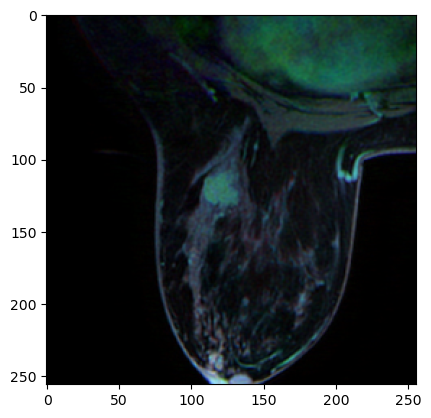

showing 11


<Figure size 640x480 with 0 Axes>

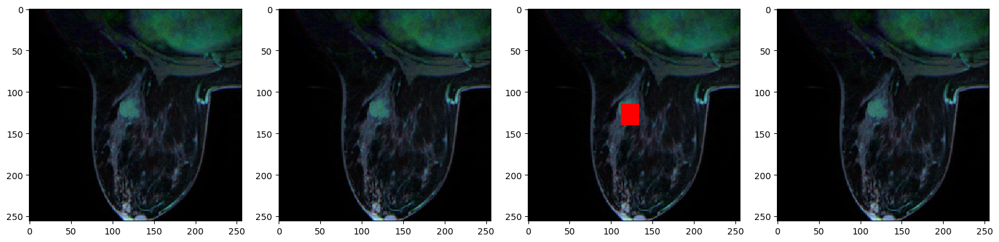

Breast_MRI_583
578 Breast_MRI_583 first last 2 43
70 186 93 163
bbox: 70 93 ---  186 163


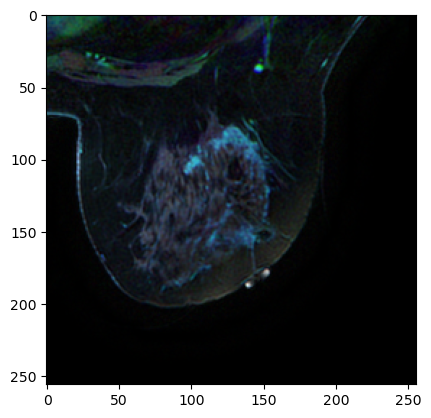

showing 22


<Figure size 640x480 with 0 Axes>

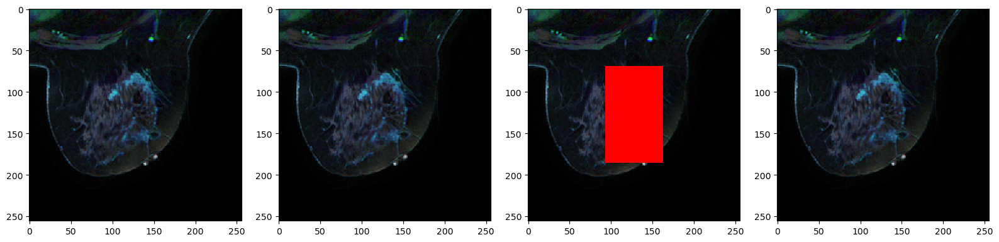

Breast_MRI_874
869 Breast_MRI_874 first last 2 97
46 211 77 185
bbox: 46 77 ---  211 185


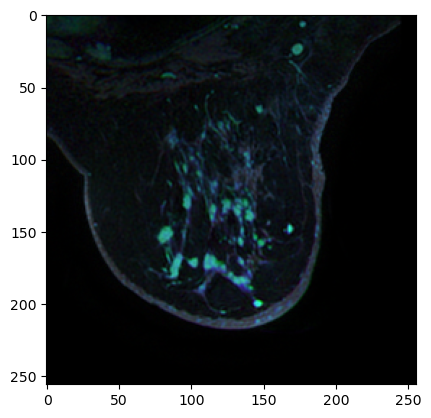

showing 49


<Figure size 640x480 with 0 Axes>

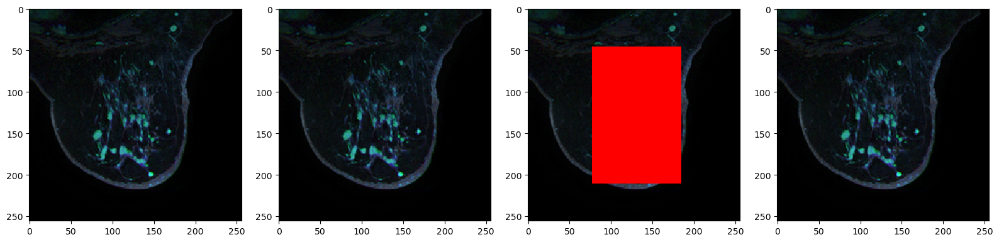

Breast_MRI_887
882 Breast_MRI_887 first last 2 35
78 179 104 174
bbox: 78 104 ---  179 174


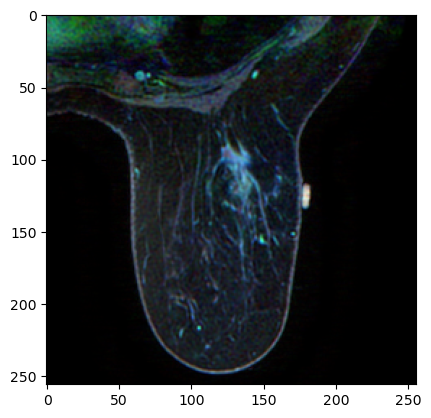

showing 18


<Figure size 640x480 with 0 Axes>

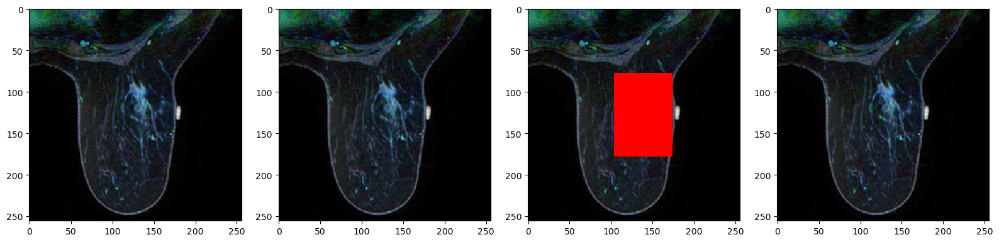

Breast_MRI_471
467 Breast_MRI_471 first last 2 11
118 138 119 135
bbox: 118 119 ---  138 135


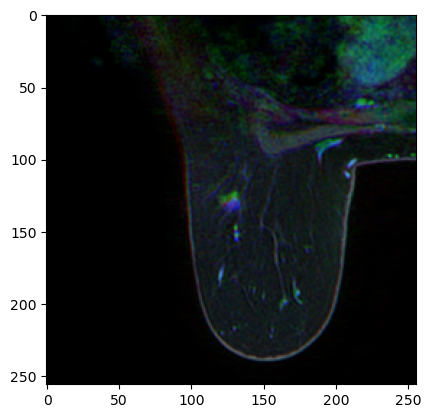

showing 6


<Figure size 640x480 with 0 Axes>

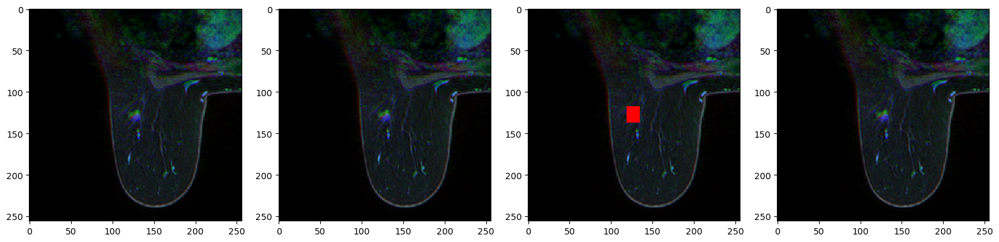

In [472]:
for i,row in df_min[df_min.dataset=='duke'].sample(5).iterrows():

        r=row
        pid = r['pid']
        #if r['n_xy']<=256: continue
            
        
        #if pid not in pp: continue
        print(pid)    
        f =  max(int(row['mask_start']),0)
        l = min(int(row['mask_end'])+1, int(row['n_z']))
        print(i,pid,'first last', f,l)


        preds=[]
        prdm=[]
        prdmed=[]
        
        y_min = int(row['scol'])
        y_max = int(row['ecol'])
        x_min = int(row['sraw'])
        x_max = int(row['eraw'])
        print(x_min,x_max,y_min,y_max)
        

        print('bbox:',x_min, y_min,'--- ', x_max, y_max)

        a0=ds.get_nifti_acquisition(pid, idx=0)
        i1 = int(row['post_early'])
        i2 = int(row['post_late'])
        i0=0
        a1=ds.get_nifti_acquisition(pid, idx=i1)
        a2=ds.get_nifti_acquisition(pid, idx=i2)

        
        for k in range(f,l,1):
            if deb and k == (f + l) // 2:
                    #imname = get_jpg_im(pid, k, abc=0)
                    #im = Image.open(imname)
                    im=ds.minmax(np.stack([a0[k],a1[k],a2[k]], axis=2))
                    w,h=im.shape[:2]
                    plt.imshow(im)
                    plt.show()

                    #if 1: # w>256:
                    # crop around tumor
                    cropped = im.copy() #crop_around_bbox(im, x_min, y_min, x_max, y_max)

                    print('showing',k)
                    # convert to numpy for manipulation
                    im_np = np.array(im)
                    h, w = im_np.shape[:2]

                    # binary mask
                    imb = np.zeros((h, w))
                    imb[x_min:x_max,y_min:y_max] = 1

                    # red overlay on bbox area
                    imbb = im_np.copy()
                    imbb[x_min:x_max,y_min:y_max,  0] = 1  # red channel
                    imbb[x_min:x_max,y_min:y_max, 1:] = 0   # zero green/blue

                    
                    if deb:
                        ds.show_n_images([im_np, im, imbb, cropped], axis_off=False)
                    im = cropped
                    break
            
        

In [468]:
for k in range(f,l,1):
            print(k)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25


In [380]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982 entries, 0 to 981
Data columns (total 57 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   pid                982 non-null    object 
 1   Arm                982 non-null    object 
 2   HR                 982 non-null    int64  
 3   HER2               982 non-null    int64  
 4   MP                 982 non-null    int64  
 5   pCR                982 non-null    int64  
 6   age                979 non-null    float64
 7   Race               979 non-null    object 
 8   menopausal_status  895 non-null    object 
 9   e_hispanic_latino  981 non-null    float64
 10  Arm_split          982 non-null    object 
 11  ABT 888            982 non-null    int64  
 12  AMG 386            982 non-null    int64  
 13  Carboplatin        982 non-null    int64  
 14  Ganetespib         982 non-null    int64  
 15  Ganitumab          982 non-null    int64  
 16  MK-2206            982 non

In [374]:
deb=1

ACRIN-6698-378885
69 ACRIN-6698-378885 first last 55 81
135 239 266 318
bbox: 135 266 ---  239 318


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


<Figure size 640x480 with 0 Axes>

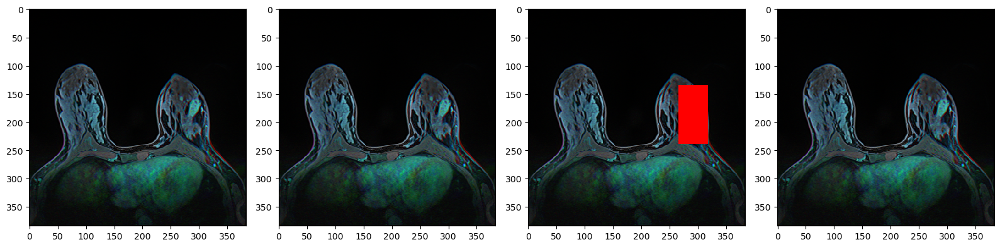

ISPY2-197942
490 ISPY2-197942 first last 27 61
106 180 44 107
bbox: 106 44 ---  180 107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


<Figure size 640x480 with 0 Axes>

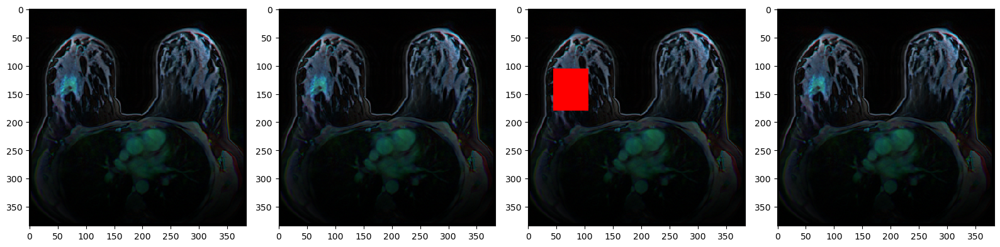

ISPY2-112606
974 ISPY2-112606 first last 60 118
141 197 288 335
bbox: 141 288 ---  197 335


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


<Figure size 640x480 with 0 Axes>

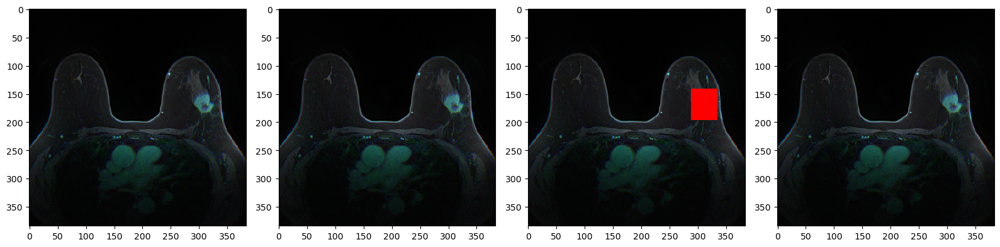

In [379]:
for i,row in df.iterrows():

        r=row
        pid = r['pid']
        #if r['n_xy']<=256: continue
            
        
        if pid not in pp: continue
        print(pid)    
        f =  max(int(row['mask_start']),0)
        l = min(int(row['mask_end'])+1, int(row['n_z']))
        print(i,pid,'first last', f,l)


        preds=[]
        prdm=[]
        prdmed=[]
        
        y_min = int(row['scol'])
        y_max = int(row['ecol'])
        x_min = int(row['sraw'])
        x_max = int(row['eraw'])
        print(x_min,x_max,y_min,y_max)
        '''if pid=='ACRIN-6698-378885':
            x_min = int(row['scol'])-(380-256)
            x_max = int(row['ecol'])-(380-256)
            y_min = int(row['sraw'])
            y_max = int(row['eraw'])'''

        print('bbox:',x_min, y_min,'--- ', x_max, y_max)

        a0=ds.get_nifti_acquisition(pid, idx=0)
        i1 = int(row['post_early'])
        i2 = int(row['post_late'])
        i0=0
        a1=ds.get_nifti_acquisition(pid, idx=i1)
        a2=ds.get_nifti_acquisition(pid, idx=i2)

        fo=1
        for k in range(f,l,1):

            #imname = get_jpg_im(pid, k, abc=0)
            #im = Image.open(imname)
            im=ds.minmax(np.stack([a0[k],a1[k],a2[k]], axis=2))
            w,h=im.shape[:2]

            if w>256:
                # crop around tumor
                cropped = im.copy() #crop_around_bbox(im, x_min, y_min, x_max, y_max)
                if deb and k == (f + l) // 2:
                    # convert to numpy for manipulation
                    im_np = np.array(im)
                    h, w = im_np.shape[:2]

                    # binary mask
                    imb = np.zeros((h, w))
                    imb[x_min:x_max,y_min:y_max] = 1

                    # red overlay on bbox area
                    imbb = im_np.copy()
                    imbb[x_min:x_max,y_min:y_max,  0] = 255  # red channel
                    imbb[x_min:x_max,y_min:y_max, 1:] = 0   # zero green/blue

                    
                    if deb:
                        ds.show_n_images([im_np, im, imbb, cropped], axis_off=False)
                    im = cropped

In [368]:
pp=['ISPY2-515284', 'ACRIN-6698-378885']

In [ ]:
ISPY2-515284
44 ISPY2-515284 first last 36 79
175 222 31 83
bbox: 175 31 ---  222 83

ACRIN-6698-378885
69 ACRIN-6698-378885 first last 55 81
135 239 266 318
bbox: 142 135 ---  194 239



In [330]:
df_crop[df_crop.n_xy<256]

,pid,HR,HER2,pCR,age,race_white,race_black,menopause,HER2pos,HRposHER2neg,...,eraw,scol,ecol,test,crop_mask_start,crop_mask_end,crop_sraw,crop_eraw,crop_scol,crop_ecol


In [331]:
df_crop[df_crop.pid=='ISPY2-570685'].T

,108
pid,ISPY2-570685
HR,1
HER2,1
pCR,0
age,70.0
race_white,0.0
race_black,1.0
menopause,1.0
HER2pos,1
HRposHER2neg,0


In [288]:
    #if min_duke:

    # Iterate through DataFrame rows
    for i, row in df.iterrows():

            
        pid =  row['pid']
        r=row    
        print(i,row['pid'],row['mask_start'],row['mask_end'])
        if pid not in pp: continue
            
        
        
        i0=int(r['pre'])

        if row['n_times']==4:
            i1=1
            i2=2
            i3=3
            i4=3
        else:
            if int(r['post_early'])==1:
                i1=1
                i2=2
            elif r['post_early']==2:
                i1=1
                i2=2
            i4= int(r['post_late']  )
            x=(i2+i4)//2 
    
            if x!=i2 and x!=i4:
               i3=x
            else:
               print('+++++++++++', pid,i0,i1,i2,i3,i4,r['n_times'] )
               break

        print(i0,i1,i2,i3,i4,r['n_times'])
        df_crop.at[i, 'i0']=i0
        df_crop.at[i, 'i1']=i1
        df_crop.at[i, 'i2']=i2
        df_crop.at[i, 'i3']=i3
        df_crop.at[i, 'i4']=i4
        
        
        startm=int(row['mask_start'])
        endm=int(row['mask_end'])
        
        sraw=int(row['sraw'])
        eraw=int(row['eraw'])

        scol=int(row['scol'])
        ecol=int(row['ecol'])
        
        a=ds.get_nifti_acquisitions(pid)
        assert(len(a)==int(r['n_times']))
        
        
        
        if a is not None:
            if row['n_z'] is not None:
                z=int(row['n_z'])
                assert(a[0].shape[0]==z)
            else:
                df_crop.at[i,'org_n_z']=a[0].shape[0]
                print('===correct n_z of ',pid,' to ',a0.shape[0])
        else:
            print('a is none')
            continue
            
        w=int(row['n_xy'])
        
        
        assert(a[0].shape[1]==w)
        assert(a[0].shape[2]==w)
        
        print(i, '---',pid,a[0].shape)
        
        voi = [(startm,endm),(sraw,eraw),(scol,ecol)] 
        crop_coords = crop_around_voi_cords(a[0].shape, voi, slice_padding=1, output_size=256)
        print('crop_coords', crop_coords)
        print('new ',voi)

        df_crop.at[i, 'crop_mask_start']=crop_coords[0]
        df_crop.at[i, 'crop_mask_end']=crop_coords[1]
        df_crop.at[i, 'crop_sraw']=crop_coords[2]
        df_crop.at[i, 'crop_eraw']=crop_coords[3]
        df_crop.at[i, 'crop_scol']=crop_coords[4]
        df_crop.at[i, 'crop_ecol']=crop_coords[5]

        # Calculate New variables
        df_crop.at[i,'mask_start'] = startm-crop_coords[0]
        df_crop.at[i,'mask_end'] = endm-crop_coords[0]
        df_crop.at[i,'sraw'] = sraw-crop_coords[2]
        df_crop.at[i,'eraw'] = eraw-crop_coords[2]
        df_crop.at[i,'scol'] = scol-crop_coords[4]
        df_crop.at[i,'ecol'] = ecol-crop_coords[4]
    
        assert(df.at[i,'mask_start']-crop_coords[0]>=0) 
        assert(df.at[i,'mask_end']-crop_coords[0]>=0) 
        assert(df.at[i,'sraw']-crop_coords[2]>=0) 
        assert( df.at[i,'eraw']-crop_coords[2]>=0) 
        assert(df.at[i,'scol']-crop_coords[4]>=0) 
        assert(df.at[i,'ecol']-crop_coords[4]>=0) 

        if r['n_xy']>256:
            c=[]
            for jj in [i0,i1,i2,i3,i4]:
                x=crop_with_same_coordinates(a[jj], crop_coords)
                c.append(x)
            c=np.array(c)
            print('result ',pid,c.shape)
            
        else:
            
            c=[]
            crop_coords=np.array(crop_coords)
            crop_coords[2]=0
            crop_coords[3]=255
            crop_coords[4]=0
            crop_coords[5]=255
            for jj in [i0,i1,i2,i3,i4]:
                   vv=[]
                   for h in range(a[jj].shape[0]):
                       img=a[jj][h]
                       if a[jj][h].shape[0]<256:
                           img = cv2.resize(a[jj][h], (256, 256), interpolation=cv2.INTER_AREA) 
                        
                       vv.append(img)
                   vv=np.array(vv)
                   c.append(vv)
            c=np.array(c)
            print('result ',pid,c.shape)
                
        fn = pid+'_spy2_aqc_crop5.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),c)
        print('saving:',os.path.join(fpath, fn))

        df_crop.at[i,'n_xy'] = 256
        df_crop.at[i,'n_z'] = c[0].shape[0]
        for kk in range(5):
            x=c[kk].max()
            y=len(set(c[kk].flatten()))
            df_crop.at[i, 'mx_'+str(kk)]=x
            df_crop.at[i, 'nuq_'+str(kk)]=y
        df_crop.to_csv('C:\\Users\\naomi\\Downloads\\breast_mri\\SPY2\\df_spy2_crop5.csv', index = False)  

0 ISPY2-756412 3.0 46.0
1 ISPY2-111881 68.0 105.0
2 ISPY2-451816 17.0 64.0
3 ISPY2-243836 9.0 27.0
4 ISPY2-402265 47.0 116.0
5 ISPY2-611662 15.0 41.0
6 ISPY2-139137 43.0 126.0
7 ISPY2-685753 32.0 49.0
8 ISPY2-627981 82.0 128.0
9 ISPY2-108939 49.0 75.0
10 ISPY2-629210 6.0 61.0
11 ISPY2-809037 36.0 55.0
12 ACRIN-6698-107700 23.0 46.0
13 ISPY2-373672 53.0 123.0
14 ISPY2-615873 42.0 100.0
15 ISPY2-607047 27.0 105.0
16 ISPY2-155171 11.0 120.0
17 ISPY2-815421 16.0 51.0
18 ISPY2-609897 35.0 50.0
19 ISPY2-605713 20.0 74.0
20 ISPY2-246134 53.0 99.0
21 ACRIN-6698-373346 30.0 60.0
22 ISPY2-349225 14.0 74.0
23 ISPY2-208265 61.0 131.0
24 ISPY2-395076 27.0 58.0
25 ISPY2-637752 55.0 119.0
26 ISPY2-331192 42.0 105.0
27 ISPY2-327133 12.0 134.0
28 ISPY2-541165 14.0 39.0
29 ISPY2-802778 12.0 26.0
30 ISPY2-794428 23.0 56.0
31 ISPY2-625800 3.0 56.0
32 ISPY2-422450 62.0 104.0
33 ISPY2-613188 15.0 29.0
34 ISPY2-159284 1.0 57.0
35 ACRIN-6698-641977 52.0 72.0
36 ACRIN-6698-326433 71.0 102.0
37 ISPY2-539876 36.

last acquisition 4
22 --- Breast_MRI_023 (192, 448, 448)
crop_coords (91, 117, 6, 261, 191, 446)
new  [(93, 115), (114, 155), (340, 369)]
result  Breast_MRI_023 (4, 27, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_023_duke_aqc_crop5.nii.gz
23 Breast_MRI_024 89.0 94.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_024_duke_aqc_0.nii.gz
last acquisition 4
23 --- Breast_MRI_024 (180, 512, 512)
crop_coords (87, 96, 255, 510, 74, 329)
new  [(89, 94), (391, 398), (198, 206)]
result  Breast_MRI_024 (4, 10, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_024_duke_aqc_crop5.nii.gz
24 Breast_MRI_025 29.0 46.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_025_duke_aqc_0.nii.gz
last acquisition 4
24 --- Breast_MRI_025 (156, 512, 512)
crop_coords (27, 48, 109, 364, 0, 255)
new  [(29, 46), (223, 252), (69, 94)]
result  Breast_MRI_025 (4, 22, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_025_

last acquisition 4
44 --- Breast_MRI_045 (188, 512, 512)
crop_coords (48, 84, 192, 447, 31, 286)
new  [(50, 82), (288, 352), (128, 190)]
result  Breast_MRI_045 (4, 37, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_045_duke_aqc_crop5.nii.gz
45 Breast_MRI_046 102.0 190.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_046_duke_aqc_0.nii.gz
last acquisition 4
45 --- Breast_MRI_046 (256, 448, 448)
crop_coords (100, 192, 24, 279, 0, 255)
new  [(102, 190), (99, 205), (77, 162)]
result  Breast_MRI_046 (4, 93, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_046_duke_aqc_crop5.nii.gz
46 Breast_MRI_047 61.0 94.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_047_duke_aqc_0.nii.gz
last acquisition 4
46 --- Breast_MRI_047 (160, 512, 512)
crop_coords (59, 96, 239, 494, 11, 266)
new  [(61, 94), (336, 398), (116, 163)]
result  Breast_MRI_047 (4, 38, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_

last acquisition 5
66 --- Breast_MRI_067 (160, 448, 448)
crop_coords (53, 71, 38, 293, 191, 446)
new  [(55, 69), (152, 181), (365, 387)]
result  Breast_MRI_067 (5, 19, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_067_duke_aqc_crop5.nii.gz
67 Breast_MRI_068 72.0 117.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_068_duke_aqc_0.nii.gz
last acquisition 5
67 --- Breast_MRI_068 (186, 512, 512)
crop_coords (70, 119, 218, 473, 0, 255)
new  [(72, 117), (288, 404), (79, 138)]
result  Breast_MRI_068 (5, 50, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_068_duke_aqc_crop5.nii.gz
68 Breast_MRI_069 114.0 130.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_069_duke_aqc_0.nii.gz
last acquisition 5
68 --- Breast_MRI_069 (196, 512, 512)
crop_coords (112, 132, 194, 449, 217, 472)
new  [(114, 130), (309, 335), (327, 364)]
result  Breast_MRI_069 (5, 21, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breas

last acquisition 4
88 --- Breast_MRI_089 (176, 512, 512)
crop_coords (128, 162, 161, 416, 255, 510)
new  [(130, 160), (231, 348), (391, 447)]
result  Breast_MRI_089 (4, 35, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_089_duke_aqc_crop5.nii.gz
89 Breast_MRI_090 46.0 164.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_090_duke_aqc_0.nii.gz
last acquisition 4
89 --- Breast_MRI_090 (196, 512, 512)
crop_coords (44, 166, 204, 459, 240, 495)
new  [(46, 164), (274, 391), (306, 430)]
result  Breast_MRI_090 (4, 123, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_090_duke_aqc_crop5.nii.gz
90 Breast_MRI_091 73.0 118.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_091_duke_aqc_0.nii.gz
last acquisition 5
90 --- Breast_MRI_091 (160, 448, 448)
crop_coords (71, 120, 66, 321, 191, 446)
new  [(73, 118), (156, 233), (289, 374)]
result  Breast_MRI_091 (5, 50, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\

last acquisition 4
110 --- Breast_MRI_111 (144, 512, 512)
crop_coords (39, 53, 132, 387, 0, 255)
new  [(41, 51), (254, 267), (115, 127)]
result  Breast_MRI_111 (4, 15, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_111_duke_aqc_crop5.nii.gz
111 Breast_MRI_112 98.0 111.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_112_duke_aqc_0.nii.gz
last acquisition 5
111 --- Breast_MRI_112 (160, 320, 320)
crop_coords (96, 113, 0, 255, 63, 318)
new  [(98, 111), (92, 127), (180, 204)]
result  Breast_MRI_112 (5, 18, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_112_duke_aqc_crop5.nii.gz
112 Breast_MRI_113 30.0 35.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_113_duke_aqc_0.nii.gz
last acquisition 5
112 --- Breast_MRI_113 (166, 512, 512)
crop_coords (28, 37, 201, 456, 236, 491)
new  [(30, 35), (322, 337), (357, 371)]
result  Breast_MRI_113 (5, 10, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_M

last acquisition 5
132 --- Breast_MRI_133 (142, 512, 512)
crop_coords (79, 95, 241, 496, 247, 502)
new  [(81, 93), (356, 383), (363, 388)]
result  Breast_MRI_133 (5, 17, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_133_duke_aqc_crop5.nii.gz
133 Breast_MRI_134 22.0 47.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_134_duke_aqc_0.nii.gz
last acquisition 5
133 --- Breast_MRI_134 (142, 512, 512)
crop_coords (20, 49, 191, 446, 15, 270)
new  [(22, 47), (304, 335), (130, 156)]
result  Breast_MRI_134 (5, 30, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_134_duke_aqc_crop5.nii.gz
134 Breast_MRI_135 53.0 80.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_135_duke_aqc_0.nii.gz
last acquisition 5
134 --- Breast_MRI_135 (176, 512, 512)
crop_coords (51, 82, 166, 421, 33, 288)
new  [(53, 80), (275, 313), (140, 183)]
result  Breast_MRI_135 (5, 32, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_

last acquisition 5
154 --- Breast_MRI_155 (192, 512, 512)
crop_coords (70, 95, 225, 480, 245, 500)
new  [(72, 93), (327, 380), (355, 392)]
result  Breast_MRI_155 (5, 26, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_155_duke_aqc_crop5.nii.gz
155 Breast_MRI_156 18.0 62.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_156_duke_aqc_0.nii.gz
last acquisition 4
155 --- Breast_MRI_156 (160, 448, 448)
crop_coords (16, 64, 63, 318, 0, 255)
new  [(18, 62), (175, 207), (91, 149)]
result  Breast_MRI_156 (4, 49, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_156_duke_aqc_crop5.nii.gz
156 Breast_MRI_157 101.0 141.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_157_duke_aqc_0.nii.gz
last acquisition 4
156 --- Breast_MRI_157 (176, 448, 448)
crop_coords (99, 143, 92, 347, 20, 275)
new  [(101, 141), (195, 245), (124, 173)]
result  Breast_MRI_157 (4, 45, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast

last acquisition 4
176 --- Breast_MRI_177 (192, 448, 448)
crop_coords (83, 102, 5, 260, 191, 446)
new  [(85, 100), (119, 148), (311, 332)]
result  Breast_MRI_177 (4, 20, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_177_duke_aqc_crop5.nii.gz
177 Breast_MRI_178 74.0 105.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_178_duke_aqc_0.nii.gz
last acquisition 4
177 --- Breast_MRI_178 (200, 512, 512)
crop_coords (72, 107, 195, 450, 217, 472)
new  [(74, 105), (287, 360), (316, 375)]
result  Breast_MRI_178 (4, 36, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_178_duke_aqc_crop5.nii.gz
178 Breast_MRI_179 99.0 123.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_179_duke_aqc_0.nii.gz
last acquisition 5
178 --- Breast_MRI_179 (196, 512, 512)
crop_coords (97, 125, 138, 393, 255, 510)
new  [(99, 123), (221, 312), (360, 406)]
result  Breast_MRI_179 (5, 29, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5

last acquisition 4
198 --- Breast_MRI_199 (176, 512, 512)
crop_coords (69, 92, 172, 427, 204, 459)
new  [(71, 90), (285, 316), (314, 350)]
result  Breast_MRI_199 (4, 24, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_199_duke_aqc_crop5.nii.gz
199 Breast_MRI_200 44.0 87.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_200_duke_aqc_0.nii.gz
last acquisition 4
199 --- Breast_MRI_200 (144, 320, 320)
crop_coords (42, 89, 0, 255, 0, 255)
new  [(44, 87), (86, 150), (73, 126)]
result  Breast_MRI_200 (4, 48, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_200_duke_aqc_crop5.nii.gz
200 Breast_MRI_201 96.0 115.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_201_duke_aqc_0.nii.gz
last acquisition 4
200 --- Breast_MRI_201 (176, 448, 448)
crop_coords (94, 117, 23, 278, 0, 255)
new  [(96, 115), (136, 166), (72, 103)]
result  Breast_MRI_201 (4, 24, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_2

last acquisition 4
220 --- Breast_MRI_221 (240, 448, 448)
crop_coords (84, 127, 64, 319, 0, 255)
new  [(86, 125), (162, 222), (90, 130)]
result  Breast_MRI_221 (4, 44, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_221_duke_aqc_crop5.nii.gz
221 Breast_MRI_222 101.0 147.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_222_duke_aqc_0.nii.gz
last acquisition 5
221 --- Breast_MRI_222 (192, 512, 512)
crop_coords (99, 149, 118, 373, 8, 263)
new  [(101, 147), (213, 280), (106, 166)]
result  Breast_MRI_222 (5, 51, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_222_duke_aqc_crop5.nii.gz
222 Breast_MRI_223 95.0 114.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_223_duke_aqc_0.nii.gz
last acquisition 4
222 --- Breast_MRI_223 (192, 448, 448)
crop_coords (93, 116, 0, 255, 191, 446)
new  [(95, 114), (116, 138), (319, 344)]
result  Breast_MRI_223 (4, 24, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Bre

last acquisition 5
242 --- Breast_MRI_243 (192, 512, 512)
crop_coords (110, 127, 192, 447, 0, 255)
new  [(112, 125), (305, 336), (117, 139)]
result  Breast_MRI_243 (5, 18, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_243_duke_aqc_crop5.nii.gz
243 Breast_MRI_244 45.0 73.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_244_duke_aqc_0.nii.gz
last acquisition 5
243 --- Breast_MRI_244 (156, 512, 512)
crop_coords (43, 75, 140, 395, 255, 510)
new  [(45, 73), (252, 284), (394, 429)]
result  Breast_MRI_244 (5, 33, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_244_duke_aqc_crop5.nii.gz
244 Breast_MRI_245 73.0 100.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_245_duke_aqc_0.nii.gz
last acquisition 5
244 --- Breast_MRI_245 (154, 512, 512)
crop_coords (71, 102, 255, 510, 255, 510)
new  [(73, 100), (367, 405), (420, 462)]
result  Breast_MRI_245 (5, 32, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\

saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_265_duke_aqc_crop5.nii.gz
265 Breast_MRI_266 93.0 126.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_266_duke_aqc_0.nii.gz
last acquisition 5
265 --- Breast_MRI_266 (160, 448, 448)
crop_coords (91, 128, 106, 361, 0, 255)
new  [(93, 126), (175, 293), (70, 154)]
result  Breast_MRI_266 (5, 38, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_266_duke_aqc_crop5.nii.gz
266 Breast_MRI_267 87.0 104.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_267_duke_aqc_0.nii.gz
last acquisition 4
266 --- Breast_MRI_267 (160, 512, 512)
crop_coords (85, 106, 219, 474, 0, 255)
new  [(87, 104), (322, 372), (86, 123)]
result  Breast_MRI_267 (4, 22, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_267_duke_aqc_crop5.nii.gz
267 Breast_MRI_268 21.0 58.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_268_duke_aqc_0.nii.gz
last acquisition 4
267 --- Breast_MRI_268 (160

last acquisition 4
287 --- Breast_MRI_288 (208, 448, 448)
crop_coords (69, 84, 86, 341, 0, 255)
new  [(71, 82), (204, 224), (89, 108)]
result  Breast_MRI_288 (4, 16, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_288_duke_aqc_crop5.nii.gz
288 Breast_MRI_289 36.0 47.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_289_duke_aqc_0.nii.gz
last acquisition 4
288 --- Breast_MRI_289 (138, 512, 512)
crop_coords (34, 49, 186, 441, 217, 472)
new  [(36, 47), (297, 331), (327, 364)]
result  Breast_MRI_289 (4, 16, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_289_duke_aqc_crop5.nii.gz
289 Breast_MRI_290 95.0 111.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_290_duke_aqc_0.nii.gz
last acquisition 4
289 --- Breast_MRI_290 (224, 448, 448)
crop_coords (93, 113, 0, 255, 179, 434)
new  [(95, 111), (115, 142), (297, 318)]
result  Breast_MRI_290 (4, 21, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_M

last acquisition 5
309 --- Breast_MRI_310 (170, 512, 512)
crop_coords (25, 49, 255, 510, 0, 255)
new  [(27, 47), (375, 414), (93, 125)]
result  Breast_MRI_310 (5, 25, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_310_duke_aqc_crop5.nii.gz
310 Breast_MRI_311 111.0 124.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_311_duke_aqc_0.nii.gz
last acquisition 4
310 --- Breast_MRI_311 (174, 512, 512)
crop_coords (109, 126, 203, 458, 0, 255)
new  [(111, 124), (320, 343), (102, 128)]
result  Breast_MRI_311 (4, 18, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_311_duke_aqc_crop5.nii.gz
311 Breast_MRI_312 91.0 107.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_312_duke_aqc_0.nii.gz
last acquisition 4
311 --- Breast_MRI_312 (160, 512, 512)
crop_coords (89, 109, 151, 406, 255, 510)
new  [(91, 107), (269, 290), (375, 397)]
result  Breast_MRI_312 (4, 21, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\B

last acquisition 5
331 --- Breast_MRI_332 (192, 512, 512)
crop_coords (71, 97, 189, 444, 218, 473)
new  [(73, 95), (299, 335), (327, 366)]
result  Breast_MRI_332 (5, 27, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_332_duke_aqc_crop5.nii.gz
332 Breast_MRI_333 92.0 106.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_333_duke_aqc_0.nii.gz
last acquisition 5
332 --- Breast_MRI_333 (156, 512, 512)
crop_coords (90, 108, 169, 424, 221, 476)
new  [(92, 106), (283, 312), (331, 368)]
result  Breast_MRI_333 (5, 19, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_333_duke_aqc_crop5.nii.gz
333 Breast_MRI_334 30.0 42.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_334_duke_aqc_0.nii.gz
last acquisition 5
333 --- Breast_MRI_334 (166, 512, 512)
crop_coords (28, 44, 148, 403, 7, 262)
new  [(30, 42), (266, 287), (123, 147)]
result  Breast_MRI_334 (5, 17, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Brea

last acquisition 4
353 --- Breast_MRI_354 (196, 512, 512)
crop_coords (87, 115, 208, 463, 8, 263)
new  [(89, 113), (323, 349), (117, 156)]
result  Breast_MRI_354 (4, 29, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_354_duke_aqc_crop5.nii.gz
354 Breast_MRI_355 86.0 97.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_355_duke_aqc_0.nii.gz
last acquisition 4
354 --- Breast_MRI_355 (144, 512, 512)
crop_coords (84, 99, 249, 504, 17, 272)
new  [(86, 97), (357, 397), (131, 159)]
result  Breast_MRI_355 (4, 16, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_355_duke_aqc_crop5.nii.gz
355 Breast_MRI_356 63.0 127.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_356_duke_aqc_0.nii.gz
last acquisition 5
355 --- Breast_MRI_356 (160, 448, 448)
crop_coords (61, 129, 106, 361, 191, 446)
new  [(63, 127), (196, 273), (325, 388)]
result  Breast_MRI_356 (5, 69, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Bre

last acquisition 5
375 --- Breast_MRI_376 (128, 448, 448)
crop_coords (40, 57, 75, 330, 191, 446)
new  [(42, 55), (190, 216), (354, 382)]
result  Breast_MRI_376 (5, 18, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_376_duke_aqc_crop5.nii.gz
376 Breast_MRI_377 72.0 91.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_377_duke_aqc_0.nii.gz
last acquisition 4
376 --- Breast_MRI_377 (176, 512, 512)
crop_coords (70, 93, 194, 449, 32, 287)
new  [(72, 91), (307, 338), (142, 178)]
result  Breast_MRI_377 (4, 24, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_377_duke_aqc_crop5.nii.gz
377 Breast_MRI_378 43.0 82.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_378_duke_aqc_0.nii.gz
last acquisition 5
377 --- Breast_MRI_378 (156, 512, 512)
crop_coords (41, 84, 162, 417, 1, 256)
new  [(43, 82), (262, 318), (106, 152)]
result  Breast_MRI_378 (5, 44, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MR

last acquisition 4
397 --- Breast_MRI_398 (144, 448, 448)
crop_coords (89, 109, 73, 328, 0, 255)
new  [(91, 107), (189, 214), (58, 87)]
result  Breast_MRI_398 (4, 21, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_398_duke_aqc_crop5.nii.gz
398 Breast_MRI_399 68.0 86.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_399_duke_aqc_0.nii.gz
last acquisition 5
398 --- Breast_MRI_399 (152, 512, 512)
crop_coords (66, 88, 196, 451, 16, 271)
new  [(68, 86), (306, 342), (131, 158)]
result  Breast_MRI_399 (5, 23, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_399_duke_aqc_crop5.nii.gz
399 Breast_MRI_400 33.0 88.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_400_duke_aqc_0.nii.gz
last acquisition 5
399 --- Breast_MRI_400 (158, 512, 512)
crop_coords (31, 90, 179, 434, 73, 328)
new  [(33, 88), (271, 344), (164, 239)]
result  Breast_MRI_400 (5, 60, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI

last acquisition 4
419 --- Breast_MRI_420 (160, 320, 320)
crop_coords (59, 144, 0, 255, 0, 255)
new  [(61, 142), (50, 127), (71, 142)]
result  Breast_MRI_420 (4, 86, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_420_duke_aqc_crop5.nii.gz
420 Breast_MRI_421 61.0 91.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_421_duke_aqc_0.nii.gz
last acquisition 4
420 --- Breast_MRI_421 (174, 512, 512)
crop_coords (59, 93, 197, 452, 255, 510)
new  [(61, 91), (280, 370), (357, 482)]
result  Breast_MRI_421 (4, 35, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_421_duke_aqc_crop5.nii.gz
421 Breast_MRI_422 126.0 139.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_422_duke_aqc_0.nii.gz
last acquisition 5
421 --- Breast_MRI_422 (192, 512, 512)
crop_coords (124, 141, 214, 469, 53, 308)
new  [(126, 139), (328, 357), (168, 195)]
result  Breast_MRI_422 (5, 18, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Brea

last acquisition 5
441 --- Breast_MRI_442 (154, 512, 512)
crop_coords (47, 67, 159, 414, 44, 299)
new  [(49, 65), (263, 311), (152, 193)]
result  Breast_MRI_442 (5, 21, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_442_duke_aqc_crop5.nii.gz
442 Breast_MRI_443 36.0 55.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_443_duke_aqc_0.nii.gz
last acquisition 4
442 --- Breast_MRI_443 (176, 512, 512)
crop_coords (34, 57, 154, 409, 21, 276)
new  [(36, 55), (263, 302), (130, 168)]
result  Breast_MRI_443 (4, 24, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_443_duke_aqc_crop5.nii.gz
443 Breast_MRI_444 71.0 101.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_444_duke_aqc_0.nii.gz
last acquisition 4
443 --- Breast_MRI_444 (176, 512, 512)
crop_coords (69, 103, 210, 465, 249, 504)
new  [(71, 101), (307, 370), (346, 408)]
result  Breast_MRI_444 (4, 35, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Brea

last acquisition 5
463 --- Breast_MRI_464 (160, 448, 448)
crop_coords (93, 130, 97, 352, 0, 255)
new  [(95, 128), (195, 255), (70, 125)]
result  Breast_MRI_464 (5, 38, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_464_duke_aqc_crop5.nii.gz
464 Breast_MRI_465 82.0 99.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_465_duke_aqc_0.nii.gz
last acquisition 4
464 --- Breast_MRI_465 (180, 512, 512)
crop_coords (80, 101, 123, 378, 0, 255)
new  [(82, 99), (236, 266), (97, 135)]
result  Breast_MRI_465 (4, 22, 256, 256)
saving: C:\Users\naomi\Downloads\breast_mri\duke\min_dce_5\Breast_MRI_465_duke_aqc_crop5.nii.gz
465 Breast_MRI_466 98.0 127.0
loading G:\My Drive\breast_mri\DUKE\dce\Breast_MRI_466_duke_aqc_0.nii.gz


In [ ]:
Epoch 1, Batch 0, Loss: 0.6903
ISPY1_1212 6
ISPY1_1104 6
Epoch 1, Batch 50, Loss: 0.6365
ISPY1_1104 6
ISPY1_1104 6
ISPY1_1184 6
ISPY1_1228 6
ISPY1_1228 6
Epoch 1, Batch 100, Loss: 0.6575
ISPY1_1184 6
ISPY1_1104 6
ISPY1_1212 6
ISPY1_1212 6
ISPY1_1215 6
ISPY1_1228 6
ISPY1_1124 6
ISPY1_1215 6
ISPY1_1184 6
Epoch 1, Batch 150, Loss: 0.6929
ISPY1_1104 6
ISPY1_1104 6
ISPY1_1124 6
ISPY1_1104 6
ISPY1_1184 6
Epoch 1, Batch 200, Loss: 0.7377
ISPY1_1215 6

In [174]:
    # Iterate through DataFrame rows
    for i, row in df.iterrows():
            
        pid =  row['pid']
        print('==========', pid)
        r=row  
        fn = pid+'_spy2_aqc_crop5.nii.gz'
        if not os.path.isfile(os.path.join(fpath, fn)):
            print('no file:',pid, os.path.join(fpath, fn))

========== ISPY2-756412
========== ISPY2-111881
========== ISPY2-451816
========== ISPY2-243836
========== ISPY2-402265
========== ISPY2-611662
========== ISPY2-139137
========== ISPY2-685753
========== ISPY2-627981
========== ISPY2-108939
========== ISPY2-629210
========== ISPY2-809037
========== ACRIN-6698-107700
========== ISPY2-373672
========== ISPY2-615873
========== ISPY2-607047
========== ISPY2-155171
========== ISPY2-815421
========== ISPY2-609897
========== ISPY2-605713
========== ISPY2-246134
========== ACRIN-6698-373346
========== ISPY2-349225
========== ISPY2-208265
========== ISPY2-395076
========== ISPY2-637752
========== ISPY2-331192
========== ISPY2-327133
========== ISPY2-541165
========== ISPY2-802778
========== ISPY2-794428
========== ISPY2-625800
========== ISPY2-422450
========== ISPY2-613188
========== ISPY2-159284
========== ACRIN-6698-641977
========== ACRIN-6698-326433
========== ISPY2-539876
========== ISPY2-109623
========== ISPY2-153327
========== ISPY2-622

In [104]:
import cv2

In [175]:
df_crop.to_csv('C:\\Users\\naomi\\Downloads\\breast_mri\\SPY2\\df_spy2_crop5.csv', index = False)  

<Axes: ylabel='Frequency'>

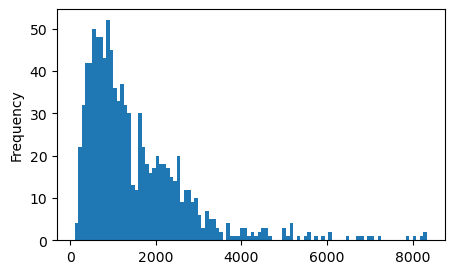

In [176]:
df_crop.mx_0.plot(kind='hist',bins=100,figsize=(5,3))

In [110]:
for i,row in df_crop.iterrows():
    pid=row['pid']
    r=row
    if r['n_xy']>=256:
            continue
    fn = pid+'_spy2_aqc_crop5.nii.gz'
    if not os.path.isfile(os.path.join(fpath, fn)):
        continue
    a = ds.read_niftii(os.path.join(fpath, fn))
    if a is None:
        continue
    print('=======',i,pid,'loading:',os.path.join(fpath, fn), a.shape)
    if a.shape[0]==4:
        b=[a[0],a[1],a[2],a[2],a[3]]
        b=np.array(b)
        a=b
        ds.save_niftii(os.path.join(fpath, fn),b)
        print('saving:',os.path.join(fpath, fn))
        print(b.shape)
        
    if a.shape[0]==3:
        b=[a[0],a[1],a[1],a[2],a[2]]
        b=np.array(b)
        a=b
        ds.save_niftii(os.path.join(fpath, fn),b)
        print('saving:',os.path.join(fpath, fn))
        print(b.shape)
        
    for kk in range(5):
        x=a[kk].max()
        y=len(set(a[kk].flatten()))
        df_crop.at[i, 'mx_'+str(kk)]=x
        df_crop.at[i, 'nuq_'+str(kk)]=y

In [111]:
df_crop.to_csv('C:\\Users\\naomi\\Downloads\\breast_mri\\SPY2\\df_spy2_crop5.csv', index = False)  

In [115]:
df_crop.to_csv('C:\\Users\\naomi\\Downloads\\breast_mri\\df_spy2_crop5.csv', index = False)  

In [ ]:
i

In [64]:
df[df.pid=='ISPY2-756412'][df.columns[-20:]]

,TripleNeg,dataset,HR_HER2_STATUS,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,mask_start,mask_end,mask_count,is_mask,sraw,eraw,scol,ecol,test
0,0,spy2,HRposHER2neg,256.0,76.0,7.0,0.0,2.0,5.0,2.4,0.5469,3.0,46.0,20228.0,1.0,15.0,178.0,46.0,127.0,0.0


In [112]:
len(a),r

(7,
 pid                            ISPY2-960963
 Arm      Paclitaxel + MK-2206 + Trastuzumab
 HR                                        1
 HER2                                      1
 MP                                        0
                         ...                
 nuq_2                                   NaN
 mx_3                                    NaN
 nuq_3                                   NaN
 mx_4                                    NaN
 nuq_4                                   NaN
 Name: 981, Length: 78, dtype: object)

In [366]:
[i0,i1,i2,i3,i4]

[0, 2, 6, 3, 5]

In [367]:
    #if min_duke:

    # Iterate through DataFrame rows
    for i, row in df.iterrows():
        
        pid =  row['pid']
       
        if pid not in ppp +pp : continue
            
        print(i,row['pid'],row['mask_start'],row['mask_end'])
        
        
        startm=int(row['mask_start'])
        endm=int(row['mask_end'])
        
        sraw=int(row['sraw'])
        eraw=int(row['eraw'])

        scol=int(row['scol'])
        ecol=int(row['ecol'])

        a0=ds.get_nifti_acquisition(pid, idx=0)
        
        if a0 is not None:
            if row['n_z'] is not None:
                z=int(row['n_z'])
                assert(a0.shape[0]==z)
            else:
                df_crop.at[i,'org_n_z']=a0.shape[0]
                print('correct n_z of ',pid,' to ',a0.shape[0])
        else:
            continue
            
        w=int(row['n_xy'])
        
        
        assert(a0.shape[1]==w)
        assert(a0.shape[2]==w)
        assert(int(row['post_late'])==int(row['n_times']-1))
        
        print(i, '---',pid,a0.shape)
        voi = [(startm,endm),(sraw,eraw),(scol,ecol)] 
        crop_coords = crop_around_voi_cords(a0.shape, voi, slice_padding=2, output_size=256)
        print(crop_coords)
        
        #(41, 140, 161, 416, 255, 510)
        df_crop.at[i, 'crop_mask_start']=crop_coords[0]
        df_crop.at[i, 'crop_mask_end']=crop_coords[1]
        df_crop.at[i, 'crop_sraw']=crop_coords[2]
        df_crop.at[i, 'crop_eraw']=crop_coords[3]
        df_crop.at[i, 'crop_scol']=crop_coords[4]
        df_crop.at[i, 'crop_ecol']=crop_coords[5]
        r=row
        i1 = int(row['post_early'])
        i2 = int(row['post_late'])
        i0=0
        a1=ds.get_nifti_acquisition(pid, idx=i1)
        a2=ds.get_nifti_acquisition(pid, idx=i2)
        
        ca0 = crop_with_same_coordinates(a0, crop_coords)
        ca1 = crop_with_same_coordinates(a1, crop_coords)
        ca2 = crop_with_same_coordinates(a2, crop_coords)
        c = [ca1,ca1,ca2]
        
        fn = pid+'_duke_aqc_0.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),ca0)
        print('saving:',os.path.join(fpath, fn))
        
        fn = pid+'_duke_aqc_1.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),ca1)
        print('saving:',os.path.join(fpath, fn))
        
        fn = pid+'_duke_aqc_'+str(int(i2))+'.nii.gz'
        ds.save_niftii(os.path.join(fpath, fn),ca2)
        print('saving:',os.path.join(fpath, fn))
        
        print('ser:', i0,i1,i2)  
        # Calculate New variables
        df_crop.at[i,'mask_start'] = startm-crop_coords[0]
        df_crop.at[i,'mask_end'] = endm-crop_coords[0]
        df_crop.at[i,'sraw'] = sraw-crop_coords[2]
        df_crop.at[i,'eraw'] = eraw-crop_coords[2]
        df_crop.at[i,'scol'] = scol-crop_coords[4]
        df_crop.at[i,'ecol'] = ecol-crop_coords[4]
        
        assert(df.at[i,'mask_start']-crop_coords[0]>=0) 
        assert(df.at[i,'mask_end']-crop_coords[0]>=0) 
        assert(df.at[i,'sraw']-crop_coords[2]>=0) 
        assert( df.at[i,'eraw']-crop_coords[2]>=0) 
        assert(df.at[i,'scol']-crop_coords[4]>=0) 
        assert(df.at[i,'ecol']-crop_coords[4]>=0) 
        
        df_crop.at[i,'n_xy'] = 256
        df_crop.at[i,'n_z'] = ca0.shape[0]
        
        

NameError: name 'ppp' is not defined

In [ ]:
ds.show_pid('Breast_MRI_801',[0,1,2])

In [ ]:
ca0.shape

In [ ]:
df_crop.info()

In [ ]:
df_crop.to_csv('BrestDCEDL_duke_cropped.csv', index = False)
df_crop.shape

922 paitents, 6 had missing data, final 986